In [2]:
%matplotlib inline

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


# <font color="#1d479b">Data Exploration</font>

## <font color="#337da4">Data visualisation</font>

In [9]:
import scipy.io as sio
#List of all files in the dataset
files = sio.loadmat('file_list.mat')

all_files = files['file_list'] #directories and files names.jpg
all_files = pd.Series(all_files[:,0],name ='files')

annotation_list = files['annotation_list'] #directories and files names
annotation_list =  pd.Series(annotation_list[:,0])

labels = files['labels'] #label encoded
labels =  pd.Series(labels[:,0],name ='labels')

#--------------dataframe-----------------------------------#
df = pd.concat([all_files,labels], axis=1)
#Column of lists> convert list to string as a new column
df['liststring'] = [','.join(map(str, l)) for l in df['files']]
#regex : exctract caracters before /
df['annotation'] = df["liststring"].str.extract("([^/]*)")
#regex : exctract caracters after /
df['files_names'] = df["liststring"].str.extract("/([^\s]+)")
df = df.drop(['files', 'liststring'], axis=1)
print(df.shape)
df.head()

(20580, 3)


,labels,annotation,files_names
0,1,n02085620-Chihuahua,n02085620_10074.jpg
1,1,n02085620-Chihuahua,n02085620_10131.jpg
2,1,n02085620-Chihuahua,n02085620_10621.jpg
3,1,n02085620-Chihuahua,n02085620_1073.jpg
4,1,n02085620-Chihuahua,n02085620_10976.jpg


In [6]:
#value counts per breed
x = df.groupby(['annotation']).size().sort_values()
df = x.reset_index()
df = df.rename(columns={0: "counts"})
df

,annotation,counts
0,n02090379-redbone,148
1,n02086079-Pekinese,149
2,n02105162-malinois,150
3,n02102973-Irish_water_spaniel,150
4,n02104029-kuvasz,150
...,...,...
115,n02111889-Samoyed,218
116,n02112018-Pomeranian,219
117,n02092002-Scottish_deerhound,232
118,n02088094-Afghan_hound,239


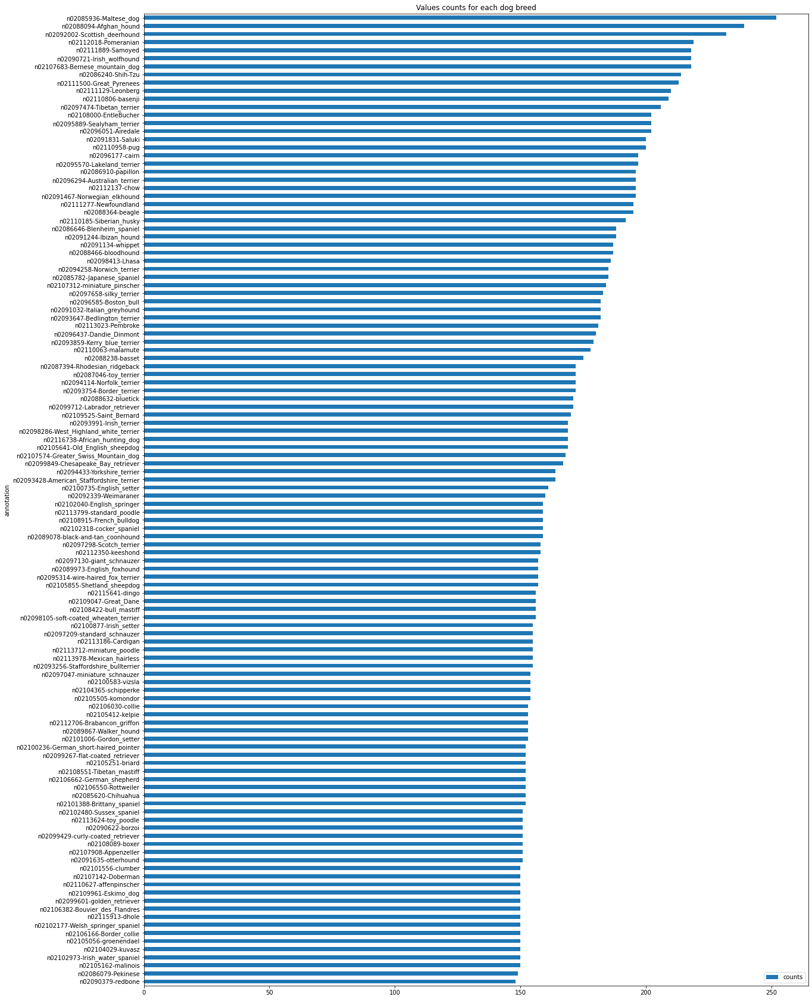

In [7]:

plt.rcParams["figure.figsize"] = (20,30)

ax = df.plot.barh(x='annotation', y='counts')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.title('Values counts for each dog breed')
plt.show()

In [10]:
#value counts per breed > the 10 most frequent breeds
x = df.groupby(['annotation']).size().sort_values()
df = x.reset_index()
df = df.rename(columns={0: "counts"})
df_tail = df.tail(10)
df_tail

,annotation,counts
110,n02111129-Leonberg,210
111,n02111500-Great_Pyrenees,213
112,n02086240-Shih-Tzu,214
113,n02107683-Bernese_mountain_dog,218
114,n02090721-Irish_wolfhound,218
115,n02111889-Samoyed,218
116,n02112018-Pomeranian,219
117,n02092002-Scottish_deerhound,232
118,n02088094-Afghan_hound,239
119,n02085936-Maltese_dog,252


## <font color="#337da4">Random Directories</font>

In [11]:
chihuahua_dir = './Images/n02085620-Chihuahua'
japanese_spaniel_dir = './Images/n02085782-Japanese_spaniel'
maltese_dir = './Images/n02085936-Maltese_dog'
pekinese_dir = './Images/n02086079-Pekinese'
shitzu_dir = './Images/n02086240-Shih-Tzu'
blenheim_spaniel_dir = './Images/n02086646-Blenheim_spaniel'
papillon_dir = './Images/n02086910-papillon'
toy_terrier_dir = './Images/n02087046-toy_terrier'
rhodesian_ridgeback_dir = './Images/n02087394-Rhodesian_ridgeback'
afghan_hound_dir = './Images/n02088094-Afghan_hound'
basset_dir = './Images/n02088238-basset'

100%|██████████| 175/175 [00:00<00:00, 440.91it/s]


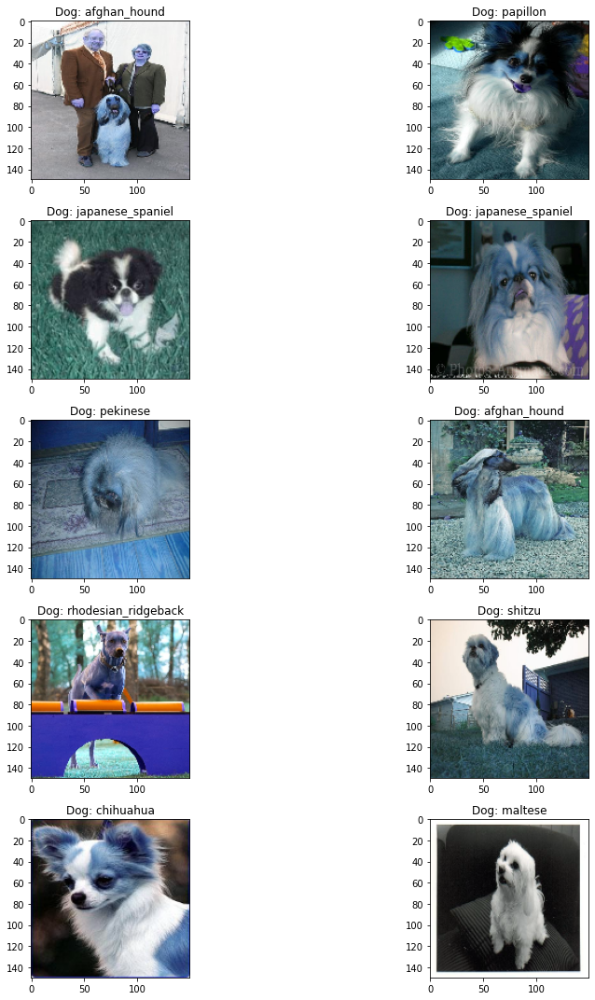

In [12]:
import random as rn
import os,shutil,math,scipy,cv2
from tqdm import tqdm
from PIL import Image, ImageOps
from keras.applications.vgg16 import preprocess_input

def label_assignment(img,label):
    return label

X_0 = [] 
Z_0 = []
imgsize = 150

def initial_data(label,data_dir):
    
        for img in tqdm(os.listdir(data_dir)):
            label = label_assignment(img,label)
            path = os.path.join(data_dir,img)
            img = cv2.imread(path,cv2.IMREAD_COLOR)
            
            #resize
            img = cv2.resize(img,(imgsize,imgsize))

            X_0.append(np.array(img))
            Z_0.append(str(label))
            
#11 classes
initial_data('chihuahua',chihuahua_dir)
initial_data('japanese_spaniel',japanese_spaniel_dir)
initial_data('maltese',maltese_dir)
initial_data('pekinese',pekinese_dir)
initial_data('shitzu',shitzu_dir)
initial_data('blenheim_spaniel',blenheim_spaniel_dir)
initial_data('papillon',papillon_dir)
initial_data('toy_terrier',toy_terrier_dir)
initial_data('rhodesian_ridgeback',rhodesian_ridgeback_dir)
initial_data('afghan_hound',afghan_hound_dir)
initial_data('basset',basset_dir)  

#-----------PLOT------------#
fig,ax=plt.subplots(5,2)
fig.set_size_inches(15,15)

for i in range(5):
    for j in range (2):
        l=rn.randint(0,len(Z_0))
        ax[i,j].imshow(X_0[l])
        ax[i,j].set_title('Dog: '+Z_0[l])
        
plt.tight_layout()

**Les images sont bleues donc on rajoute quelques retraitements:**

## <font color="#337da4">Preprocessing Images</font>

In [16]:
chihuahua_dir = './Images/n02085620-Chihuahua'
japanese_spaniel_dir = './Images/n02085782-Japanese_spaniel'
maltese_dir = './Images/n02085936-Maltese_dog'
pekinese_dir = './Images/n02086079-Pekinese'
shitzu_dir = './Images/n02086240-Shih-Tzu'
blenheim_spaniel_dir = './Images/n02086646-Blenheim_spaniel'
papillon_dir = './Images/n02086910-papillon'
toy_terrier_dir = './Images/n02087046-toy_terrier'
rhodesian_ridgeback_dir = './Images/n02087394-Rhodesian_ridgeback'
afghan_hound_dir = './Images/n02088094-Afghan_hound'
basset_dir = './Images/n02088238-basset'

100%|██████████| 175/175 [00:00<00:00, 435.43it/s]


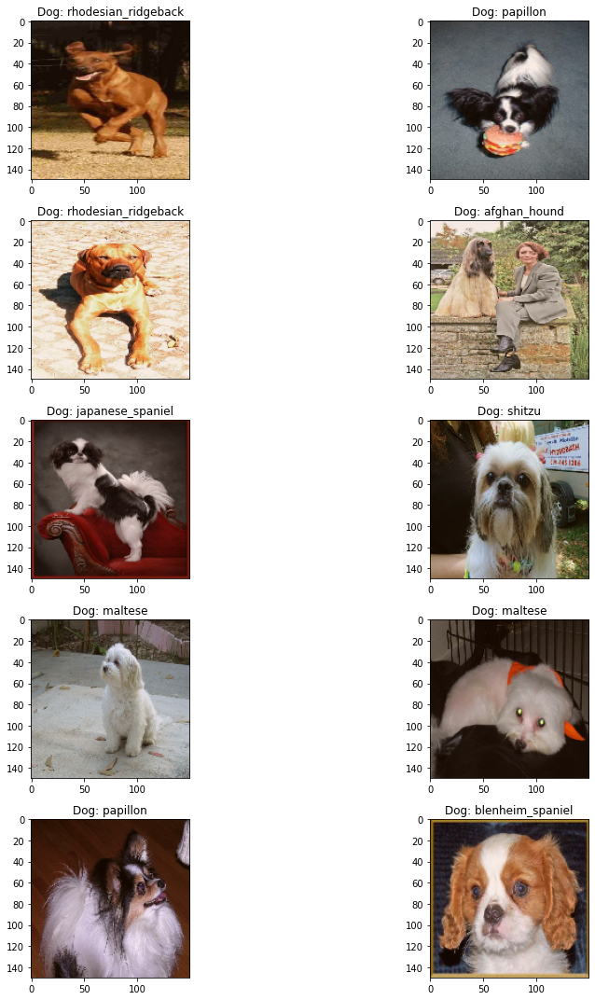

In [17]:



X = [] #(2094, 150, 150, 3)
Z = [] #2094
imgsize = 150

def label_assignment(img,label):
    return label

def training_data(label,data_dir):
    for img in tqdm(os.listdir(data_dir)):
        label = label_assignment(img,label)
        path = os.path.join(data_dir,img)
        img = cv2.imread(path,cv2.IMREAD_COLOR)
        
        #resize
        img = cv2.resize(img,(imgsize,imgsize))

        #remove the blue color
        img = preprocess_input(img) 
      
        #Equalization in size 250 for more light
        #cv2 normalize() helps us by changing the pixel intensity and increasing the overall contrast. 
        img = np.uint8(cv2.normalize(img, None, 0, 250, cv2.NORM_MINMAX))

        X.append(np.array(img))
        Z.append(str(label))

#11 classes
training_data('chihuahua',chihuahua_dir)
training_data('japanese_spaniel',japanese_spaniel_dir)
training_data('maltese',maltese_dir)
training_data('pekinese',pekinese_dir)
training_data('shitzu',shitzu_dir)
training_data('blenheim_spaniel',blenheim_spaniel_dir)
training_data('papillon',papillon_dir)
training_data('toy_terrier',toy_terrier_dir)
training_data('rhodesian_ridgeback',rhodesian_ridgeback_dir)
training_data('afghan_hound',afghan_hound_dir)
training_data('basset',basset_dir)

#-----------PLOT------------#
fig,ax=plt.subplots(5,2)
fig.set_size_inches(15,15)

for i in range(5):
    for j in range (2):
        l=rn.randint(0,len(Z))
        ax[i,j].imshow(X[l])
        ax[i,j].set_title('Dog: '+Z[l])
        
plt.tight_layout()

In [18]:
Z

['chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chihuahua',
 'chih

In [19]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from keras.utils.np_utils import to_categorical
from keras.preprocessing.image import ImageDataGenerator

#Encode Y 
label_encoder= LabelEncoder()
print(len(Z))
Y = label_encoder.fit_transform(Z)
print(Y)
Y = to_categorical(Y) #(2094, 11)
print("Y :",Y.shape)


#Normalizing the X data
X = np.array(X)
X=X/255
print("--------------")
print("X :",X.shape)


X_train,X_test,y_train,y_test = train_test_split(X,Y,test_size=0.3,random_state=69)
print("--------------")
print("X_train :",X_train.shape)
print("X_test :",X_test.shape)
print("y_train :",y_train.shape)
print("y_test :",y_test.shape)


augs_gen = ImageDataGenerator(
        featurewise_center=False,  
        samplewise_center=False, 
        featurewise_std_normalization=False,  
        samplewise_std_normalization=False,  
        zca_whitening=False,  
        rotation_range=10,  
        zoom_range = 0.1, 
        width_shift_range=0.2,  
        height_shift_range=0.2, 
        horizontal_flip=True,  
        vertical_flip=False) 

augs_gen.fit(X_train)

2094
[3 3 3 ... 1 1 1]
Y : (2094, 11)
--------------
X : (2094, 150, 150, 3)
--------------
X_train : (1465, 150, 150, 3)
X_test : (629, 150, 150, 3)
y_train : (1465, 11)
y_test : (629, 11)


In [20]:
print(label_encoder.classes_)

['afghan_hound' 'basset' 'blenheim_spaniel' 'chihuahua' 'japanese_spaniel'
 'maltese' 'papillon' 'pekinese' 'rhodesian_ridgeback' 'shitzu'
 'toy_terrier']


# <font color="#1d479b">Results Functions</font>

In [496]:
import json
from pylab import *
rcParams['figure.figsize'] = 15,5

class JsonEncoder(json.JSONEncoder):
    def default(self,obj):
        if isinstance(obj,np.integer):
            return(obj)
        elif isinstance(obj,np.floating):
            return float(obj)
        elif isinstance(obj,decimal.Decimal):
            return float(obj)
        elif isinstance(obj,np.ndarray):
            return obj.tolist()
        else:
            return super(JsonEncoder, self).default(obj)
        
        
        
        
def get_model_metrics():
    
    #Reading JSON from a File
    with open("./SaveModels/model_metrics.json") as json_file:
        model_metrics = json.load(json_file)
        
    return model_metrics


def save_model_metrics(model_name = "model_1", metrics ={}):
    if os.path.exists("./SaveModels/model_metrics.json") :
        
        #Reading JSON from a File
        with open("./SaveModels/model_metrics.json") as json_file:
            model_metrics = json.load(json_file)
    else:
        model_metrics = {}
        
    model_metrics[model_name] = metrics
    
    # Save the json
    with open("./SaveModels/model_metrics.json","w") as json_file:
        json_file.write(json.dumps(model_metrics, cls = JsonEncoder))
                
def save_model(path="./SaveModels", model_name = "model01"):
    filename = "./SaveModels"
    os.makedirs(os.path.dirname(filename), exist_ok = True)
    
    #save the entire model (structure + weights)
    model.save(os.path.join(path,model_name + ".hdf5"))
    
    #save only the weights
    model.save_weights(os.path.join(path, model_name + "h5"))
    
    #save the structure only
    model_json = model.to_json()
    with open(os.path.join(path, model_name + ".json"), "w") as json_file:
        json_file.write(model_json)

def get_model_size(path="./SaveModels", model_name = "model01"):
    model_size = os.stat(os.path.join(path, model_name + ".hdf5")).st_size
    return model_size  

#get_model_size, save_model, save_model_metrics, JsonEncoder
# called in the function below:
def evaluate_save_model (
    model,
    training_results,
    execution_time, 
    #10 hyperparameters
    learning_rate, 
    batch_size, 
    momentum,
    epochs, 
    optimizer, 
    kernel_initializer,
    activation,
    dropout_rate,
    weight_constraint,
    neurons
):

        
    #Get the model train history
    model_train_history = training_results.history #training_results = model.fit
    #Get the number of epochs the training was run for
    num_epochs = len(model_train_history["loss"])
    
    
    #Plot training results
    rcParams['figure.figsize'] = 15,5
    #fig = plt.figure(figsize(15,5))
    axs = fig.add_subplot(1,2,1)
    axs.set_title("Loss")
    
    # Plot all metrics
    for metric in ["loss", "val_loss"]:
        axs.plot(np.arange(0,num_epochs), 
                 model_train_history[metric], 
                 label =metric)
    axs.legend()
    
    axs = fig.add_subplot(1,2,2)
    axs.set_title("Accuracy")
    
    # Plot all metrics 
    for metric in ["accuracy", "val_accuracy"]:
        axs.plot(np.arange(0, num_epochs),model_train_history[metric], label=metric)
    axs.legend()
    
    plt.show()
    
    
    # Evaluate on test data 
    
    evaluation_results = model.evaluate(X_test,y_test)# X_test et y_test
    print("Evaluation results: [loss, accuracy]" , evaluation_results)
    
    
    if save:
    
        # Save model
    
        save_model(model_name=model.name) #model_name + ".json"
        model_size = get_model_size(model_name= model.name) #model_name + ".hdf5"
    
    
        # Save model history 
        with open (os.path.join("./SaveModels", model.name + "_train_history.json"),"w") as json_file:
            json_file.write(json.dumps(model_train_history,cls=JsonEncoder)) #"_train_history.json"
            
        trainable_parameters = model.count_params()
        
        # Save model metrics
        
        metrics ={
            "trainable_parameters": trainable_parameters,
            "execution_time": execution_time,
            "loss": evaluation_results[0],
            "accuracy": evaluation_results[1],
            "model_size": model_size,
            #10 hyperparameters
            "learning_rate": learning_rate,
            "batch_size": batch_size,
            "momentum": momentum,
            "epochs": epochs,
            "optimizer": type(optimizer).__name__,
            "kernel_initializer": kernel_initializer,
            "activation": activation,
           "dropout_rate": dropout_rate,
           "weight_constraint": weight_constraint,
           "neurons": neurons
            }
            
        save_model_metrics(model_name = model.name, metrics = metrics)
         



# <font color="#1d479b">Modelisation</font>

## <font color="#337da4">VGG16 Only</font>

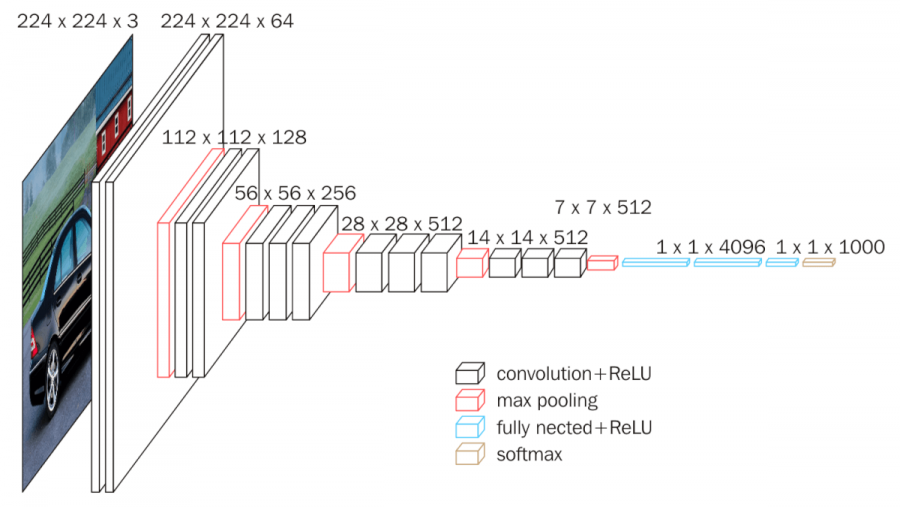

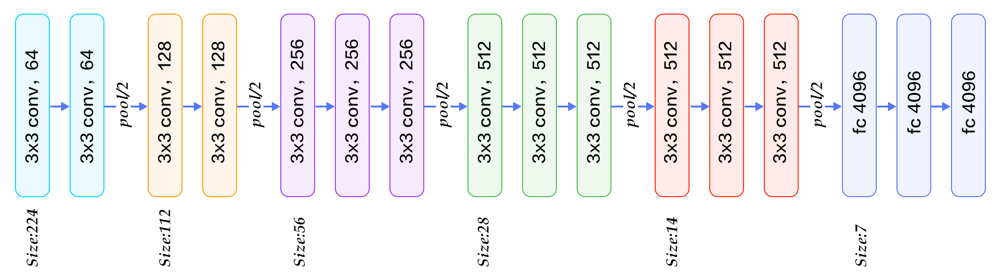

Largeur : 224 px, hauteur : 224 px


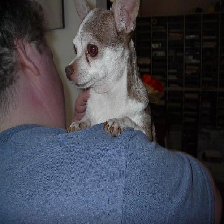

In [367]:
from os import listdir
from keras.preprocessing.image import load_img, img_to_array

#take a random img in the dataset
path = "./Images/n02085620-Chihuahua/"
list_photos = [file for file in listdir(path)]

# Resize
image = load_img(path+list_photos[5], target_size=(224, 224))

w, h = image.size
print("Largeur : {} px, hauteur : {} px".format(w, h))
image

In [369]:
from keras.applications.vgg16 import decode_predictions
from keras.preprocessing.image import img_to_array
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input

#take a random img in the dataset
path = "./Images/n02085936-Maltese_dog/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[5], target_size=(224, 224))
# Resize
resize=image.resize((150, 150))
w, h = resize.size
print("Largeur : {} px, hauteur : {} px".format(w, h))

img = img_to_array(image)
# reshape the input format 
img = img.reshape((1, img.shape[0], img.shape[1], img.shape[2]))
# prepare the image for the VGG model
img = preprocess_input(img)


model = VGG16()
yhat = model.predict(img)
label = decode_predictions(yhat)

# retrieve the most likely result, e.g. highest probability
label = label[0][0]
# print the classification
print('%s (%.2f%%)' % (label[1], label[2]*100))

Largeur : 150 px, hauteur : 150 px
Maltese_dog (82.41%)


In [370]:
print ('%s (%.2f%%)' % decode_predictions ((yhat*100), top=3)[0][0][1:3])
print ('%s (%.2f%%)' % decode_predictions ((yhat*100), top=3)[0][1][1:3])
print ('%s (%.2f%%)' % decode_predictions ((yhat*100), top=3)[0][2][1:3])

Maltese_dog (82.41%)
toy_poodle (3.39%)
Lhasa (3.38%)


## <font color="#337da4">VGG16 </font>

<keras.engine.input_layer.InputLayer object at 0x7f0d41e1bd30> False
<keras.layers.convolutional.Conv2D object at 0x7f0d3ff30ee0> False
<keras.layers.convolutional.Conv2D object at 0x7f0d49f84790> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0d3ff2fb20> False
<keras.layers.convolutional.Conv2D object at 0x7f0d4a56d3d0> False
<keras.layers.convolutional.Conv2D object at 0x7f0d4b2273d0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0d3ff2fc40> False
<keras.layers.convolutional.Conv2D object at 0x7f0d4b22cd30> False
<keras.layers.convolutional.Conv2D object at 0x7f0d4b2227c0> False
<keras.layers.convolutional.Conv2D object at 0x7f0d4b21c9d0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0d4b22c310> False
<keras.layers.convolutional.Conv2D object at 0x7f0d4b222640> False
<keras.layers.convolutional.Conv2D object at 0x7f0d4b21a730> False
<keras.layers.convolutional.Conv2D object at 0x7f0d4b21beb0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0d4ad4a8e0>

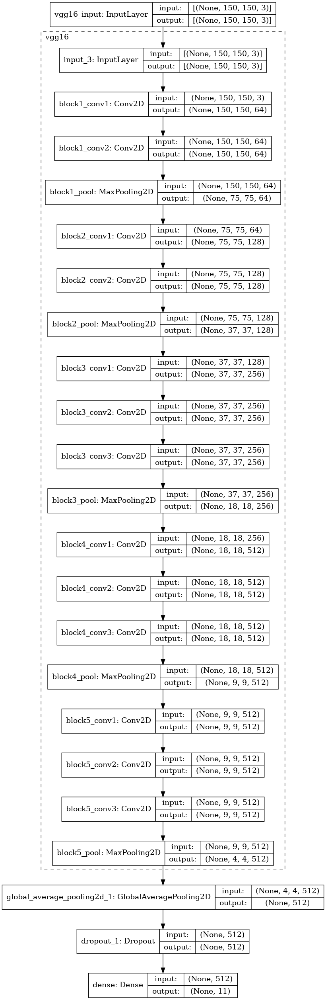

In [35]:
from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import VGG16

from keras.models import Sequential
from keras.layers import Dense,Flatten,Dropout,Concatenate,GlobalAveragePooling2D,Lambda,ZeroPadding2D
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
from keras.utils.vis_utils import plot_model
import keras.utils.vis_utils
from importlib import reload
reload(keras.utils.vis_utils)
from tensorflow.keras.constraints import max_norm

imgsize = 150 

# Load VGG-16 pre-trained on ImageNet and without fully-connected layers
base_model = VGG16(include_top=False,
                   # precise image dimensions 
                  input_shape = (imgsize,imgsize,3),
                  weights = 'imagenet')

for layer in base_model.layers:
    layer.trainable = False
    
for layer in base_model.layers:
    print(layer,layer.trainable)


#default initializer - Initializer for the kernel weights matrix. 
Kernel_initializer = "glorot_uniform"
activation = "softmax"
dropout_rate = 0.5
weight_constraint = 3
neurons = 11

model = Sequential()
model.add(base_model)
model.add(GlobalAveragePooling2D())  
model.add(Dropout(dropout_rate)) 
model.add(Dense(neurons,kernel_initializer = Kernel_initializer, activation=activation, 
                kernel_constraint=max_norm(weight_constraint)))
model.summary()



#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

### <font color="#337da4"> `SGD(lr=1e-2)` </font>

In [33]:
# #to verify keys 

# checkpoint_callback = ModelCheckpoint('./base.model', 
#                                       monitor='val_accuracy', 
#                                       verbose=2, 
#                                       save_best_only=True, 
#                                       save_weights_only=False, 
#                                       mode='max' )

# hist = model.fit_generator(
#     augs_gen.flow(X_train,y_train,batch_size=32),
#     validation_data  = (X_test,y_test),
#     validation_steps = len(X_test)//batch_size,
#     steps_per_epoch  = len(X_train)//batch_size,
#     epochs = 1, 
#     verbose = 1,
#     callbacks=checkpoint_callback
# )
# for key in hist.history:
#     print(key)

37/37 [==============================] - 50s 1s/step - loss: 2.4241 - accuracy: 0.1062 - val_loss: 2.3437 - val_accuracy: 0.1558

Epoch 00001: val_accuracy improved from -inf to 0.15580, saving model to ./base.model
INFO:tensorflow:Assets written to: ./base.model/assets
loss
accuracy
val_loss
val_accuracy


In [37]:
from keras.optimizers import adam_v2
from tensorflow.keras.optimizers import SGD
from keras.callbacks import ModelCheckpoint
import time



#----------Hyper Parameters-------#

# 3 Optimizer hyper-parameters 
learning_rate=1e-2
momentum = 0.99

opt = SGD(learning_rate=learning_rate,momentum=momentum)
opt1 = adam_v2.Adam(learning_rate=1e-2)
optimizer=opt


#----------Compile---------------#


model.compile(
    loss='categorical_crossentropy',
    optimizer=optimizer,
    metrics=['accuracy']
)


#-----------Training------------#


checkpoint_callback = ModelCheckpoint('./Checkpoints/checkpoint_VGG16_SGD', 
                                      monitor='val_accuracy', 
                                      verbose=2, 
                                      save_best_only=True, 
                                      save_weights_only=True, 
                                      mode='max' )
start_time= time.time()

# 2 Train hyper-parameters
batch_size=39
epochs = 10

history = model.fit_generator(
    augs_gen.flow(X_train,y_train,batch_size=39),
    validation_data  = (X_test,y_test),
    validation_steps = len(X_test)//batch_size,
    steps_per_epoch  = len(X_train)//batch_size,
    epochs = epochs, 
    verbose = 1,
    callbacks=checkpoint_callback)

execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time)

Epoch 1/10
37/37 [==============================] - 59s 2s/step - loss: 3.2253 - accuracy: 0.2651 - val_loss: 2.3581 - val_accuracy: 0.2846

Epoch 00001: val_accuracy improved from -inf to 0.28458, saving model to ./Checkpoints/checkpoint_VGG16_SGD
Epoch 2/10
37/37 [==============================] - 61s 2s/step - loss: 3.1355 - accuracy: 0.2651 - val_loss: 2.8680 - val_accuracy: 0.2194

Epoch 00002: val_accuracy did not improve from 0.28458
Epoch 3/10
37/37 [==============================] - 61s 2s/step - loss: 3.1639 - accuracy: 0.2447 - val_loss: 2.0357 - val_accuracy: 0.4118

Epoch 00003: val_accuracy improved from 0.28458 to 0.41176, saving model to ./Checkpoints/checkpoint_VGG16_SGD
Epoch 4/10
37/37 [==============================] - 61s 2s/step - loss: 3.0624 - accuracy: 0.2700 - val_loss: 2.6314 - val_accuracy: 0.3100

Epoch 00004: val_accuracy did not improve from 0.41176
Epoch 5/10
37/37 [==============================] - 62s 2s/step - loss: 3.1808 - accuracy: 0.2840 - val_los

In [38]:
def show_final_history(history):
    fig, ax = plt.subplots(1, 2, figsize=(15,5))
    ax[0].set_title('loss')
    ax[0].plot(history.epoch, history.history["loss"], label="Train loss")
    ax[0].plot(history.epoch, history.history["val_loss"], label="Validation loss")
    ax[1].set_title('acc')
    ax[1].plot(history.epoch, history.history["accuracy"], label="Train acc")
    ax[1].plot(history.epoch, history.history["val_accuracy"], label="Validation acc")
    ax[0].legend()
    ax[1].legend()

20/20 [==============================] - 16s 814ms/step - loss: 2.0357 - accuracy: 0.4118
Model Test Loss: 2.035714626312256
Model Test Accuracy: 0.4117647111415863
Weights Saved


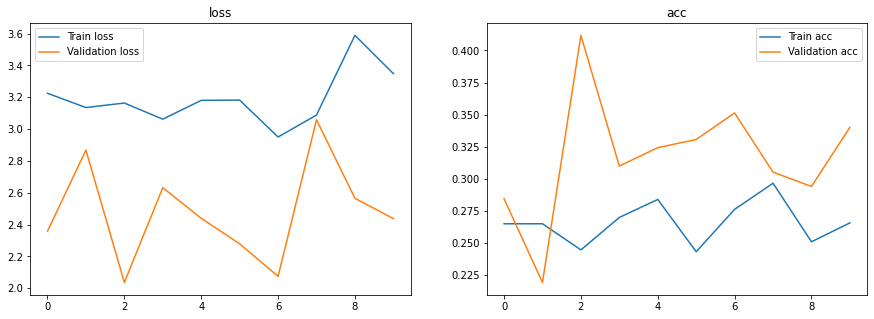

In [39]:
show_final_history(history)

#model.save_weights('./Checkpoints/checkpoint_VGG16_SGD')
model.load_weights('./Checkpoints/checkpoint_VGG16_SGD')

model_score = model.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])

# Save in the New directory weights .h5
model.save("./Weights/weight_VGG16_SGD.h5")
print("Weights Saved")  

**Ci-dessus les résultats avec SGD Optimizer.**

In [40]:
# Save in the Nez directory 3 .json files and .hdf5 file
evaluate_save_model (model,
                     history,
                     execution_time, 
                     learning_rate, 
                     batch_size, 
                     momentum,
                     epochs, 
                     optimizer,
                     Kernel_initializer,
                    activation,
                    dropout_rate,
                    weight_constraint,
                    neurons)

20/20 [==============================] - 16s 793ms/step - loss: 2.0357 - accuracy: 0.4118
Evaluation results: [loss, accuracy] [2.035714626312256, 0.4117647111415863]


### <font color="#337da4"> `adam_v2.Adam(lr=1e-2)` </font>

<keras.engine.input_layer.InputLayer object at 0x7f0e59063160> False
<keras.layers.convolutional.Conv2D object at 0x7f0e59062310> False
<keras.layers.convolutional.Conv2D object at 0x7f0e591e8c70> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0d4a2ede50> False
<keras.layers.convolutional.Conv2D object at 0x7f0e590340d0> False
<keras.layers.convolutional.Conv2D object at 0x7f0d4a2ede20> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0e5919d940> False
<keras.layers.convolutional.Conv2D object at 0x7f0e58ff6700> False
<keras.layers.convolutional.Conv2D object at 0x7f0e58ff6a30> False
<keras.layers.convolutional.Conv2D object at 0x7f0e58ff67c0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0e5902e2e0> False
<keras.layers.convolutional.Conv2D object at 0x7f0e5908fbe0> False
<keras.layers.convolutional.Conv2D object at 0x7f0e58ffc6a0> False
<keras.layers.convolutional.Conv2D object at 0x7f0e5908fe20> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0e58ffcca0>

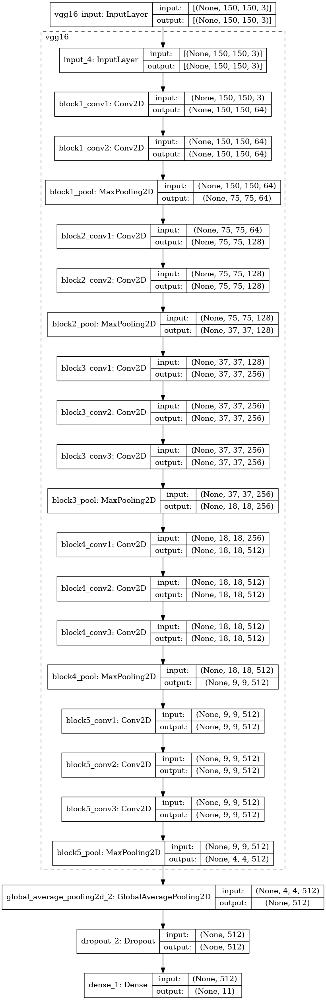

In [43]:
imgsize = 150 

# Load VGG-16 pre-trained on ImageNet and without fully-connected layers
base_model = VGG16(include_top=False,
                   # precise image dimensions 
                  input_shape = (imgsize,imgsize,3),
                  weights = 'imagenet')

for layer in base_model.layers:
    layer.trainable = False
    
for layer in base_model.layers:
    print(layer,layer.trainable)


#default initializer - Initializer for the kernel weights matrix. 
Kernel_initializer = "glorot_uniform"
activation = "softmax"
dropout_rate = 0.5
weight_constraint = 3
neurons = 11

model = Sequential()
model.add(base_model)
model.add(GlobalAveragePooling2D())
model.add(Dropout(dropout_rate))
# After COnv2d activation = 
model.add(Dense(neurons,kernel_initializer = Kernel_initializer, activation=activation, 
                kernel_constraint=max_norm(weight_constraint)))
model.summary()



#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

In [45]:
from keras.optimizers import adam_v2
from tensorflow.keras.optimizers import SGD
from keras.callbacks import ModelCheckpoint


#----------Compile---------------#

# 3 Hyper-parameters
learning_rate=1e-2
momentum = None

#opt = SGD(learning_rate=learning_rate,momentum=momentum)
opt1 = adam_v2.Adam(learning_rate=learning_rate)
optimizer=opt1 

model.compile(
    loss='categorical_crossentropy',
    optimizer=optimizer,
    metrics=['accuracy']
)


#-----------Training------------#


checkpoint_callback = ModelCheckpoint('./Checkpoints/checkpoint_VGG16_ADAM.1', 
                                      monitor='val_accuracy', 
                                      verbose=2, 
                                      save_best_only=True, 
                                      save_weights_only=True, 
                                      mode='max' )
start_time= time.time()

# 2 Train hyper-parameters
batch_size=39
epochs = 10

history = model.fit_generator(
    augs_gen.flow(X_train,y_train,batch_size=39),
    validation_data  = (X_test,y_test),
    validation_steps = len(X_test)//batch_size,
    steps_per_epoch  = len(X_train)//batch_size,
    epochs = epochs, 
    verbose = 1,
    callbacks=checkpoint_callback)

execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time)

/home/catherinele/.local/lib/python3.9/site-packages/keras/engine/training.py:1972: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/10
37/37 [==============================] - 58s 2s/step - loss: 2.3341 - accuracy: 0.2020 - val_loss: 1.8964 - val_accuracy: 0.3990

Epoch 00001: val_accuracy improved from -inf to 0.39905, saving model to ./Checkpoints/checkpoint_VGG16_ADAM.1
Epoch 2/10
37/37 [==============================] - 62s 2s/step - loss: 1.9746 - accuracy: 0.3240 - val_loss: 1.6961 - val_accuracy: 0.4579

Epoch 00002: val_accuracy improved from 0.39905 to 0.45787, saving model to ./Checkpoints/checkpoint_VGG16_ADAM.1
Epoch 3/10
37/37 [==============================] - 62s 2s/step - loss: 1.8195 - accuracy: 0.3668 - val_loss: 1.6490 - val_accuracy: 0.5024

Epoch 00003: val_accuracy improved from 0.45787 to 0.50238, saving model to ./Checkpoints/checkpoint_VGG16_ADAM.1
Epoch 4/10
37/37 [==============================] - 62s 2s/step - loss: 1.7988 - accuracy: 0.3969 - val_loss: 1.6800 - val_accuracy: 0.4483

Epoch 00004: val_accuracy did not improve from 0.50238
Epoch 5/10
37/37 [========================

20/20 [==============================] - 16s 797ms/step - loss: 1.5775 - accuracy: 0.5739
Model Test Loss: 1.5775316953659058
Model Test Accuracy: 0.5739268660545349
Weights Saved


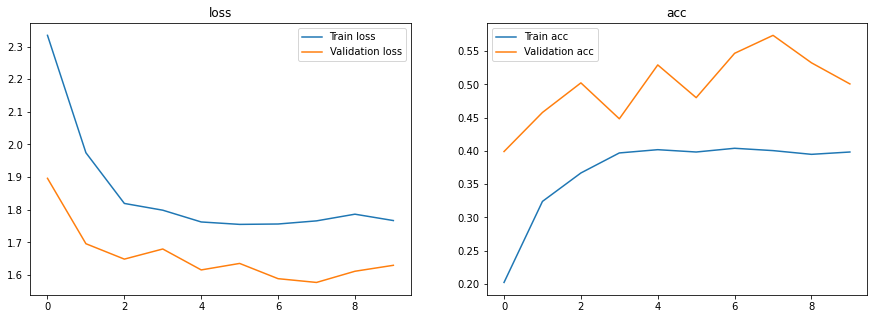

In [47]:
show_final_history(history)


model.load_weights('./Checkpoints/checkpoint_VGG16_ADAM.1')

model_score = model.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
model.save("./Weights/weight_VGG16_ADAM.1.h5")
print("Weights Saved") 

In [48]:
evaluate_save_model (model,
                     history,
                     execution_time, 
                     learning_rate, 
                     batch_size, 
                     momentum,
                     epochs, 
                     optimizer,
                     Kernel_initializer,
                    activation,
                    dropout_rate,
                    weight_constraint,
                    neurons)

20/20 [==============================] - 16s 786ms/step - loss: 1.5775 - accuracy: 0.5739
Evaluation results: [loss, accuracy] [1.5775316953659058, 0.5739268660545349]


## <font color="#337da4">VGG16</font>

### Prepare Croped Images

#### For 120 folders

In [47]:
#crop images

import numpy as np # linear algebra
import xml.etree.ElementTree as ET # for parsing XML
import matplotlib.pyplot as plt # to show images
from PIL import Image # to read images
import os
import glob

# list of 120 directories names
dir_names = []
data_dir = "./Images"

for directory in tqdm(os.listdir(data_dir)):
    
    dir_name= "{}".format(directory)
    dir_names.append(dir_name)
    
#--------------------------------#    

# Make the 120 folders 
for dir_name in dir_names :
    os.mkdir("./Images_cropped/{}".format(dir_name))
    
#--------------------------------# 
list_dir_ok = []
for dir_name in dir_names :
    print(dir_name)
    list_dir_ok.append(dir_name)
    
    


    root_images="./Images/{}".format(dir_name)
    root_annots="./annotation/Annotation/{}".format(dir_name)
    
    
    
    
    
    all_images=os.listdir("./Images/{}/".format(dir_name))
    print(f"Total images : {len(all_images)}")
    
    breeds = glob.glob("./annotation/Annotation/{}/".format(dir_name))
    annotation=[]
    
    for b in breeds:
        annotation+=glob.glob(b+"/*")
    print(f"Total annotation : {len(annotation)}")
    
    breed_map={}
    for annot in annotation:
        breed=annot.split("/")[-2]
        index=breed.split("-")[0]
        breed_map.setdefault(index,breed)
        
    print(f"Total Breeds : {len(breed_map)}")
    
    def bounding_box(image):
        #bpath=root_annots+str(breed_map[image.split("_")[0]])+"/"+str(image.split(".")[0])
        #print (bpath)
        #print(root_annots)
        #print (str(breed_map[image.split("_")[0]]))
        #print (str(image.split(".")[0]))
        bpath=root_annots+"/"+str(image.split(".")[0])
        tree = ET.parse(bpath)
        root = tree.getroot()
        objects = root.findall('object')
        
        for o in objects:
            bndbox = o.find('bndbox') # reading bound box
            xmin = int(bndbox.find('xmin').text)
            ymin = int(bndbox.find('ymin').text)
            xmax = int(bndbox.find('xmax').text)
            ymax = int(bndbox.find('ymax').text)
            
            
        return (xmin,ymin,xmax,ymax)
        
    plt.figure(figsize=(10,10))
    bbox=[]
    for i,image in enumerate(all_images):
        bbox=bounding_box(image) 
        #print(bbox)  
        im=Image.open(os.path.join(root_images,image))
        im=im.crop(bbox)  
        im = im.convert('RGB')
        im.save('./Images_cropped/{}/{}'.format(dir_name,image)) 
    print(len(list_dir_ok))

100%|██████████| 120/120 [00:00<00:00, 1204106.41it/s]


n02101556-clumber
Total images : 150
Total annotation : 150
Total Breeds : 1
1
n02105412-kelpie
Total images : 153
Total annotation : 153
Total Breeds : 1
2
n02105641-Old_English_sheepdog
Total images : 169
Total annotation : 169
Total Breeds : 1
3
n02113712-miniature_poodle
Total images : 155
Total annotation : 155
Total Breeds : 1
4
n02110627-affenpinscher
Total images : 150
Total annotation : 150
Total Breeds : 1
5
n02109047-Great_Dane
Total images : 156
Total annotation : 156
Total Breeds : 1
6
n02105056-groenendael
Total images : 150
Total annotation : 150
Total Breeds : 1
7
n02094433-Yorkshire_terrier
Total images : 164
Total annotation : 164
Total Breeds : 1
8
n02109525-Saint_Bernard
Total images : 170
Total annotation : 170
Total Breeds : 1
9
n02113978-Mexican_hairless
Total images : 155
Total annotation : 155
Total Breeds : 1
10
n02106030-collie
Total images : 153
Total annotation : 153
Total Breeds : 1
11
n02110958-pug
Total images : 200
Total annotation : 200
Total Breeds : 

<ipython-input-47-91a1f1b55c61>:80: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,10))


21
n02085936-Maltese_dog
Total images : 252
Total annotation : 252
Total Breeds : 1
22
n02086079-Pekinese
Total images : 149
Total annotation : 149
Total Breeds : 1
23
n02086240-Shih-Tzu
Total images : 214
Total annotation : 214
Total Breeds : 1
24
n02110185-Siberian_husky
Total images : 192
Total annotation : 192
Total Breeds : 1
25
n02087046-toy_terrier
Total images : 172
Total annotation : 172
Total Breeds : 1
26
n02093428-American_Staffordshire_terrier
Total images : 164
Total annotation : 164
Total Breeds : 1
27
n02102177-Welsh_springer_spaniel
Total images : 150
Total annotation : 150
Total Breeds : 1
28
n02096177-cairn
Total images : 197
Total annotation : 197
Total Breeds : 1
29
n02098286-West_Highland_white_terrier
Total images : 169
Total annotation : 169
Total Breeds : 1
30
n02088238-basset
Total images : 175
Total annotation : 175
Total Breeds : 1
31
n02091635-otterhound
Total images : 151
Total annotation : 151
Total Breeds : 1
32
n02092002-Scottish_deerhound
Total images 

116
n02102318-cocker_spaniel
Total images : 159
Total annotation : 159
Total Breeds : 1
117
n02101006-Gordon_setter
Total images : 153
Total annotation : 153
Total Breeds : 1
118
n02092339-Weimaraner
Total images : 160
Total annotation : 160
Total Breeds : 1
119
n02111129-Leonberg
Total images : 210
Total annotation : 210
Total Breeds : 1
120


<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

#### For 10 folders

In [264]:
#crop images

import numpy as np # linear algebra
import xml.etree.ElementTree as ET # for parsing XML
import matplotlib.pyplot as plt # to show images
from PIL import Image # to read images
import os
import glob

# for dossier in Images:

root_images="./Images/n02085936-Maltese_dog"
root_annots="./annotation/Annotation/n02085936-Maltese_dog"

all_images=os.listdir("./Images/n02085936-Maltese_dog/")
print(f"Total images : {len(all_images)}")

breeds = glob.glob("./annotation/Annotation/n02085936-Maltese_dog/")
annotation=[]

for b in breeds:
    annotation+=glob.glob(b+"/*")
print(f"Total annotation : {len(annotation)}")

breed_map={}
for annot in annotation:
    breed=annot.split("/")[-2]
    index=breed.split("-")[0]
    breed_map.setdefault(index,breed)
    
print(f"Total Breeds : {len(breed_map)}")

def bounding_box(image):
    #bpath=root_annots+str(breed_map[image.split("_")[0]])+"/"+str(image.split(".")[0])
    #print (bpath)
    #print(root_annots)
    #print (str(breed_map[image.split("_")[0]]))
    #print (str(image.split(".")[0]))
    bpath=root_annots+"/"+str(image.split(".")[0])
    tree = ET.parse(bpath)
    root = tree.getroot()
    objects = root.findall('object')
    
    for o in objects:
        bndbox = o.find('bndbox') # reading bound box
        xmin = int(bndbox.find('xmin').text)
        ymin = int(bndbox.find('ymin').text)
        xmax = int(bndbox.find('xmax').text)
        ymax = int(bndbox.find('ymax').text)
        
        
    return (xmin,ymin,xmax,ymax)
    
plt.figure(figsize=(10,10))
bbox=[]
for i,image in enumerate(all_images):
    bbox=bounding_box(image) 
    print(bbox)  
    im=Image.open(os.path.join(root_images,image))
    im=im.crop(bbox)           
    im.save('./results_Maltese/{}.'.format(i,im)) 

Total images : 252
Total annotation : 252
Total Breeds : 1
(0, 91, 473, 323)
(107, 39, 404, 332)
(234, 127, 384, 366)
(2, 48, 418, 293)
(85, 77, 337, 496)
(6, 31, 423, 498)
(23, 84, 184, 275)
(113, 33, 498, 351)
(123, 170, 351, 400)
(82, 0, 374, 287)
(156, 161, 283, 421)
(41, 9, 329, 371)
(40, 33, 433, 496)
(86, 54, 251, 224)
(0, 28, 383, 374)
(36, 95, 307, 398)
(14, 8, 498, 406)
(219, 67, 370, 278)
(133, 18, 419, 308)
(0, 111, 324, 498)
(173, 2, 430, 374)
(148, 13, 402, 336)
(131, 17, 427, 348)
(209, 0, 399, 298)
(0, 1, 373, 497)
(0, 53, 499, 374)
(70, 142, 328, 406)
(70, 31, 499, 308)
(77, 32, 290, 498)
(267, 107, 472, 373)
(140, 0, 375, 283)
(21, 2, 374, 321)
(149, 85, 307, 341)
(106, 51, 382, 332)
(0, 92, 203, 374)
(216, 212, 346, 353)
(129, 168, 417, 374)
(8, 52, 492, 391)
(11, 61, 385, 317)
(145, 0, 458, 374)
(108, 92, 310, 374)
(37, 0, 490, 430)
(203, 59, 461, 332)
(10, 61, 335, 455)
(42, 59, 168, 204)
(84, 54, 409, 314)
(129, 5, 422, 373)
(170, 90, 364, 339)
(16, 57, 362, 442)


<Figure size 1000x1000 with 0 Axes>

### Chosen Directories

#### For 10 Classes

In [202]:
#value counts per breed > the 10 most frequent breeds
x = df.groupby(['annotation']).size().sort_values()
df = x.reset_index()
df = df.rename(columns={0: "counts"})
df_tail = df.tail(10)
df_tail

,annotation,counts
110,n02111129-Leonberg,210
111,n02111500-Great_Pyrenees,213
112,n02086240-Shih-Tzu,214
113,n02107683-Bernese_mountain_dog,218
114,n02090721-Irish_wolfhound,218
115,n02111889-Samoyed,218
116,n02112018-Pomeranian,219
117,n02092002-Scottish_deerhound,232
118,n02088094-Afghan_hound,239
119,n02085936-Maltese_dog,252


(array([  0.,  50., 100., 150., 200., 250., 300.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

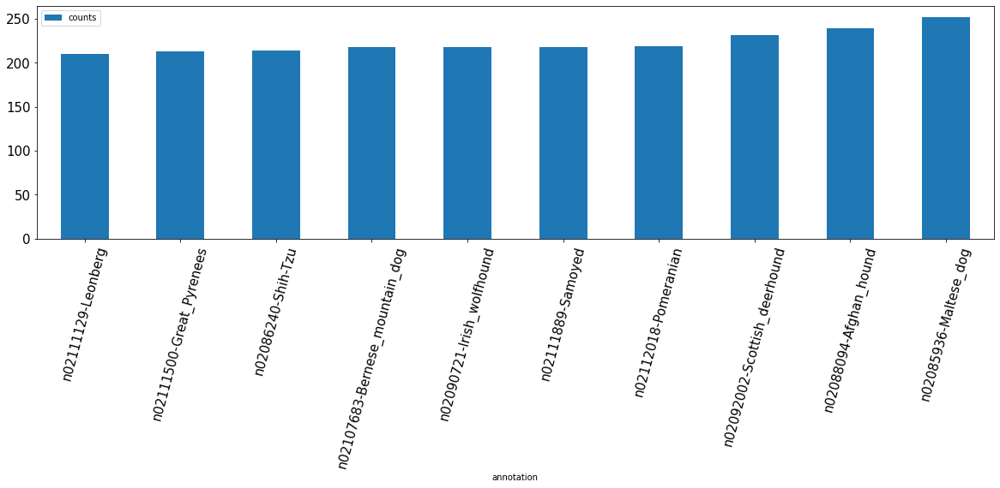

In [203]:
plt.rcParams["figure.figsize"] = (20,5)
df_tail.plot(x= 'annotation', kind='bar')

plt.xticks(fontsize=15, rotation =75)
plt.yticks(fontsize=15)

In [204]:
df_tail

,annotation,counts
110,n02111129-Leonberg,210
111,n02111500-Great_Pyrenees,213
112,n02086240-Shih-Tzu,214
113,n02107683-Bernese_mountain_dog,218
114,n02090721-Irish_wolfhound,218
115,n02111889-Samoyed,218
116,n02112018-Pomeranian,219
117,n02092002-Scottish_deerhound,232
118,n02088094-Afghan_hound,239
119,n02085936-Maltese_dog,252


In [442]:
leonberg_dir = './Images_results/results_Leonberg'
great_pyrenees_dir = './Images_results/results_Great_Pyrenees'
shih_tzu_dir = './Images_results/results_Shih-Tzu'
bernese_mountain_dir = './Images_results/results_Bernese_mountain'
irish_wolfhound_dir = './Images_results/results_Irish_wolfhound'
samoyed_dir = './Images_results/results_Samoyed'
pomeranian_dir = './Images_results/results_Pomeranian'
scottish_deerhound_dir = './Images_results/results_Scottish_deerhound'
afghan_hound_dir = './Images_results/results_Afghan_hound'
maltese_dir = './Images_results/results_Maltese'

100%|██████████| 214/214 [00:00<00:00, 790.18it/s]


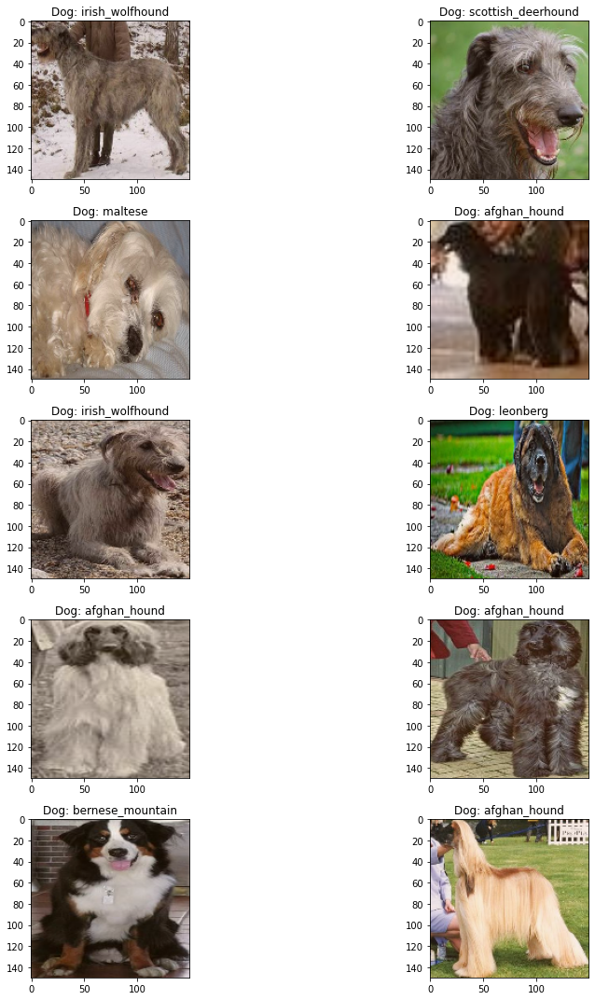

In [443]:
from PIL import Image, ImageOps
import random as rn
import os,shutil,math,scipy,cv2
from tqdm import tqdm
from keras.applications.vgg16 import preprocess_input


X = [] #(2094, 150, 150, 3)
Z = [] #2094
imgsize = 150

def label_assignment(img,label):
    return label

def training_data(label,data_dir):
    for img in tqdm(os.listdir(data_dir)):
        label = label_assignment(img,label)
        
        path = os.path.join(data_dir,img)
        img = cv2.imread(path,cv2.IMREAD_COLOR)
        
        #resize
        img = cv2.resize(img,(imgsize,imgsize))

        #remove the blue color
        img = preprocess_input(img) 
      
        #Equalization in size 250 for more light
        img = np.uint8(cv2.normalize(img, None, 0, 250, cv2.NORM_MINMAX))

        X.append(np.array(img))
        Z.append(str(label))

#10 classes
training_data('afghan_hound',afghan_hound_dir)
training_data('bernese_mountain',bernese_mountain_dir)
training_data('great_pyrenees',great_pyrenees_dir)
training_data('irish_wolfhound',irish_wolfhound_dir)
training_data('leonberg',leonberg_dir)
training_data('maltese',maltese_dir)
training_data('pomeranian',pomeranian_dir)
training_data('samoyed',samoyed_dir)
training_data('scottish_deerhound',scottish_deerhound_dir)
training_data('shih_tzu',shih_tzu_dir)


#-----------PLOT------------#
fig,ax=plt.subplots(5,2)
fig.set_size_inches(15,15)

for i in range(5):
    for j in range (2):
        l=rn.randint(0,len(Z))
        ax[i,j].imshow(X[l])
        ax[i,j].set_title('Dog: '+Z[l])
        
plt.tight_layout()

#### For 120 Classes

  0%|          | 0/120 [00:00<?, ?it/s]

n02101556-clumber



  1%|          | 1/120 [00:00<00:22,  5.23it/s]

n02105412-kelpie



  2%|▏         | 2/120 [00:00<00:23,  5.13it/s]

n02105641-Old_English_sheepdog



  2%|▎         | 3/120 [00:00<00:24,  4.75it/s]

n02113712-miniature_poodle



  3%|▎         | 4/120 [00:00<00:23,  4.84it/s]

n02110627-affenpinscher



  4%|▍         | 5/120 [00:00<00:22,  5.10it/s]

n02109047-Great_Dane



  5%|▌         | 6/120 [00:01<00:26,  4.23it/s]

n02105056-groenendael



  6%|▌         | 7/120 [00:01<00:25,  4.49it/s]

n02094433-Yorkshire_terrier



  7%|▋         | 8/120 [00:01<00:25,  4.39it/s]

n02109525-Saint_Bernard



  8%|▊         | 9/120 [00:02<00:27,  4.10it/s]

n02113978-Mexican_hairless



  8%|▊         | 10/120 [00:02<00:25,  4.31it/s]

n02106030-collie



  9%|▉         | 11/120 [00:02<00:24,  4.44it/s]

n02110958-pug



 10%|█         | 12/120 [00:02<00:24,  4.35it/s]

n02094114-Norfolk_terrier



 11%|█         | 13/120 [00:02<00:23,  4.47it/s]

n02099429-curly_coated_retriever



 12%|█▏        | 14/120 [00:03<00:22,  4.75it/s]

n02097658-silky_terrier



 12%|█▎        | 15/120 [00:03<00:23,  4.47it/s]

n02113799-standard_poodle



 13%|█▎        | 16/120 [00:03<00:23,  4.46it/s]

n02110806-basenji



 14%|█▍        | 17/120 [00:03<00:24,  4.20it/s]

n02112706-Brabancon_griffon



 15%|█▌        | 18/120 [00:04<00:22,  4.47it/s]

n02111500-Great_Pyrenees



 16%|█▌        | 19/120 [00:04<00:22,  4.45it/s]

n02100877-Irish_setter



 17%|█▋        | 20/120 [00:04<00:21,  4.59it/s]

n02116738-African_hunting_dog



 18%|█▊        | 21/120 [00:04<00:21,  4.67it/s]

n02105251-briard



 18%|█▊        | 22/120 [00:04<00:21,  4.65it/s]

n02085936-Maltese_dog



 19%|█▉        | 23/120 [00:05<00:23,  4.10it/s]

n02086079-Pekinese



 20%|██        | 24/120 [00:05<00:21,  4.45it/s]

n02098105-soft_coated_wheaten_terrier



 21%|██        | 25/120 [00:05<00:20,  4.69it/s]

n02110185-Siberian_husky



 22%|██▏       | 26/120 [00:05<00:20,  4.59it/s]

n02087046-toy_terrier



 22%|██▎       | 27/120 [00:05<00:20,  4.63it/s]

n02086240-Shih_Tzu



 23%|██▎       | 28/120 [00:06<00:21,  4.31it/s]

n02093428-American_Staffordshire_terrier



 24%|██▍       | 29/120 [00:06<00:20,  4.39it/s]

n02102177-Welsh_springer_spaniel



 25%|██▌       | 30/120 [00:06<00:19,  4.67it/s]

n02096177-cairn



 26%|██▌       | 31/120 [00:06<00:20,  4.39it/s]

n02098286-West_Highland_white_terrier



 27%|██▋       | 32/120 [00:07<00:19,  4.54it/s]

n02088238-basset



 28%|██▊       | 33/120 [00:07<00:19,  4.37it/s]

n02091635-otterhound



 28%|██▊       | 34/120 [00:07<00:18,  4.62it/s]

n02092002-Scottish_deerhound



 29%|██▉       | 35/120 [00:07<00:21,  3.91it/s]

n02097298-Scotch_terrier



 30%|███       | 36/120 [00:08<00:20,  4.12it/s]

n02105855-Shetland_sheepdog



 31%|███       | 37/120 [00:08<00:19,  4.31it/s]

n02094258-Norwich_terrier



 32%|███▏      | 38/120 [00:08<00:18,  4.33it/s]

n02112137-chow



 32%|███▎      | 39/120 [00:08<00:20,  3.97it/s]

n02088094-Afghan_hound



 33%|███▎      | 40/120 [00:09<00:21,  3.74it/s]

n02096585-Boston_bull



 34%|███▍      | 41/120 [00:09<00:20,  3.89it/s]

n02095889-Sealyham_terrier



 35%|███▌      | 42/120 [00:09<00:18,  4.12it/s]

n02107312-miniature_pinscher



 36%|███▌      | 43/120 [00:09<00:18,  4.12it/s]

n02088466-bloodhound



 37%|███▋      | 44/120 [00:10<00:18,  4.08it/s]

n02089078-black_and_tan_coonhound



 38%|███▊      | 45/120 [00:10<00:16,  4.43it/s]

n02107683-Bernese_mountain_dog



 38%|███▊      | 46/120 [00:10<00:17,  4.13it/s]

n02107142-Doberman



 39%|███▉      | 47/120 [00:10<00:16,  4.31it/s]

n02106382-Bouvier_des_Flandres



 40%|████      | 48/120 [00:10<00:16,  4.29it/s]

n02090721-Irish_wolfhound



 41%|████      | 49/120 [00:11<00:16,  4.18it/s]

n02115641-dingo



 42%|████▏     | 50/120 [00:11<00:15,  4.51it/s]

n02104029-kuvasz



 42%|████▎     | 51/120 [00:11<00:14,  4.71it/s]

n02106550-Rottweiler



 43%|████▎     | 52/120 [00:11<00:14,  4.73it/s]

n02089973-English_foxhound



 44%|████▍     | 53/120 [00:11<00:13,  5.04it/s]

n02091831-Saluki



 45%|████▌     | 54/120 [00:12<00:13,  4.77it/s]

n02099712-Labrador_retriever



 46%|████▌     | 55/120 [00:12<00:13,  4.66it/s]

n02095314-wire-haired_fox_terrier



 47%|████▋     | 56/120 [00:12<00:12,  4.95it/s]

n02088632-bluetick



 48%|████▊     | 57/120 [00:12<00:13,  4.75it/s]

n02097047-miniature_schnauzer



 48%|████▊     | 58/120 [00:13<00:13,  4.77it/s]

n02111889-Samoyed



 49%|████▉     | 59/120 [00:13<00:13,  4.63it/s]

n02109961-Eskimo_dog



 50%|█████     | 60/120 [00:13<00:12,  4.69it/s]

n02106662-German_shepherd



 51%|█████     | 61/120 [00:13<00:12,  4.61it/s]

n02111277-Newfoundland



 52%|█████▏    | 62/120 [00:13<00:13,  4.38it/s]

n02097209-standard_schnauzer



 52%|█████▎    | 63/120 [00:14<00:12,  4.58it/s]

n02102040-English_springer



 53%|█████▎    | 64/120 [00:14<00:12,  4.65it/s]

n02108422-bull_mastiff



 54%|█████▍    | 65/120 [00:14<00:11,  4.62it/s]

n02091244-Ibizan_hound



 55%|█████▌    | 66/120 [00:14<00:11,  4.52it/s]

n02108915-French_bulldog



 56%|█████▌    | 67/120 [00:15<00:11,  4.55it/s]

n02112018-Pomeranian



 57%|█████▋    | 68/120 [00:15<00:12,  4.22it/s]

n02098413-Lhasa



 57%|█████▊    | 69/120 [00:15<00:12,  4.06it/s]

n02108551-Tibetan_mastiff



 58%|█████▊    | 70/120 [00:15<00:12,  4.00it/s]

n02099601-golden_retriever



 59%|█████▉    | 71/120 [00:16<00:11,  4.11it/s]

n02090379-redbone



 60%|██████    | 72/120 [00:16<00:10,  4.37it/s]

n02101388-Brittany_spaniel



 61%|██████    | 73/120 [00:16<00:10,  4.63it/s]

n02108089-boxer



 62%|██████▏   | 74/120 [00:16<00:10,  4.55it/s]

n02105162-malinois



 62%|██████▎   | 75/120 [00:16<00:09,  4.60it/s]

n02097474-Tibetan_terrier



 63%|██████▎   | 76/120 [00:17<00:10,  4.23it/s]

n02100583-vizsla



 64%|██████▍   | 77/120 [00:17<00:09,  4.56it/s]

n02088364-beagle



 65%|██████▌   | 78/120 [00:17<00:09,  4.35it/s]

n02113186-Cardigan



 66%|██████▌   | 79/120 [00:17<00:08,  4.64it/s]

n02105505-komondor



 67%|██████▋   | 80/120 [00:18<00:08,  4.53it/s]

n02112350-keeshond



 68%|██████▊   | 81/120 [00:18<00:08,  4.55it/s]

n02086646-Blenheim_spaniel



 68%|██████▊   | 82/120 [00:18<00:08,  4.25it/s]

n02106166-Border_collie



 69%|██████▉   | 83/120 [00:18<00:08,  4.25it/s]

n02090622-borzoi



 70%|███████   | 84/120 [00:18<00:07,  4.56it/s]

n02099267-flat_coated_retriever



 71%|███████   | 85/120 [00:19<00:07,  4.54it/s]

n02096051-Airedale



 72%|███████▏  | 86/120 [00:19<00:07,  4.26it/s]

n02115913-dhole



 72%|███████▎  | 87/120 [00:19<00:07,  4.51it/s]

n02085782-Japanese_spaniel



 73%|███████▎  | 88/120 [00:19<00:07,  4.44it/s]

n02091134-whippet



 74%|███████▍  | 89/120 [00:20<00:06,  4.45it/s]

n02091032-Italian_greyhound



 75%|███████▌  | 90/120 [00:20<00:06,  4.47it/s]

n02113023-Pembroke



 76%|███████▌  | 91/120 [00:20<00:06,  4.42it/s]

n02087394-Rhodesian_ridgeback



 77%|███████▋  | 92/120 [00:20<00:06,  4.55it/s]

n02093256-Staffordshire_bullterrier



 78%|███████▊  | 93/120 [00:20<00:05,  4.56it/s]

n02097130-giant_schnauzer



 78%|███████▊  | 94/120 [00:21<00:05,  4.53it/s]

n02095570-Lakeland_terrier



 79%|███████▉  | 95/120 [00:21<00:05,  4.25it/s]

n02110063-malamute



 80%|████████  | 96/120 [00:21<00:05,  4.40it/s]

n02102973-Irish_water_spaniel



 81%|████████  | 97/120 [00:22<00:06,  3.78it/s]

n02086910-papillon



 82%|████████▏ | 98/120 [00:22<00:05,  3.76it/s]

n02108000-EntleBucher



 82%|████████▎ | 99/120 [00:22<00:05,  3.59it/s]

n02113624-toy_poodle



 83%|████████▎ | 100/120 [00:22<00:05,  3.86it/s]

n02100236-German_short-haired_pointer



 84%|████████▍ | 101/120 [00:23<00:04,  4.10it/s]

n02096294-Australian_terrier



 85%|████████▌ | 102/120 [00:23<00:04,  3.97it/s]

n02091467-Norwegian_elkhound



 86%|████████▌ | 103/120 [00:23<00:04,  3.97it/s]

n02085620-Chihuahua



 87%|████████▋ | 104/120 [00:23<00:03,  4.20it/s]

n02099849-Chesapeake_Bay_retriever



 88%|████████▊ | 105/120 [00:23<00:03,  4.44it/s]

n02089867-Walker_hound



 88%|████████▊ | 106/120 [00:24<00:03,  4.36it/s]

n02107908-Appenzeller



 89%|████████▉ | 107/120 [00:24<00:02,  4.56it/s]

n02096437-Dandie_Dinmont



 90%|█████████ | 108/120 [00:24<00:02,  4.40it/s]

n02100735-English_setter



 91%|█████████ | 109/120 [00:24<00:02,  4.39it/s]

n02107574-Greater_Swiss_Mountain_dog



 92%|█████████▏| 110/120 [00:25<00:02,  4.51it/s]

n02093754-Border_terrier



 92%|█████████▎| 111/120 [00:25<00:02,  4.31it/s]

n02104365-schipperke



 93%|█████████▎| 112/120 [00:25<00:01,  4.39it/s]

n02102480-Sussex_spaniel



 94%|█████████▍| 113/120 [00:25<00:01,  4.08it/s]

n02093991-Irish_terrier



 95%|█████████▌| 114/120 [00:26<00:01,  4.19it/s]

n02093647-Bedlington_terrier



 96%|█████████▌| 115/120 [00:26<00:01,  4.16it/s]

n02093859-Kerry_blue_terrier



 97%|█████████▋| 116/120 [00:26<00:00,  4.37it/s]

n02102318-cocker_spaniel



 98%|█████████▊| 117/120 [00:26<00:00,  4.30it/s]

n02101006-Gordon_setter



 98%|█████████▊| 118/120 [00:26<00:00,  4.43it/s]

n02092339-Weimaraner



 99%|█████████▉| 119/120 [00:27<00:00,  4.53it/s]

n02111129-Leonberg



100%|██████████| 120/120 [00:27<00:00,  4.38it/s]


120


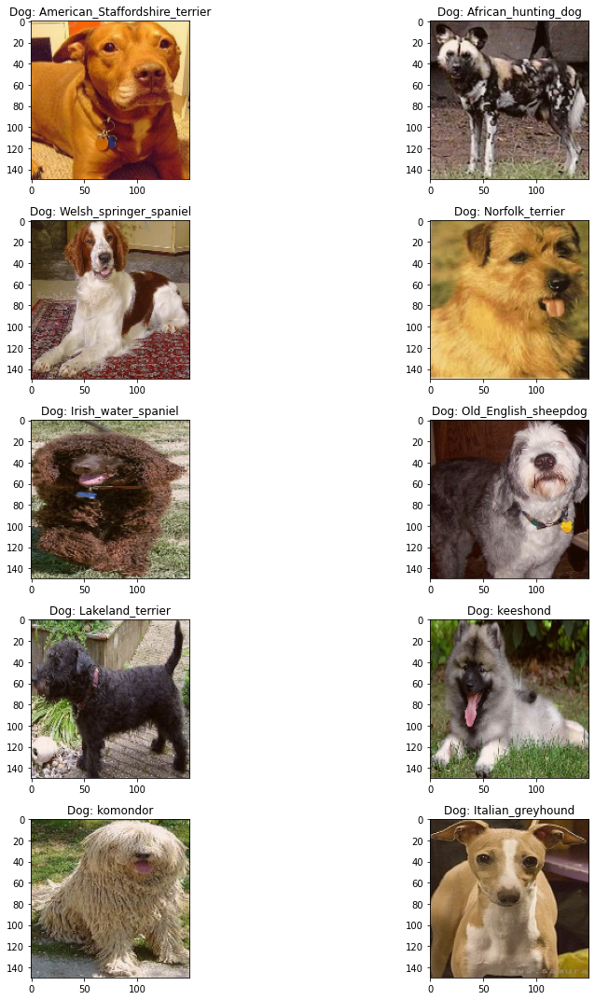

In [93]:
from PIL import Image, ImageOps
import random as rn
import os,shutil,math,scipy,cv2
from tqdm import tqdm
from keras.applications.vgg16 import preprocess_input


X = [] #(2094, 150, 150, 3)
Z = [] #2094
imgsize = 150

def label_assignment(img,label):
    return label

def training_data(label,data_dir):
    
    for img in tqdm(os.listdir(data_dir)):
        
        label = label_assignment(img,label)
        
        path = os.path.join(data_dir,img)
        img = cv2.imread(path,cv2.IMREAD_COLOR)
        
        #resize
        img = cv2.resize(img,(imgsize,imgsize))

        #remove the blue color
        img = preprocess_input(img) 
      
        #Equalization in size 250 for more light
        img = np.uint8(cv2.normalize(img, None, 0, 250, cv2.NORM_MINMAX))

        X.append(np.array(img))
        Z.append(str(label))

#120 classes
count_list =[]
for directory in tqdm(os.listdir("./Images_cropped")):
    print(directory)
    count_list.append(directory)
    label=directory.split("-")[-1]
    data_dir = "./Images_cropped/{}".format(directory)
    training_data('{}'.format(label),data_dir)



#-----------PLOT------------#
fig,ax=plt.subplots(5,2)
fig.set_size_inches(15,15)

for i in range(5):
    for j in range (2):
        l=rn.randint(0,len(Z))
        ax[i,j].imshow(X[l])
        ax[i,j].set_title('Dog: '+Z[l])
        
plt.tight_layout()
print(len(count_list))

In [94]:
print(len(Z))
print(len(X))
print(len(count_list))

20580
20580
120


In [95]:

import os, os.path

# Count files in folder

result_list =[]

DIR = './Images_cropped/'
for folder in tqdm(os.listdir(DIR)):
    path, dirs, files = next(os.walk( './Images_cropped/{}'.format(folder)))
    file_count = len(files)
    result_list.append(file_count)
print(len(result_list))
result_list

100%|██████████| 120/120 [00:00<00:00, 8077.62it/s]

120


[150,
 153,
 169,
 155,
 150,
 156,
 150,
 164,
 170,
 155,
 153,
 200,
 172,
 151,
 183,
 159,
 209,
 153,
 213,
 155,
 169,
 152,
 252,
 149,
 156,
 192,
 172,
 214,
 164,
 150,
 197,
 169,
 175,
 151,
 232,
 158,
 157,
 185,
 196,
 239,
 182,
 202,
 184,
 187,
 159,
 218,
 150,
 150,
 218,
 156,
 150,
 152,
 157,
 200,
 171,
 157,
 171,
 154,
 218,
 150,
 152,
 195,
 155,
 159,
 156,
 188,
 159,
 219,
 186,
 152,
 150,
 148,
 152,
 151,
 150,
 206,
 154,
 195,
 155,
 154,
 158,
 188,
 150,
 151,
 152,
 202,
 150,
 185,
 187,
 182,
 181,
 172,
 155,
 157,
 197,
 178,
 150,
 196,
 202,
 151,
 152,
 196,
 196,
 152,
 167,
 153,
 151,
 180,
 161,
 168,
 172,
 154,
 151,
 169,
 182,
 179,
 159,
 153,
 160,
 210]

In [96]:
# labels

liste =[]
for elememt in count_list:
    label = elememt.split("-")[-1]
    liste.append(label)
    
liste_sorted = sorted(liste)
liste_sorted

['Afghan_hound',
 'African_hunting_dog',
 'Airedale',
 'American_Staffordshire_terrier',
 'Appenzeller',
 'Australian_terrier',
 'Bedlington_terrier',
 'Bernese_mountain_dog',
 'Blenheim_spaniel',
 'Border_collie',
 'Border_terrier',
 'Boston_bull',
 'Bouvier_des_Flandres',
 'Brabancon_griffon',
 'Brittany_spaniel',
 'Cardigan',
 'Chesapeake_Bay_retriever',
 'Chihuahua',
 'Dandie_Dinmont',
 'Doberman',
 'English_foxhound',
 'English_setter',
 'English_springer',
 'EntleBucher',
 'Eskimo_dog',
 'French_bulldog',
 'German_shepherd',
 'Gordon_setter',
 'Great_Dane',
 'Great_Pyrenees',
 'Greater_Swiss_Mountain_dog',
 'Ibizan_hound',
 'Irish_setter',
 'Irish_terrier',
 'Irish_water_spaniel',
 'Irish_wolfhound',
 'Italian_greyhound',
 'Japanese_spaniel',
 'Kerry_blue_terrier',
 'Labrador_retriever',
 'Lakeland_terrier',
 'Leonberg',
 'Lhasa',
 'Maltese_dog',
 'Mexican_hairless',
 'Newfoundland',
 'Norfolk_terrier',
 'Norwegian_elkhound',
 'Norwich_terrier',
 'Old_English_sheepdog',
 'Pekines

In [97]:
def checkIfDuplicates_1(listOfElems):
    ''' Check if given list contains any duplicates '''
    if len(listOfElems) == len(set(listOfElems)):
        return False
    else:
        return True


result = checkIfDuplicates_1(liste_sorted)
if result:
    print('Yes, list contains duplicates')
else:
    print('No duplicates found in list')    

No duplicates found in list


In [84]:
import collections

# Print the duplicated label
print([item for item, count in collections.Counter(liste_sorted).items() if count > 1])

[]


Largeur : 150 px, hauteur : 150 px


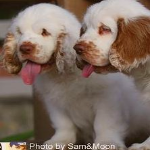

In [98]:
#check the image size

data = X[2]
img = Image.fromarray(data, 'RGB')
#img.save('my.png')
w, h = img.size
print("Largeur : {} px, hauteur : {} px".format(w, h))
img

In [99]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from keras.utils.np_utils import to_categorical
from keras.preprocessing.image import ImageDataGenerator



# Encode Y
label_encoder= LabelEncoder()
print(len(Z))
Y = label_encoder.fit_transform(Z)
print(Y) #(2094,)
Y = to_categorical(Y) #(2094, 11)
print("Y :",Y.shape)
print("---------------")

# Normalize X
X = np.array(X)
X=X/255
print("X :",X.shape)
print("---------------")

X_train,X_test,y_train,y_test = train_test_split(X,Y,test_size=0.3,random_state=69)
print("X_train :",X_train.shape)
print("X_test :",X_test.shape)
print("---------------")
print("y_train :",y_train.shape)
print("y_test :",y_test.shape)


augs_gen = ImageDataGenerator(
        featurewise_center=False,  
        samplewise_center=False, 
        featurewise_std_normalization=False,  
        samplewise_std_normalization=False,  
        zca_whitening=False,  
        rotation_range=10,  
        zoom_range = 0.1, 
        width_shift_range=0.2,  
        height_shift_range=0.2, 
        horizontal_flip=True,  
        vertical_flip=False) 

augs_gen.fit(X_train)   

20580
[86 86 86 ... 41 41 41]
Y : (20580, 120)
---------------
X : (20580, 150, 150, 3)
---------------
X_train : (14406, 150, 150, 3)
X_test : (6174, 150, 150, 3)
---------------
y_train : (14406, 120)
y_test : (6174, 120)


### `adam_v2.Adam(lr=1e-3)`

<keras.engine.input_layer.InputLayer object at 0x7f3752cb1670> False
<keras.layers.convolutional.Conv2D object at 0x7f3752cb1f40> False
<keras.layers.convolutional.Conv2D object at 0x7f3752cb9c10> False
<keras.layers.pooling.MaxPooling2D object at 0x7f37529cfc70> False
<keras.layers.convolutional.Conv2D object at 0x7f3752cbe280> False
<keras.layers.convolutional.Conv2D object at 0x7f3752cad220> False
<keras.layers.pooling.MaxPooling2D object at 0x7f3752cb23a0> False
<keras.layers.convolutional.Conv2D object at 0x7f36e61aa280> False
<keras.layers.convolutional.Conv2D object at 0x7f3752cb2e50> False
<keras.layers.convolutional.Conv2D object at 0x7f3752cd29d0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f3752cbb3d0> False
<keras.layers.convolutional.Conv2D object at 0x7f36e6075940> False
<keras.layers.convolutional.Conv2D object at 0x7f36e605c910> False
<keras.layers.convolutional.Conv2D object at 0x7f36e6051ac0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f36e605e040>

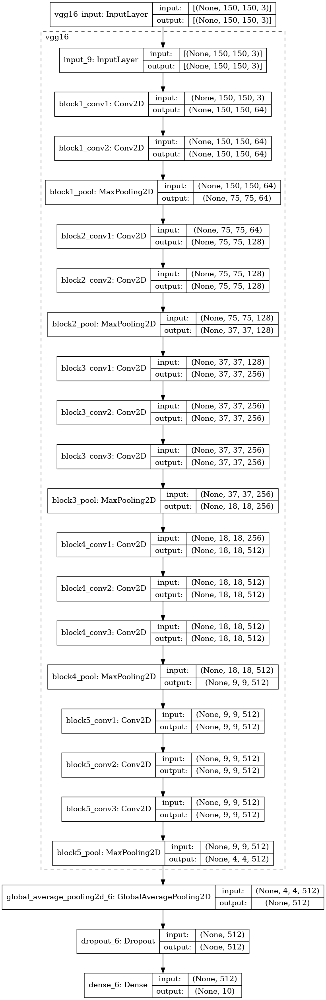

In [377]:
imgsize = 150 

# Load VGG-16 pre-trained on ImageNet and without fully-connected layers
base_model = VGG16(include_top=False,
                   # precise image dimensions 
                  input_shape = (imgsize,imgsize,3),
                  weights = 'imagenet')

for layer in base_model.layers:
    layer.trainable = False
    
for layer in base_model.layers:
    print(layer,layer.trainable)

    
    
#-----------5 Hyper-parameters----------------#

# default initializer - 
# Initializer for the kernel weights matrix. 
Kernel_initializer = "glorot_uniform"
activation = "softmax"
dropout_rate = 0.5
weight_constraint = 3
neurons = 10 # change here

model = Sequential()
model.add(base_model)
model.add(GlobalAveragePooling2D())
model.add(Dropout(dropout_rate))
# After COnv2d activation = 
model.add(Dense(neurons,kernel_initializer = Kernel_initializer, activation=activation, 
                kernel_constraint=max_norm(weight_constraint)))
model.summary()



#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

In [378]:
from keras.optimizers import adam_v2
from tensorflow.keras.optimizers import SGD
from keras.callbacks import ModelCheckpoint

#----------Compile---------------#
learning_rate=1e-3
momentum = None
#opt = SGD(learning_rate=learning_rate,momentum=momentum)
opt1 = adam_v2.Adam(learning_rate=learning_rate)
optimizer=opt1 

model.compile(
    loss='categorical_crossentropy',
    optimizer=optimizer,
    metrics=['accuracy']
)


#-----------Training------------#


checkpoint_callback = ModelCheckpoint('./Checkpoints/checkpoint_VGG16_ADAM.4', 
                                      monitor='val_accuracy', 
                                      verbose=2, 
                                      save_best_only=True, 
                                      save_weights_only=True, 
                                      mode='max' )
start_time= time.time()

# 2 Train Hyper-parameters
batch_size=39
epochs = 10

history = model.fit(
    augs_gen.flow(X_train,y_train,batch_size=39),
    validation_data  = (X_test,y_test),
    validation_steps = len(X_test)//batch_size,
    steps_per_epoch  = len(X_train)//batch_size,
    epochs = epochs, 
    verbose = 1,
    callbacks=checkpoint_callback)

execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time)

Epoch 1/10
40/40 [==============================] - 65s 2s/step - loss: 2.1648 - accuracy: 0.2113 - val_loss: 1.6331 - val_accuracy: 0.4821

Epoch 00001: val_accuracy improved from -inf to 0.48209, saving model to ./Checkpoints_VGG/checkpoint_VGG16_ADAM.2
Epoch 2/10
40/40 [==============================] - 65s 2s/step - loss: 1.7162 - accuracy: 0.3799 - val_loss: 1.5469 - val_accuracy: 0.4761

Epoch 00002: val_accuracy did not improve from 0.48209
Epoch 3/10
40/40 [==============================] - 64s 2s/step - loss: 1.6615 - accuracy: 0.3898 - val_loss: 1.4390 - val_accuracy: 0.5343

Epoch 00003: val_accuracy improved from 0.48209 to 0.53433, saving model to ./Checkpoints_VGG/checkpoint_VGG16_ADAM.2
Epoch 4/10
40/40 [==============================] - 65s 2s/step - loss: 1.5999 - accuracy: 0.4449 - val_loss: 1.4251 - val_accuracy: 0.5537

Epoch 00004: val_accuracy improved from 0.53433 to 0.55373, saving model to ./Checkpoints_VGG/checkpoint_VGG16_ADAM.2
Epoch 5/10
40/40 [============

21/21 [==============================] - 17s 824ms/step - loss: 1.4049 - accuracy: 0.6090
Model Test Loss: 1.4049147367477417
Model Test Accuracy: 0.6089552044868469
Weights Saved


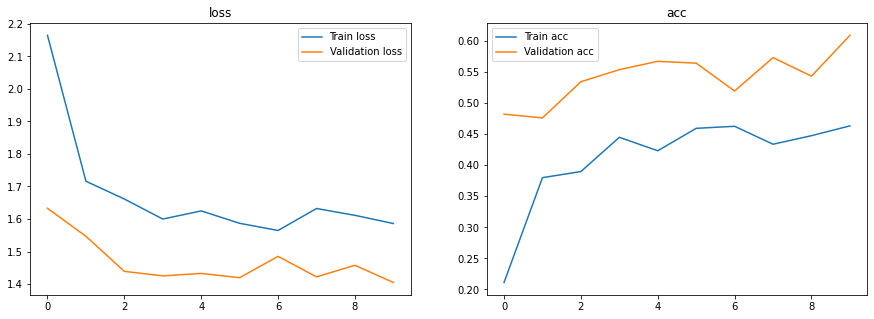

In [379]:
show_final_history(history)

#model.save_weights('./base.model')
model.load_weights('./Checkpoints/checkpoint_VGG16_ADAM.4') 

model_score = model.evaluate(X_test,y_test)
print(mdel.name)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
model.save("./Weights/weight_VGG16_ADAM.4.h5")
print("Weights Saved") 

21/21 [==============================] - 19s 897ms/step - loss: 1.4049 - accuracy: 0.6090
sequential_6
Model Test Loss: 1.4049147367477417
Model Test Accuracy: 0.6089552044868469


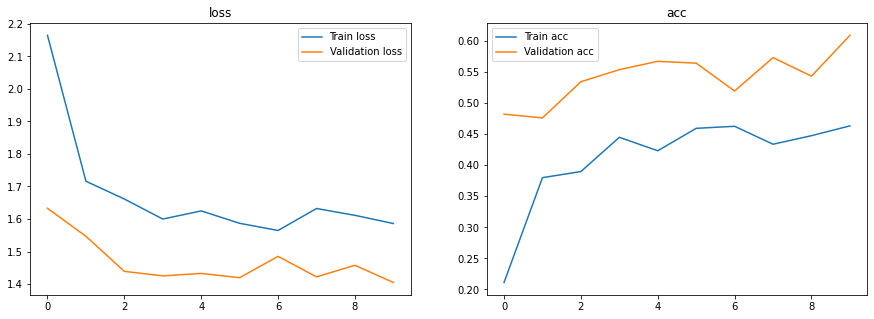

In [487]:
show_final_history(history)

#model.save_weights('./base.model')
model.load_weights('./Checkpoints_VGG/checkpoint_VGG16_ADAM.2') 

model_score = model.evaluate(X_test,y_test)
print(model.name)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
#model.save("./Weights_VGG/weight_VGG16_ADAM.2.h5")
#print("Weights Saved") 

In [493]:
evaluate_save_model (model,
                     history,
                     execution_time, 
                     learning_rate, 
                     batch_size, 
                     momentum,
                     epochs, 
                     optimizer,
                     Kernel_initializer,
                    activation,
                    dropout_rate,
                    weight_constraint,
                    neurons)

21/21 [==============================] - 17s 830ms/step - loss: 1.4049 - accuracy: 0.6090
Evaluation results: [loss, accuracy] [1.4049147367477417, 0.6089552044868469]


### `adam_v2.Adam(lr=1e-4)`

<keras.engine.input_layer.InputLayer object at 0x7f0e589ae3a0> False
<keras.layers.convolutional.Conv2D object at 0x7f0e58a6e1c0> False
<keras.layers.convolutional.Conv2D object at 0x7f0e589c2fa0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0e58a46e50> False
<keras.layers.convolutional.Conv2D object at 0x7f0e58a46100> False
<keras.layers.convolutional.Conv2D object at 0x7f0e58adbb50> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0d4d85f700> False
<keras.layers.convolutional.Conv2D object at 0x7f0e58a7b820> False
<keras.layers.convolutional.Conv2D object at 0x7f0e58970c40> False
<keras.layers.convolutional.Conv2D object at 0x7f0e588ff520> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0e58a8aa60> False
<keras.layers.convolutional.Conv2D object at 0x7f0e58970b20> False
<keras.layers.convolutional.Conv2D object at 0x7f0e58a81910> False
<keras.layers.convolutional.Conv2D object at 0x7f0e5892cd30> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0e58ad64f0>

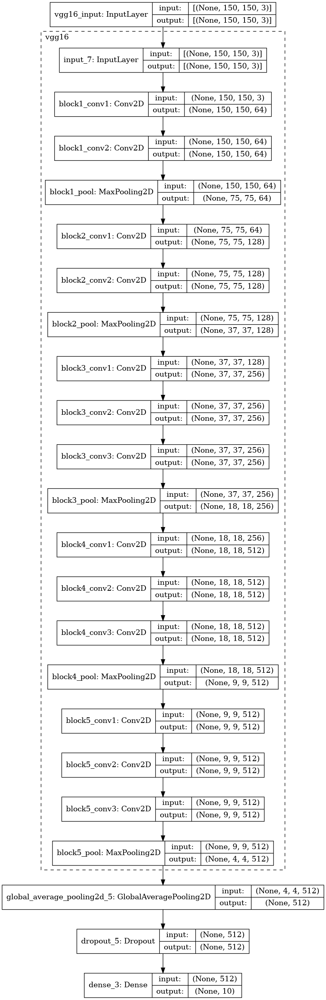

In [65]:
imgsize = 150 

# Load VGG-16 pre-trained on ImageNet and without fully-connected layers
base_model = VGG16(include_top=False,
                   # precise image dimensions 
                  input_shape = (imgsize,imgsize,3),
                  weights = 'imagenet')

for layer in base_model.layers:
    layer.trainable = False
    
for layer in base_model.layers:
    print(layer,layer.trainable)

    
    
#-----------5 Hyper-parameters----------------#

# default initializer - 
# Initializer for the kernel weights matrix. 
Kernel_initializer = "glorot_uniform"
activation = "softmax"
dropout_rate = 0.5
weight_constraint = 3
neurons = 10 # change here

model = Sequential()
model.add(base_model)
model.add(GlobalAveragePooling2D())
model.add(Dropout(dropout_rate))
# After COnv2d activation = 
model.add(Dense(neurons,kernel_initializer = Kernel_initializer, activation=activation, 
                kernel_constraint=max_norm(weight_constraint)))
model.summary()



#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

In [66]:
from keras.optimizers import adam_v2
from tensorflow.keras.optimizers import SGD
from keras.callbacks import ModelCheckpoint

#----------Compile---------------#
learning_rate=1e-4
momentum = None
#opt = SGD(learning_rate=learning_rate,momentum=momentum)
opt1 = adam_v2.Adam(learning_rate=learning_rate)
optimizer=opt1 

model.compile(
    loss='categorical_crossentropy',
    optimizer=optimizer,
    metrics=['accuracy']
)


#-----------Training------------#


checkpoint_callback = ModelCheckpoint('./Checkpoints/checkpoint_VGG16_ADAM.3', 
                                      monitor='val_accuracy', 
                                      verbose=2, 
                                      save_best_only=True, 
                                      save_weights_only=True, 
                                      mode='max' )
start_time= time.time()

# 2 Train Hyper-parameters
batch_size=39
epochs = 10

history = model.fit(
    augs_gen.flow(X_train,y_train,batch_size=39),
    validation_data  = (X_test,y_test),
    validation_steps = len(X_test)//batch_size,
    steps_per_epoch  = len(X_train)//batch_size,
    epochs = epochs, 
    verbose = 1,
    callbacks=checkpoint_callback)

execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time)

Epoch 1/10
40/40 [==============================] - 64s 2s/step - loss: 2.7954 - accuracy: 0.0873 - val_loss: 2.5001 - val_accuracy: 0.0970

Epoch 00001: val_accuracy improved from -inf to 0.09701, saving model to ./Checkpoints/checkpoint_VGG16_ADAM.3
Epoch 2/10
40/40 [==============================] - 66s 2s/step - loss: 2.7549 - accuracy: 0.0958 - val_loss: 2.4208 - val_accuracy: 0.0940

Epoch 00002: val_accuracy did not improve from 0.09701
Epoch 3/10
40/40 [==============================] - 66s 2s/step - loss: 2.6706 - accuracy: 0.0951 - val_loss: 2.3631 - val_accuracy: 0.0910

Epoch 00003: val_accuracy did not improve from 0.09701
Epoch 4/10
40/40 [==============================] - 65s 2s/step - loss: 2.5761 - accuracy: 0.1043 - val_loss: 2.3185 - val_accuracy: 0.1030

Epoch 00004: val_accuracy improved from 0.09701 to 0.10299, saving model to ./Checkpoints/checkpoint_VGG16_ADAM.3
Epoch 5/10
40/40 [==============================] - 66s 2s/step - loss: 2.5068 - accuracy: 0.1161 - v

21/21 [==============================] - 17s 826ms/step - loss: 2.2091 - accuracy: 0.2000
Model Test Loss: 2.209122896194458
Model Test Accuracy: 0.20000000298023224
Weights Saved


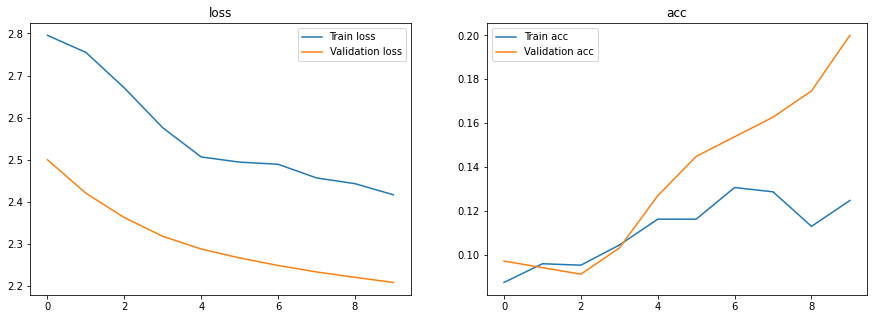

In [67]:
show_final_history(history)

#model.save_weights('./base.model')
model.load_weights('./Checkpoints/checkpoint_VGG16_ADAM.3') 

model_score = model.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
model.save("./Weights/weight_VGG16_ADAM.3.h5")
print("Weights Saved") 

In [68]:
evaluate_save_model (model,
                     history,
                     execution_time, 
                     learning_rate, 
                     batch_size, 
                     momentum,
                     epochs, 
                     optimizer,
                     Kernel_initializer,
                    activation,
                    dropout_rate,
                    weight_constraint,
                    neurons)

21/21 [==============================] - 19s 901ms/step - loss: 2.2091 - accuracy: 0.2000
Evaluation results: [loss, accuracy] [2.209122896194458, 0.20000000298023224]


## <font color="#337da4">VGG19</font>

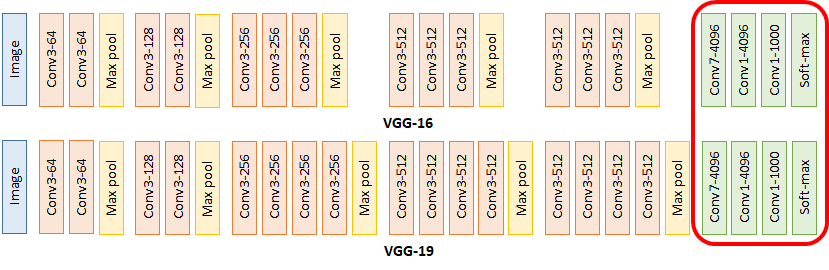

<keras.engine.input_layer.InputLayer object at 0x7f0e5980e0d0> False
<keras.layers.convolutional.Conv2D object at 0x7f0e5980e7f0> False
<keras.layers.convolutional.Conv2D object at 0x7f0e5956b310> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0e5948edc0> False
<keras.layers.convolutional.Conv2D object at 0x7f0e59a11f70> False
<keras.layers.convolutional.Conv2D object at 0x7f0e53fe41f0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0e53f3d8b0> False
<keras.layers.convolutional.Conv2D object at 0x7f0e53f3d400> False
<keras.layers.convolutional.Conv2D object at 0x7f0e584e0610> False
<keras.layers.convolutional.Conv2D object at 0x7f0e5957b910> False
<keras.layers.convolutional.Conv2D object at 0x7f0e594a6130> False
<keras.layers.pooling.MaxPooling2D object at 0x7f0e53fc51f0> False
<keras.layers.convolutional.Conv2D object at 0x7f0e5948d100> False
<keras.layers.convolutional.Conv2D object at 0x7f0e586163d0> False
<keras.layers.convolutional.Conv2D object at 0x7f0e5948d430>

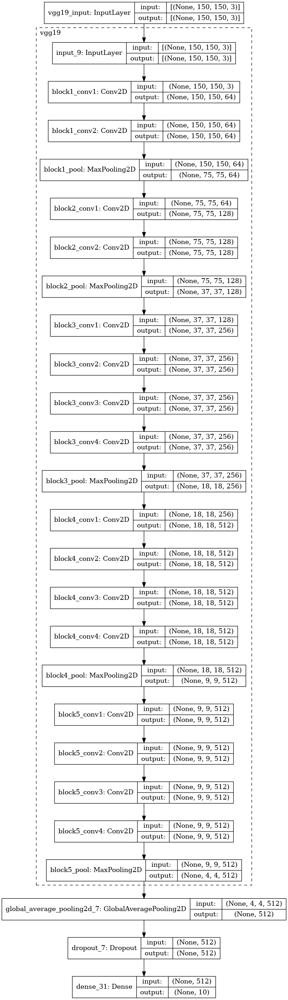

In [148]:
from keras.models import Sequential
from keras.layers import Dense,Flatten,Dropout,Concatenate,GlobalAveragePooling2D,Lambda,ZeroPadding2D
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
from keras.utils.vis_utils import plot_model
import keras.utils.vis_utils
from importlib import reload
reload(keras.utils.vis_utils)
from keras.applications.vgg19 import VGG19

# Load VGG-119 pre-trained on ImageNet and without fully-connected layers
base_model = VGG19(include_top=False,
                   # precise image dimensions 
                  input_shape = (imgsize,imgsize,3),
                  weights = 'imagenet')

# the layers are not re-trained 
for layer in base_model.layers:
    layer.trainable = False
    
for layer in base_model.layers:
    print(layer,layer.trainable)

#-----------5 Hyper-parameters----------------#

# default initializer - 
# Initializer for the kernel weights matrix. 
Kernel_initializer = "glorot_uniform"
activation = "softmax"
dropout_rate = 0.5
weight_constraint = 3
neurons = 10 

model = Sequential()
model.add(base_model)
model.add(GlobalAveragePooling2D())
model.add(Dropout(dropout_rate))
# After COnv2d activation = 
model.add(Dense(neurons,kernel_initializer = Kernel_initializer, activation=activation, 
                kernel_constraint=max_norm(weight_constraint)))
model.summary()

#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

### `adam_v2.Adam(lr=1e-2)`

In [149]:
from keras.optimizers import adam_v2
from tensorflow.keras.optimizers import SGD
from keras.callbacks import ModelCheckpoint

#----------Compile---------------#

# 3 Hyper-parameters
learning_rate=1e-2
Momentum = None

#opt = SGD(lr=1e-4,momentum=0.99)
opt1 = adam_v2.Adam(learning_rate=learning_rate)
optimizer=opt1

model.compile(
    loss='categorical_crossentropy', #for probabilities 
    optimizer=optimizer,
    metrics=['accuracy']
)


#-----------Training------------#


checkpoint_callback = ModelCheckpoint('./Checkpoints/checkpoint_VGG19', 
                                      monitor='val_accuracy', 
                                      verbose=2, 
                                      save_best_only=True, 
                                      save_weights_only=True, 
                                      mode='max' )

# 2 Train Hyper-parameters
batch_size=39
epochs = 10

start_time= time.time()

history = model.fit_generator(
    augs_gen.flow(X_train,y_train,batch_size=batch_size),
    validation_data  = (X_test,y_test),
    validation_steps = len(X_test)//batch_size,
    steps_per_epoch  = len(X_train)//batch_size,
    epochs = epochs, 
    verbose = 1,
    callbacks=checkpoint_callback
)
execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time)

/home/catherinele/.local/lib/python3.9/site-packages/keras/engine/training.py:1972: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/10
40/40 [==============================] - 77s 2s/step - loss: 2.2382 - accuracy: 0.1988 - val_loss: 1.7552 - val_accuracy: 0.3657

Epoch 00001: val_accuracy improved from -inf to 0.36567, saving model to ./Checkpoints/checkpoint_VGG19


INFO:tensorflow:Assets written to: ./Checkpoints/checkpoint_VGG19/assets
Epoch 2/10
40/40 [==============================] - 82s 2s/step - loss: 1.8005 - accuracy: 0.3404 - val_loss: 1.6090 - val_accuracy: 0.4567

Epoch 00002: val_accuracy improved from 0.36567 to 0.45672, saving model to ./Checkpoints/checkpoint_VGG19
INFO:tensorflow:Assets written to: ./Checkpoints/checkpoint_VGG19/assets
Epoch 3/10
40/40 [==============================] - 81s 2s/step - loss: 1.7573 - accuracy: 0.3675 - val_loss: 1.5537 - val_accuracy: 0.4776

Epoch 00003: val_accuracy improved from 0.45672 to 0.47761, saving model to ./Checkpoints/checkpoint_VGG19
INFO:tensorflow:Assets written to: ./Checkpoints/checkpoint_VGG19/assets
Epoch 4/10
40/40 [==============================] - 81s 2s/step - loss: 1.7240 - accuracy: 0.3937 - val_loss: 1.5326 - val_accuracy: 0.5164

Epoch 00004: val_accuracy improved from 0.47761 to 0.51642, saving model to ./Checkpoints/checkpoint_VGG19
INFO:tensorflow:Assets written to: ./

21/21 [==============================] - 24s 1s/step - loss: 1.5265 - accuracy: 0.5433
Model Test Loss: 1.5265291929244995
Model Test Accuracy: 0.5432835817337036
Weights Saved


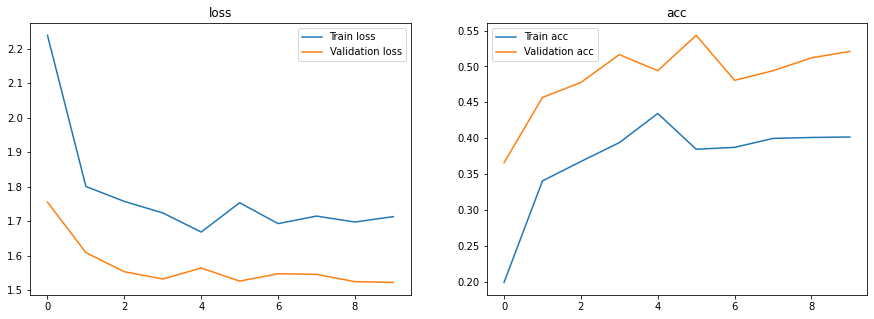

In [150]:
show_final_history(history)

#model.save_weights('./base.model')
model.load_weights('./Checkpoints/checkpoint_VGG19')

model_score = model.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
model.save("./Weights/weight_VGG19.h5")
print("Weights Saved") 

In [151]:
evaluate_save_model (model,
                     history,
                     execution_time, 
                     learning_rate, 
                     batch_size, 
                     momentum,
                     epochs, 
                     optimizer,
                     Kernel_initializer,
                    activation,
                    dropout_rate,
                    weight_constraint,
                    neurons)

21/21 [==============================] - 21s 1s/step - loss: 1.5265 - accuracy: 0.5433
Evaluation results: [loss, accuracy] [1.5265291929244995, 0.5432835817337036]


## <font color="#337da4">CNN4 - no batch nor Dropout  </font>

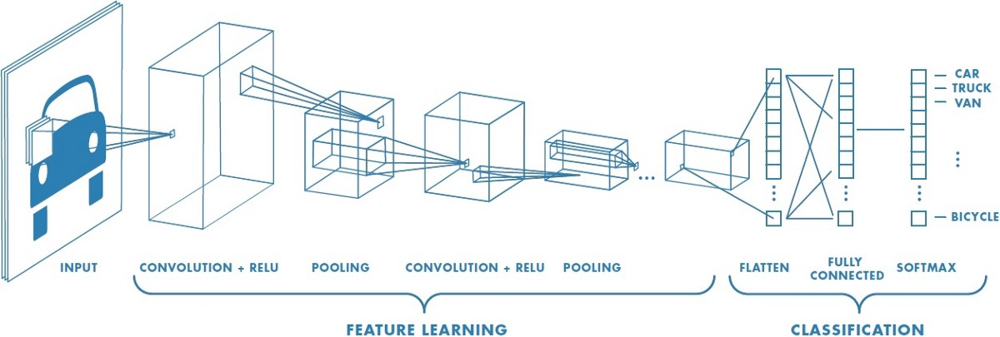

Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_45 (Conv2D)           (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_45 (MaxPooling (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_46 (Conv2D)           (None, 72, 72, 64)        18496     
_________________________________________________________________
max_pooling2d_46 (MaxPooling (None, 36, 36, 64)        0         
_________________________________________________________________
flatten_18 (Flatten)         (None, 82944)             0         
_________________________________________________________________
dense_36 (Dense)             (None, 64)                5308480   
_________________________________________________________________
dense_37 (Dense)             (None, 10)              

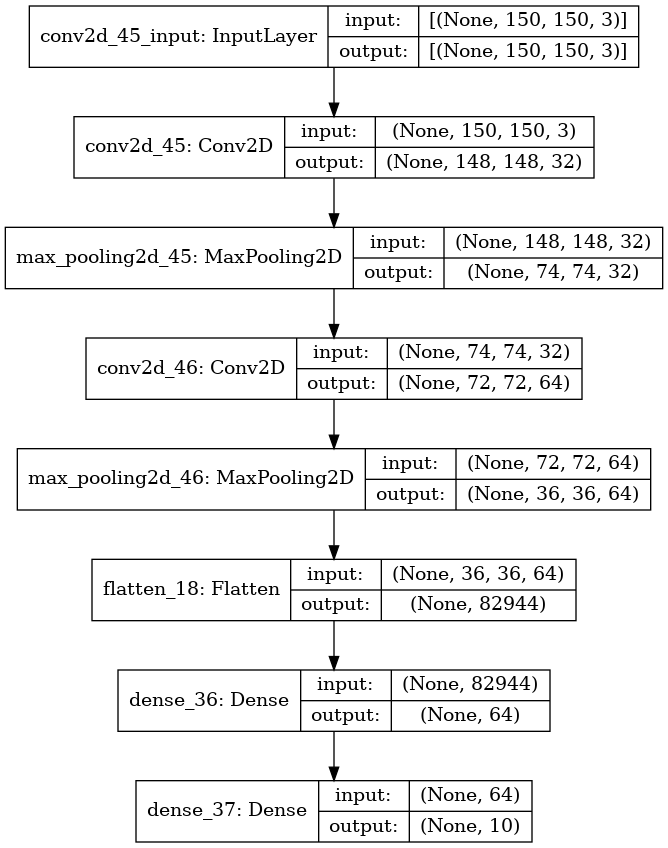

In [170]:
from tensorflow.keras import datasets, layers, models

# CNN4 see. picture above


# 5 Model Hyper-parameters
Kernel_initializer =  None
activation = 'relu'
dropout_rate = None
weight_constraint = 3
neurons = 64


cnn = models.Sequential([
    
    layers.Conv2D(filters=32, kernel_size=(3, 3), activation='relu', input_shape=(150, 150, 3)),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=64, kernel_size=(3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    
    layers.Flatten(), #Return a copy of the array collapsed into one dimension.
    layers.Dense(neurons, kernel_initializer=Kernel_initializer,
                 kernel_constraint=max_norm(weight_constraint),
                 activation=activation),
    
    layers.Dense(10, kernel_initializer=Kernel_initializer, activation='softmax')
])


cnn.summary()

#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(cnn, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

In [394]:
# #to verify keys 

# checkpoint_callback = ModelCheckpoint('./base.model', 
#                                       monitor='val_accuracy', 
#                                       verbose=2, 
#                                       save_best_only=True, 
#                                       save_weights_only=False, 
#                                       mode='max' )

# hist = cnn.fit_generator(augs_gen.flow(X_train,y_train,batch_size=32),
#     epochs=1,
#     validation_data  = (X_test,y_test),
#     validation_steps = len(X_test)//batch_size,
#     steps_per_epoch  = len(X_train)//batch_size, 
#     callbacks = checkpoint_callback)
# for key in hist.history:
#     print(key)

40/40 [==============================] - 10s 250ms/step - loss: 0.1915 - accuracy: 0.9591 - val_loss: 2.0746 - val_accuracy: 0.4418

Epoch 00001: val_accuracy improved from -inf to 0.44179, saving model to ./base.model
INFO:tensorflow:Assets written to: ./base.model/assets
loss
accuracy
val_loss
val_accuracy


In [171]:



#----------Compile---------------#

# 3 Hyper-parameters
learning_rate=1e-3
Momentum = None

opt1 = adam_v2.Adam(learning_rate=learning_rate)
optimizer=opt1


cnn.compile(optimizer=optimizer,
              loss='categorical_crossentropy',
              metrics=['accuracy'])


#----------Training---------------#

checkpoint_callback = ModelCheckpoint('./Checkpoints/checkpoint_CNN4', 
                                      monitor='val_accuracy', 
                                      verbose=2, 
                                      save_best_only=True, 
                                      save_weights_only=True, 
                                      mode='max' )
'''
augs_gen increase the score 
fit_generator increase the score 
'''

# 2 Train Hyper-parameters
batch_size = 39
epochs=10

start_time= time.time()
history = cnn.fit_generator(augs_gen.flow(X_train,y_train,batch_size=batch_size),
    epochs=epochs,
    validation_data  = (X_test,y_test),
    validation_steps = len(X_test)//batch_size,
    steps_per_epoch  = len(X_train)//batch_size, 
    callbacks = checkpoint_callback)

execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time)

/home/catherinele/.local/lib/python3.9/site-packages/keras/engine/training.py:1972: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/10
40/40 [==============================] - 11s 257ms/step - loss: 2.6560 - accuracy: 0.0997 - val_loss: 2.2903 - val_accuracy: 0.0821

Epoch 00001: val_accuracy improved from -inf to 0.08209, saving model to ./Checkpoints/checkpoint_CNN4
Epoch 2/10
40/40 [==============================] - 10s 252ms/step - loss: 2.2661 - accuracy: 0.1404 - val_loss: 2.2271 - val_accuracy: 0.1791

Epoch 00002: val_accuracy improved from 0.08209 to 0.17910, saving model to ./Checkpoints/checkpoint_CNN4
Epoch 3/10
40/40 [==============================] - 11s 262ms/step - loss: 2.1860 - accuracy: 0.1870 - val_loss: 2.0865 - val_accuracy: 0.2284

Epoch 00003: val_accuracy improved from 0.17910 to 0.22836, saving model to ./Checkpoints/checkpoint_CNN4
Epoch 4/10
40/40 [==============================] - 11s 263ms/step - loss: 2.0554 - accuracy: 0.2290 - val_loss: 1.9296 - val_accuracy: 0.2925

Epoch 00004: val_accuracy improved from 0.22836 to 0.29254, saving model to ./Checkpoints/checkpoint_CNN4
Epo

21/21 [==============================] - 1s 37ms/step - loss: 1.6042 - accuracy: 0.4299
Model Test Loss: 1.6041786670684814
Model Test Accuracy: 0.4298507571220398
Weights Saved


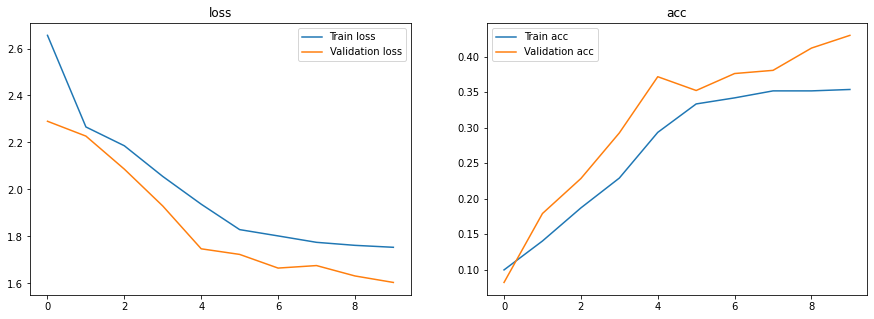

In [172]:
show_final_history(history)

#model.save_weights('./base.model')
cnn.load_weights('./Checkpoints/checkpoint_CNN4') 

model_score = cnn.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
cnn.save("./Weights/weight_CNN4.h5")
print("Weights Saved") 

In [173]:
# Save in .json metrics file

evaluate_save_model (cnn,
                     history,
                     execution_time, 
                     learning_rate, 
                     batch_size, 
                     momentum,
                     epochs, 
                     optimizer,
                     Kernel_initializer,
                    activation,
                    dropout_rate,
                    weight_constraint,
                    neurons)

21/21 [==============================] - 1s 36ms/step - loss: 1.6042 - accuracy: 0.4299
Evaluation results: [loss, accuracy] [1.6041786670684814, 0.4298507571220398]


## <font color="#337da4">Basic CNN6 - no batch nor dropout </font>

Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_41 (Conv2D)           (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_41 (MaxPooling (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_42 (Conv2D)           (None, 72, 72, 64)        18496     
_________________________________________________________________
max_pooling2d_42 (MaxPooling (None, 36, 36, 64)        0         
_________________________________________________________________
conv2d_43 (Conv2D)           (None, 34, 34, 128)       73856     
_________________________________________________________________
max_pooling2d_43 (MaxPooling (None, 17, 17, 128)       0         
_________________________________________________________________
conv2d_44 (Conv2D)           (None, 15, 15, 128)     

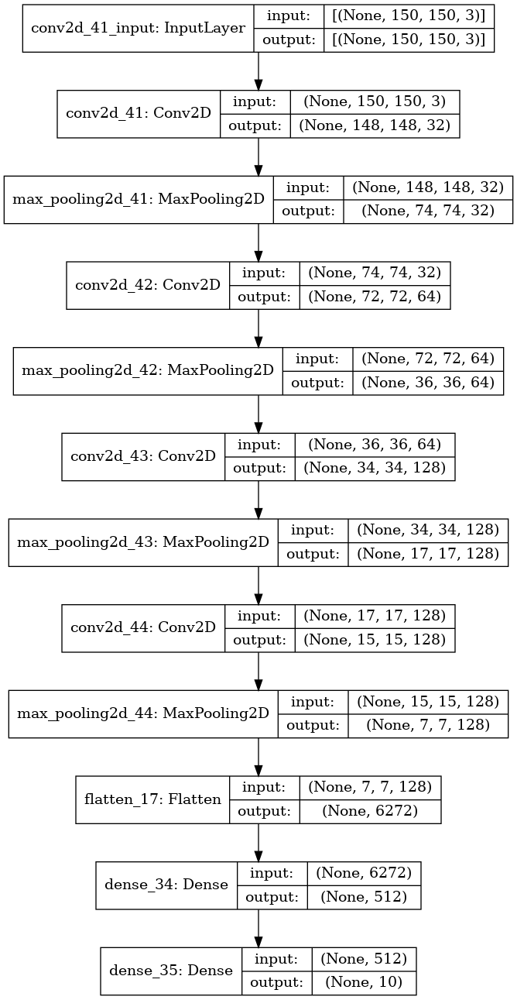

In [162]:


# 5 hyper-parameters

Kernel_initializer = None
activation = "relu"
dropout_rate = None
weight_constraint = 3
neurons = 512


cnn = models.Sequential([
    
    layers.Conv2D(filters=32, kernel_size=(3, 3), activation='relu', input_shape=(150, 150, 3)),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=64, kernel_size=(3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=128, kernel_size=(3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=128, kernel_size=(3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    
    layers.Flatten(),
    layers.Dense(neurons, kernel_initializer=Kernel_initializer, 
                 kernel_constraint=max_norm(weight_constraint),
                 activation=activation),
    
    layers.Dense(10, kernel_initializer=Kernel_initializer, activation='softmax')
])


cnn.summary()

#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(cnn, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

In [163]:


#----------Compile---------------#
# 3 Hyper-parameters
learning_rate=1e-3
Momentum = None

opt1 = adam_v2.Adam(learning_rate=learning_rate)
optimizer=opt1



cnn.compile(optimizer=optimizer,
              loss='categorical_crossentropy',
              metrics=['accuracy'])


#----------Training---------------#
checkpoint_callback = ModelCheckpoint('./Checkpoints/checkpoint_CNN6.1', 
                                      monitor='val_accuracy', 
                                      verbose=2, 
                                      save_best_only=True, 
                                      save_weights_only=True, 
                                      mode='max' )
batch_size= 39
epochs=10

start_time= time.time()
history = cnn.fit_generator(augs_gen.flow(X_train,y_train,batch_size=batch_size),
    epochs=epochs,
    validation_data  = (X_test,y_test),
    validation_steps = len(X_test)//batch_size,
    steps_per_epoch  = len(X_train)//batch_size, 
    callbacks = checkpoint_callback)

execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time)

/home/catherinele/.local/lib/python3.9/site-packages/keras/engine/training.py:1972: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/10
40/40 [==============================] - 13s 325ms/step - loss: 2.1989 - accuracy: 0.1686 - val_loss: 2.0425 - val_accuracy: 0.1881

Epoch 00001: val_accuracy improved from -inf to 0.18806, saving model to ./Checkpoints/checkpoint_CNN6.1
Epoch 2/10
40/40 [==============================] - 13s 326ms/step - loss: 1.9806 - accuracy: 0.2697 - val_loss: 1.9258 - val_accuracy: 0.2358

Epoch 00002: val_accuracy improved from 0.18806 to 0.23582, saving model to ./Checkpoints/checkpoint_CNN6.1
Epoch 3/10
40/40 [==============================] - 14s 354ms/step - loss: 1.9009 - accuracy: 0.3012 - val_loss: 2.1461 - val_accuracy: 0.2597

Epoch 00003: val_accuracy improved from 0.23582 to 0.25970, saving model to ./Checkpoints/checkpoint_CNN6.1
Epoch 4/10
40/40 [==============================] - 14s 348ms/step - loss: 1.8338 - accuracy: 0.3287 - val_loss: 1.6723 - val_accuracy: 0.4209

Epoch 00004: val_accuracy improved from 0.25970 to 0.42090, saving model to ./Checkpoints/checkpoint_CN

21/21 [==============================] - 1s 49ms/step - loss: 1.4615 - accuracy: 0.4791
Model Test Loss: 1.4615325927734375
Model Test Accuracy: 0.47910448908805847
Weights Saved


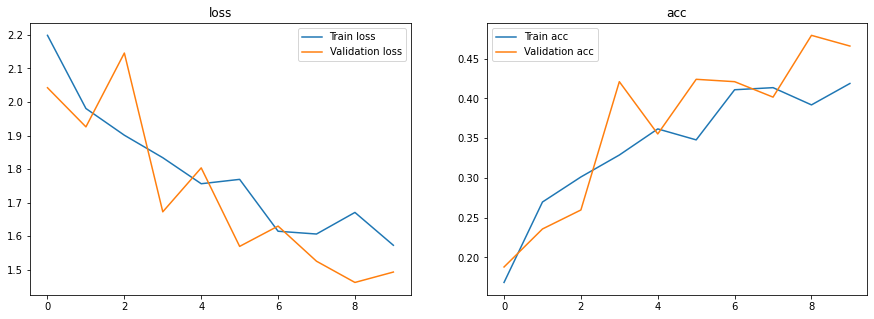

In [166]:
show_final_history(history)

#model.save_weights('./base.model')
cnn.load_weights('./Checkpoints/checkpoint_CNN6.1')

model_score = cnn.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
cnn.save("./Weights/weight_CNN6.1.h5")
print("Weights Saved") 

**<font color="green">Test Accuracy a légèrement augmenté avec moins d'overfitting.</font>**

In [167]:
# Save in .json metrics file

evaluate_save_model (cnn,
                     history,
                     execution_time, 
                     learning_rate, 
                     batch_size, 
                     momentum,
                     epochs, 
                     optimizer,
                     Kernel_initializer,
                    activation,
                    dropout_rate,
                    weight_constraint,
                    neurons)

21/21 [==============================] - 1s 49ms/step - loss: 1.4615 - accuracy: 0.4791
Evaluation results: [loss, accuracy] [1.4615325927734375, 0.47910448908805847]


## <font color="#337da4">Basic CNN5 - with batch</font>

La normalisation par lots est une méthode utilisée pour rendre les réseaux de neurones artificiels plus rapides et plus stables grâce à la normalisation des entrées des couches par recentrage et remise à l'échelle. - Wikipedia

Les couches de batch normalization effectuent un recentrage et une normalisation des données. La couche de batch normalization est une autre technique de réduction du phénomène d'**évanescence du gradient**, lorsque des fonctions du type relu ne sont pas utilisées.


Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_47 (Conv2D)           (None, 148, 148, 16)      448       
_________________________________________________________________
max_pooling2d_47 (MaxPooling (None, 74, 74, 16)        0         
_________________________________________________________________
conv2d_48 (Conv2D)           (None, 72, 72, 32)        4640      
_________________________________________________________________
batch_normalization_10 (Batc (None, 72, 72, 32)        128       
_________________________________________________________________
max_pooling2d_48 (MaxPooling (None, 36, 36, 32)        0         
_________________________________________________________________
conv2d_49 (Conv2D)           (None, 34, 34, 64)        18496     
_________________________________________________________________
batch_normalization_11 (Batc (None, 34, 34, 64)      

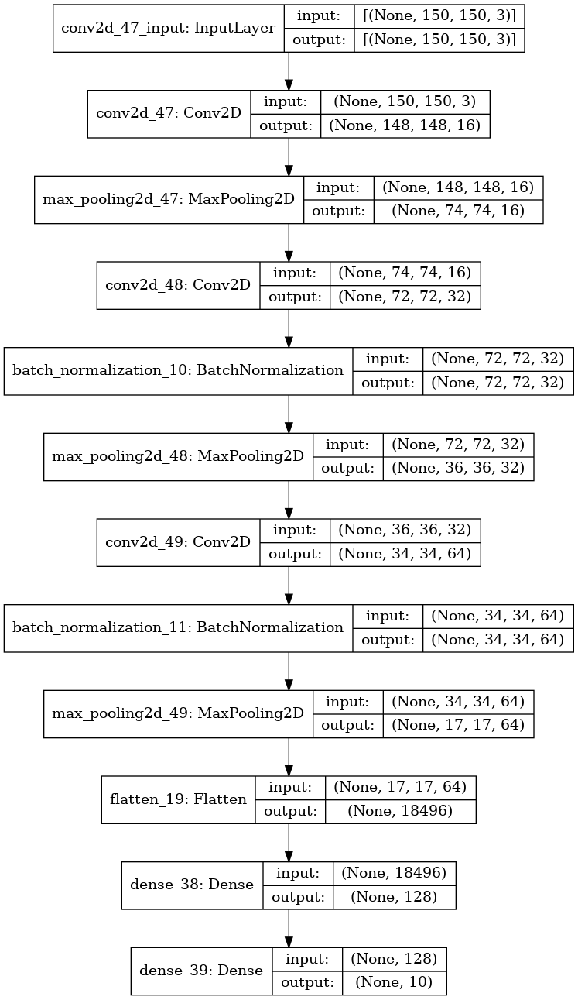

In [177]:

'''with batch normalization 
between a convolutional and max pooling layers.
'''

# 5 hyper-parameters

Kernel_initializer = None
activation = "relu"
dropout_rate = None
weight_constraint = 3
neurons = 128



cnn = models.Sequential([
    
    layers.Conv2D(filters=16, kernel_size=(3, 3), activation=activation, input_shape=(150, 150, 3)),
    layers.MaxPooling2D((2, 2)),

    layers.Conv2D(filters=32, kernel_size=(3, 3), activation=activation),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=64, kernel_size=(3, 3), activation=activation),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    

    
    layers.Flatten(),
    layers.Dense(neurons, kernel_initializer=Kernel_initializer,
                 kernel_constraint=max_norm(weight_constraint),
                 activation=activation),
    
    layers.Dense(10, kernel_initializer=Kernel_initializer, activation='softmax')
])


cnn.summary()

#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(cnn, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

In [181]:


#----------Compile---------------#
# 3 Hyper-parameters
learning_rate=1e-4
Momentum = None

opt1 = adam_v2.Adam(learning_rate=learning_rate)
optimizer=opt1


cnn.compile(
    loss='categorical_crossentropy',
    optimizer=optimizer,
    metrics=['accuracy']
)


#-----------Training------------#


checkpoint_callback = ModelCheckpoint('./Checkpoints/checkpoint_CNN5', 
                                      monitor='val_accuracy', 
                                      verbose=2, 
                                      save_best_only=True, 
                                      save_weights_only=True, 
                                      mode='max' )
batch_size=39
epochs=10
start_time= time.time()
history = cnn.fit_generator(augs_gen.flow(X_train,y_train,batch_size=batch_size),
    epochs=epochs,
    validation_data  = (X_test,y_test),
    validation_steps = len(X_test)//batch_size,
    steps_per_epoch  = len(X_train)//batch_size, 
    callbacks = checkpoint_callback)

execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time)

Epoch 1/10
40/40 [==============================] - 9s 216ms/step - loss: 1.6480 - accuracy: 0.4049 - val_loss: 1.6865 - val_accuracy: 0.4015

Epoch 00001: val_accuracy improved from -inf to 0.40149, saving model to ./Checkpoints/checkpoint_CNN5
Epoch 2/10
40/40 [==============================] - 9s 212ms/step - loss: 1.5703 - accuracy: 0.4357 - val_loss: 1.5108 - val_accuracy: 0.4627

Epoch 00002: val_accuracy improved from 0.40149 to 0.46269, saving model to ./Checkpoints/checkpoint_CNN5
Epoch 3/10
40/40 [==============================] - 9s 211ms/step - loss: 1.5448 - accuracy: 0.4383 - val_loss: 1.5075 - val_accuracy: 0.4239

Epoch 00003: val_accuracy did not improve from 0.46269
Epoch 4/10
40/40 [==============================] - 9s 211ms/step - loss: 1.5146 - accuracy: 0.4514 - val_loss: 1.5130 - val_accuracy: 0.4164

Epoch 00004: val_accuracy did not improve from 0.46269
Epoch 5/10
40/40 [==============================] - 8s 215ms/step - loss: 1.5441 - accuracy: 0.4370 - val_los

21/21 [==============================] - 1s 23ms/step - loss: 1.5069 - accuracy: 0.4731
Model Test Loss: 1.5069431066513062
Model Test Accuracy: 0.4731343388557434
Weights Saved


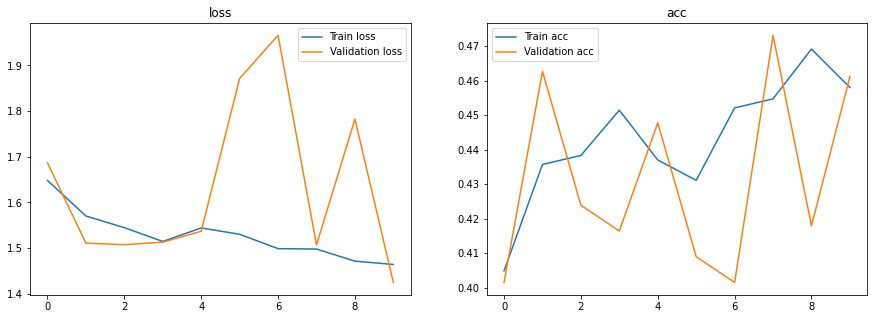

In [182]:
show_final_history(history)

#model.save_weights('./base.model')
cnn.load_weights('./Checkpoints/checkpoint_CNN5')

model_score = cnn.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
cnn.save("./Weights/weight_CNN5.h5")
print("Weights Saved") 

In [183]:
# Save in .json metrics file

evaluate_save_model (cnn,
                     history,
                     execution_time, 
                     learning_rate, 
                     batch_size, 
                     momentum,
                     epochs, 
                     optimizer,
                     Kernel_initializer,
                    activation,
                    dropout_rate,
                    weight_constraint,
                    neurons)

21/21 [==============================] - 1s 23ms/step - loss: 1.5069 - accuracy: 0.4731
Evaluation results: [loss, accuracy] [1.5069431066513062, 0.4731343388557434]


## <font color="#337da4">CNN6 - with batch</font>

Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_50 (Conv2D)           (None, 148, 148, 16)      448       
_________________________________________________________________
batch_normalization_12 (Batc (None, 148, 148, 16)      64        
_________________________________________________________________
max_pooling2d_50 (MaxPooling (None, 74, 74, 16)        0         
_________________________________________________________________
conv2d_51 (Conv2D)           (None, 72, 72, 32)        4640      
_________________________________________________________________
batch_normalization_13 (Batc (None, 72, 72, 32)        128       
_________________________________________________________________
max_pooling2d_51 (MaxPooling (None, 36, 36, 32)        0         
_________________________________________________________________
conv2d_52 (Conv2D)           (None, 34, 34, 64)      

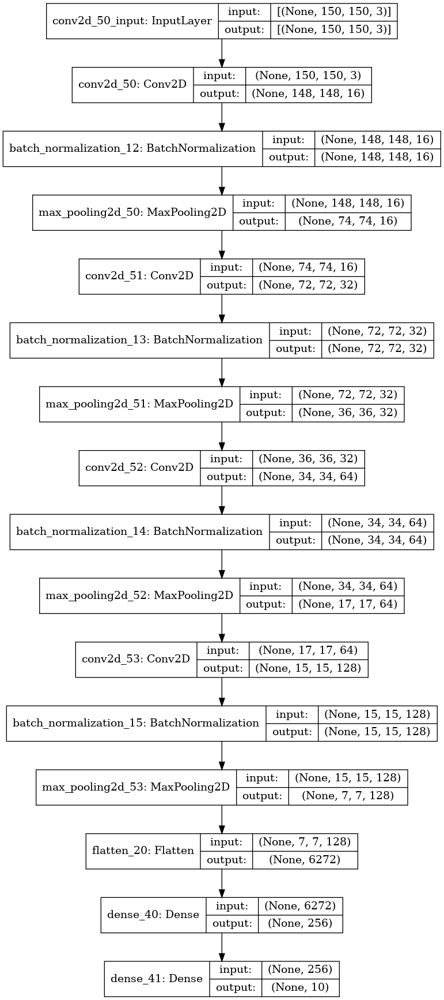

In [186]:

# 5 hyper-parameters

Kernel_initializer = None
activation = "relu"
dropout_rate = None
weight_constraint = 3
neurons =256

cnn = models.Sequential([
    
    layers.Conv2D(filters=16, kernel_size=(3, 3), activation=activation, input_shape=(150, 150, 3)),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=32, kernel_size=(3, 3), activation=activation),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=64, kernel_size=(3, 3), activation=activation),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=128, kernel_size=(3, 3), activation=activation),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    
    layers.Flatten(),
    layers.Dense(neurons, kernel_initializer=Kernel_initializer,
                 activation=activation,
                kernel_constraint=max_norm(weight_constraint)),
    
    layers.Dense(10, kernel_initializer=Kernel_initializer,
                 activation='softmax')
])


cnn.summary()

#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(cnn, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

In [190]:


#----------Compile---------------#
# 3 Hyper-parameters
learning_rate=1e-4
Momentum = None

opt1 = adam_v2.Adam(learning_rate=learning_rate)
optimizer=opt1


cnn.compile(
    loss='categorical_crossentropy',
    optimizer=opt1,
    metrics=['accuracy']
)


#-----------Training------------#


checkpoint_callback = ModelCheckpoint('./Checkpoints/checkpoint_CNN6.2',
                                      monitor='val_accuracy', 
                                      verbose=2, 
                                      save_best_only=True, 
                                      save_weights_only=True, 
                                      mode='max' )
batch_size=39
epochs=10

start_time= time.time()
history = cnn.fit_generator(augs_gen.flow(X_train,y_train,batch_size=batch_size),
    epochs=epochs,
    validation_data  = (X_test,y_test),
    validation_steps = len(X_test)//batch_size,
    steps_per_epoch  = len(X_train)//batch_size, 
    callbacks = checkpoint_callback)

execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time)

Epoch 1/10
40/40 [==============================] - 10s 244ms/step - loss: 1.3598 - accuracy: 0.5066 - val_loss: 2.4748 - val_accuracy: 0.2582

Epoch 00001: val_accuracy improved from -inf to 0.25821, saving model to ./Checkpoints/checkpoint_CNN6.2
Epoch 2/10
40/40 [==============================] - 10s 242ms/step - loss: 1.2700 - accuracy: 0.5420 - val_loss: 2.1716 - val_accuracy: 0.3164

Epoch 00002: val_accuracy improved from 0.25821 to 0.31642, saving model to ./Checkpoints/checkpoint_CNN6.2
Epoch 3/10
40/40 [==============================] - 10s 240ms/step - loss: 1.2629 - accuracy: 0.5262 - val_loss: 2.0059 - val_accuracy: 0.3328

Epoch 00003: val_accuracy improved from 0.31642 to 0.33284, saving model to ./Checkpoints/checkpoint_CNN6.2
Epoch 4/10
40/40 [==============================] - 10s 241ms/step - loss: 1.2243 - accuracy: 0.5440 - val_loss: 1.8586 - val_accuracy: 0.3776

Epoch 00004: val_accuracy improved from 0.33284 to 0.37761, saving model to ./Checkpoints/checkpoint_CN

21/21 [==============================] - 1s 30ms/step - loss: 1.2817 - accuracy: 0.5552
Model Test Loss: 1.2817100286483765
Model Test Accuracy: 0.5552238821983337
Weights Saved


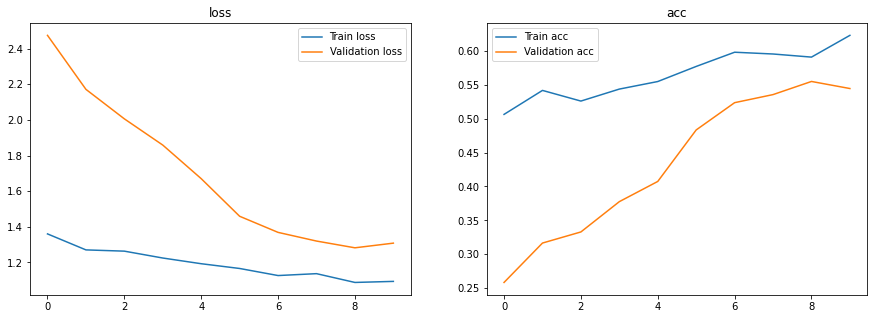

In [193]:
show_final_history(history)

#model.save_weights('./base.model')
#cnn.load_weights('./Checkpoints/checkpoint_CNN6.2')

model_score = cnn.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
cnn.save("./Weights/weight_CNN6.2.h5")
print("Weights Saved") 

**<font color="green">La val_accuracy atteint 0.516% mais il y a un fort sur-apprentissage. On va donc utiliser le Dropout.</font>**

In [194]:
# Save in .json metrics file

evaluate_save_model (cnn,
                     history,
                     execution_time, 
                     learning_rate, 
                     batch_size, 
                     momentum,
                     epochs, 
                     optimizer,
                     Kernel_initializer,
                    activation,
                    dropout_rate,
                    weight_constraint,
                    neurons)

21/21 [==============================] - 1s 30ms/step - loss: 1.2817 - accuracy: 0.5552
Evaluation results: [loss, accuracy] [1.2817100286483765, 0.5552238821983337]


## <font color="#337da4">Basic CNN5 with Dropout</font>

Model: "sequential_26"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_54 (Conv2D)           (None, 148, 148, 16)      448       
_________________________________________________________________
max_pooling2d_54 (MaxPooling (None, 74, 74, 16)        0         
_________________________________________________________________
dropout_8 (Dropout)          (None, 74, 74, 16)        0         
_________________________________________________________________
conv2d_55 (Conv2D)           (None, 72, 72, 32)        4640      
_________________________________________________________________
max_pooling2d_55 (MaxPooling (None, 36, 36, 32)        0         
_________________________________________________________________
conv2d_56 (Conv2D)           (None, 34, 34, 64)        18496     
_________________________________________________________________
max_pooling2d_56 (MaxPooling (None, 17, 17, 64)      

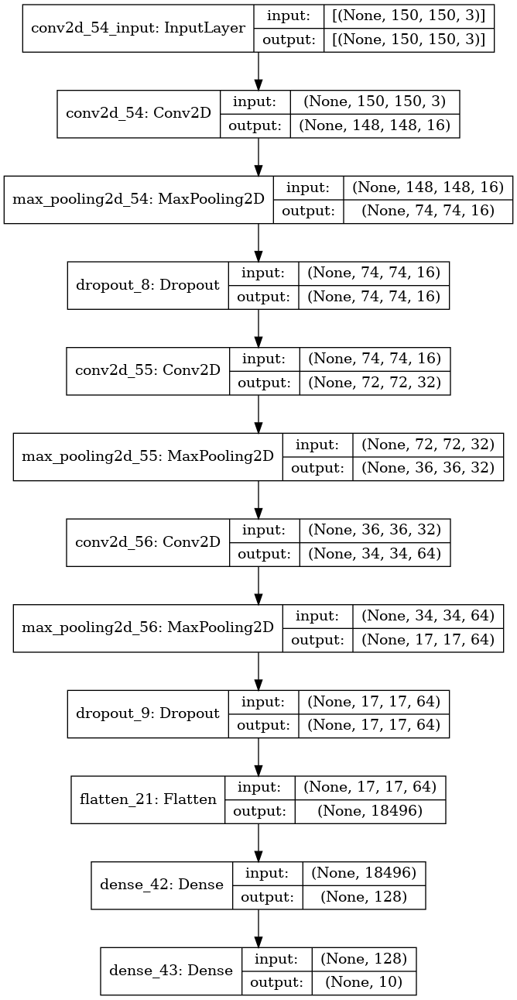

In [197]:
#Add layers * 2 
#with  dropouts

'''
The Dropout layer randomly sets input units to 0 with a frequency 
of rate at each step during training time, which helps prevent overfitting.
'''


# 5 hyper-parameters

Kernel_initializer = None
activation = "relu"
dropout_rate = .2
weight_constraint = 3
neurons =128

cnn = models.Sequential([
    
    layers.Conv2D(filters=16, kernel_size=(3, 3), activation=activation, input_shape=(150, 150, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Dropout(dropout_rate),
    
    layers.Conv2D(filters=32, kernel_size=(3, 3), activation=activation),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=64, kernel_size=(3, 3), activation=activation),
    layers.MaxPooling2D((2, 2)),
    layers.Dropout(dropout_rate),

    
    layers.Flatten(),
    layers.Dense(neurons, kernel_initializer=Kernel_initializer,
                 kernel_constraint=max_norm(weight_constraint),
                 activation=activation),
    layers.Dense(10, kernel_initializer=Kernel_initializer,
                 activation='softmax')
])


cnn.summary()

#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(cnn, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

In [200]:
#----------Compile---------------#
# 3 Hyper-parameters
learning_rate=1e-3
Momentum = None

opt1 = adam_v2.Adam(learning_rate=learning_rate)
optimizer=opt1

cnn.compile(
    loss='categorical_crossentropy',
    optimizer=optimizer,
    metrics=['accuracy']
)

#-----------Training------------#
checkpoint_callback = ModelCheckpoint('./Checkpoints/checkpoint_CNN5.2', 
                                      monitor='val_accuracy', 
                                      verbose=2, 
                                      save_best_only=True, 
                                      save_weights_only=True, 
                                      mode='max' )
batch_size=39
epochs=10


start_time= time.time()
history = cnn.fit_generator(augs_gen.flow(X_train,y_train,batch_size=batch_size),
    epochs=epochs,
    validation_data  = (X_test,y_test),
    validation_steps = len(X_test)//batch_size,
    steps_per_epoch  = len(X_train)//batch_size, 
    callbacks = checkpoint_callback)

execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time)

Epoch 1/10
40/40 [==============================] - 9s 207ms/step - loss: 1.4378 - accuracy: 0.4823 - val_loss: 1.4227 - val_accuracy: 0.4881

Epoch 00001: val_accuracy improved from -inf to 0.48806, saving model to ./Checkpoints/checkpoint_CNN5.2
Epoch 2/10
40/40 [==============================] - 8s 204ms/step - loss: 1.4319 - accuracy: 0.4783 - val_loss: 1.3940 - val_accuracy: 0.5104

Epoch 00002: val_accuracy improved from 0.48806 to 0.51045, saving model to ./Checkpoints/checkpoint_CNN5.2
Epoch 3/10
40/40 [==============================] - 8s 207ms/step - loss: 1.3841 - accuracy: 0.4843 - val_loss: 1.3781 - val_accuracy: 0.5000

Epoch 00003: val_accuracy did not improve from 0.51045
Epoch 4/10
40/40 [==============================] - 8s 204ms/step - loss: 1.3873 - accuracy: 0.5105 - val_loss: 1.3042 - val_accuracy: 0.5209

Epoch 00004: val_accuracy improved from 0.51045 to 0.52090, saving model to ./Checkpoints/checkpoint_CNN5.2
Epoch 5/10
40/40 [==============================] - 

21/21 [==============================] - 0s 19ms/step - loss: 1.3142 - accuracy: 0.5373
Model Test Loss: 1.3141809701919556
Model Test Accuracy: 0.5373134613037109
Weights Saved


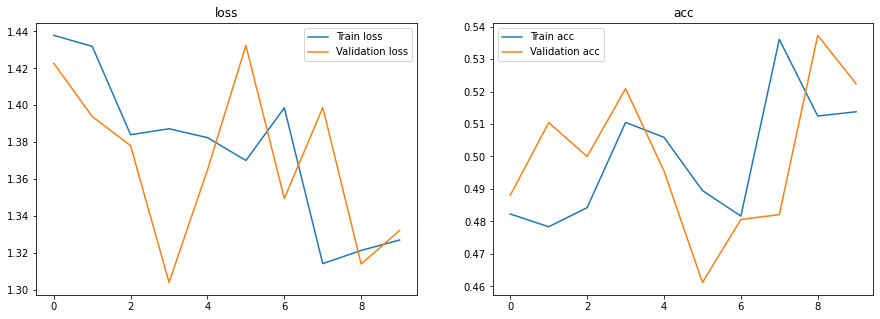

In [201]:
show_final_history(history)

#model.save_weights('./base.model')
cnn.load_weights('./Checkpoints/checkpoint_CNN5.2')

model_score = cnn.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
cnn.save("./Weights/weight_CNN5.2.h5")
print("Weights Saved") 

In [202]:
# Save in .json metrics file

evaluate_save_model (cnn,
                     history,
                     execution_time, 
                     learning_rate, 
                     batch_size, 
                     momentum,
                     epochs, 
                     optimizer,
                     Kernel_initializer,
                    activation,
                    dropout_rate,
                    weight_constraint,
                    neurons)

21/21 [==============================] - 0s 19ms/step - loss: 1.3142 - accuracy: 0.5373
Evaluation results: [loss, accuracy] [1.3141809701919556, 0.5373134613037109]


## <font color="#337da4">CNN6 with Dropout</font>

Model: "sequential_27"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_57 (Conv2D)           (None, 148, 148, 16)      448       
_________________________________________________________________
max_pooling2d_57 (MaxPooling (None, 74, 74, 16)        0         
_________________________________________________________________
dropout_10 (Dropout)         (None, 74, 74, 16)        0         
_________________________________________________________________
conv2d_58 (Conv2D)           (None, 72, 72, 32)        4640      
_________________________________________________________________
max_pooling2d_58 (MaxPooling (None, 36, 36, 32)        0         
_________________________________________________________________
conv2d_59 (Conv2D)           (None, 34, 34, 64)        18496     
_________________________________________________________________
max_pooling2d_59 (MaxPooling (None, 17, 17, 64)      

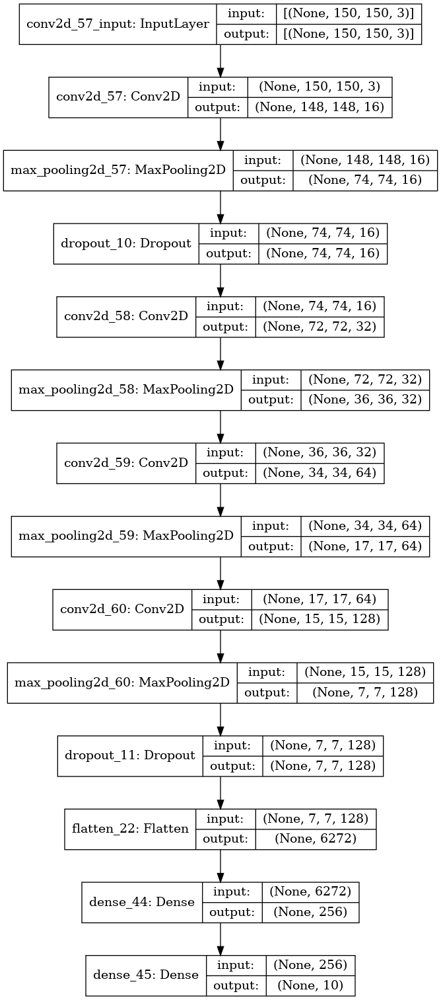

In [207]:
from tensorflow.keras import datasets, layers, models


# 5 hyper-parameters

Kernel_initializer = None
activation = "relu"
dropout_rate = .2
weight_constraint = 3
neurons =256

cnn = models.Sequential([
    
    layers.Conv2D(filters=16, kernel_size=(3, 3), activation=activation, input_shape=(150, 150, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Dropout(dropout_rate),
    
    layers.Conv2D(filters=32, kernel_size=(3, 3), activation=activation),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=64, kernel_size=(3, 3), activation=activation),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=128, kernel_size=(3, 3), activation=activation),
    layers.MaxPooling2D((2, 2)),
    layers.Dropout(dropout_rate),
    
    layers.Flatten(),
    layers.Dense(neurons, kernel_initializer=Kernel_initializer,
                 kernel_constraint=max_norm(weight_constraint),
                 activation=activation),
    layers.Dense(10, kernel_initializer=Kernel_initializer,
                 activation='softmax')
])


cnn.summary()

#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(cnn, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

In [208]:
#----------Compile---------------#
# 3 Hyper-parameters
learning_rate=1e-3
Momentum = None

opt1 = adam_v2.Adam(learning_rate=learning_rate)
optimizer=opt1

cnn.compile(
    loss='categorical_crossentropy',
    optimizer=optimizer,
    metrics=['accuracy']
)

#-----------Training------------#
checkpoint_callback = ModelCheckpoint(" ./Checkpoints/checkpoint_CNN6.3", 
                                      monitor='val_accuracy', 
                                      verbose=2, 
                                      save_best_only=True, 
                                      save_weights_only=True, 
                                      mode='max' )
batch_size=39
epochs=10

start_time= time.time()

history = cnn.fit_generator(augs_gen.flow(X_train,y_train,batch_size=batch_size),
    epochs=epochs,
    validation_data  = (X_test,y_test),
    validation_steps = len(X_test)//batch_size,
    steps_per_epoch  = len(X_train)//batch_size, 
    callbacks = checkpoint_callback)

execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time)

/home/catherinele/.local/lib/python3.9/site-packages/keras/engine/training.py:1972: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/10
40/40 [==============================] - 9s 213ms/step - loss: 2.3072 - accuracy: 0.1314 - val_loss: 2.2387 - val_accuracy: 0.1418

Epoch 00001: val_accuracy improved from -inf to 0.14179, saving model to  ./Checkpoints/checkpoint_CNN6.3
Epoch 2/10
40/40 [==============================] - 9s 211ms/step - loss: 2.1274 - accuracy: 0.1982 - val_loss: 2.0380 - val_accuracy: 0.2075

Epoch 00002: val_accuracy improved from 0.14179 to 0.20746, saving model to  ./Checkpoints/checkpoint_CNN6.3
Epoch 3/10
40/40 [==============================] - 8s 211ms/step - loss: 2.0189 - accuracy: 0.2375 - val_loss: 1.9520 - val_accuracy: 0.2284

Epoch 00003: val_accuracy improved from 0.20746 to 0.22836, saving model to  ./Checkpoints/checkpoint_CNN6.3
Epoch 4/10
40/40 [==============================] - 9s 212ms/step - loss: 1.9835 - accuracy: 0.2336 - val_loss: 1.8700 - val_accuracy: 0.3194

Epoch 00004: val_accuracy improved from 0.22836 to 0.31940, saving model to  ./Checkpoints/checkpoint_CN

21/21 [==============================] - 0s 21ms/step - loss: 1.6172 - accuracy: 0.4060
Model Test Loss: 1.6172316074371338
Model Test Accuracy: 0.40597015619277954
Weights Saved


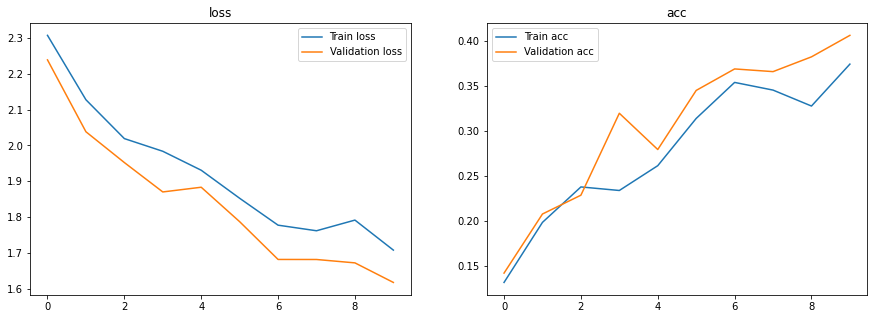

In [210]:
show_final_history(history)

#model.save_weights('./base.model')
#cnn.load_weights(" ./Checkpoints/checkpoint_CNN6.3")

model_score = cnn.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
cnn.save("./Weights/weight_CNN6.3.h5")
print("Weights Saved") 

**<font color="green"> L'overfitting est déjà moins prononcé que le second modèle.</font>**

**On va tester un plus fort taux de dropout à 0.1:**

In [211]:
# Save in .json metrics file

evaluate_save_model (cnn,
                     history,
                     execution_time, 
                     learning_rate, 
                     batch_size, 
                     momentum,
                     epochs, 
                     optimizer,
                     Kernel_initializer,
                    activation,
                    dropout_rate,
                    weight_constraint,
                    neurons)

21/21 [==============================] - 0s 21ms/step - loss: 1.6172 - accuracy: 0.4060
Evaluation results: [loss, accuracy] [1.6172316074371338, 0.40597015619277954]


### `Dropout(.1)`

Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_61 (Conv2D)           (None, 148, 148, 16)      448       
_________________________________________________________________
max_pooling2d_61 (MaxPooling (None, 74, 74, 16)        0         
_________________________________________________________________
dropout_12 (Dropout)         (None, 74, 74, 16)        0         
_________________________________________________________________
conv2d_62 (Conv2D)           (None, 72, 72, 32)        4640      
_________________________________________________________________
max_pooling2d_62 (MaxPooling (None, 36, 36, 32)        0         
_________________________________________________________________
conv2d_63 (Conv2D)           (None, 34, 34, 64)        18496     
_________________________________________________________________
max_pooling2d_63 (MaxPooling (None, 17, 17, 64)      

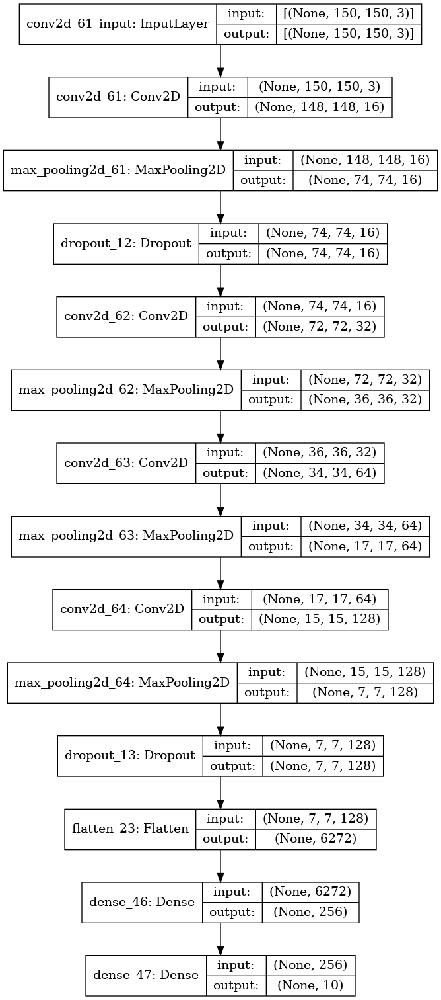

In [215]:
from tensorflow.keras import datasets, layers, models


# 5 hyper-parameters

Kernel_initializer = None
activation = "relu"
dropout_rate = .1
weight_constraint = 3
neurons =256


cnn = models.Sequential([
    
    layers.Conv2D(filters=16, kernel_size=(3, 3), activation=activation, input_shape=(150, 150, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Dropout(dropout_rate),
    
    layers.Conv2D(filters=32, kernel_size=(3, 3), activation=activation),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=64, kernel_size=(3, 3), activation=activation),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=128, kernel_size=(3, 3), activation=activation),
    layers.MaxPooling2D((2, 2)),
    layers.Dropout(dropout_rate),
    
    layers.Flatten(),
    layers.Dense(neurons,kernel_initializer=Kernel_initializer,
                 kernel_constraint=max_norm(weight_constraint),
                 activation=activation),
    layers.Dense(10, kernel_initializer=Kernel_initializer,
                 activation='softmax')
])


cnn.summary()

#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(cnn, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

In [216]:
#----------Compile---------------#
# 3 Hyper-parameters
learning_rate=1e-3
Momentum = None

opt1 = adam_v2.Adam(learning_rate=learning_rate)
optimizer=opt1

cnn.compile(
    loss='categorical_crossentropy',
    optimizer=optimizer,
    metrics=['accuracy']
)

#-----------Training------------#
checkpoint_callback = ModelCheckpoint("./Checkpoints/checkpoint_CNN6.4", 
                                      monitor='val_accuracy', 
                                      verbose=2, 
                                      save_best_only=True, 
                                      save_weights_only=True, 
                                      mode='max' )

batch_size=39
epochs=10

start_time= time.time()

history = cnn.fit_generator(augs_gen.flow(X_train,y_train,batch_size=batch_size),
    epochs=epochs,
    validation_data  = (X_test,y_test),
    validation_steps = len(X_test)//batch_size,
    steps_per_epoch  = len(X_train)//batch_size, 
    callbacks = checkpoint_callback)

execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time)

/home/catherinele/.local/lib/python3.9/site-packages/keras/engine/training.py:1972: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/10
40/40 [==============================] - 9s 210ms/step - loss: 2.3012 - accuracy: 0.1207 - val_loss: 2.1743 - val_accuracy: 0.1985

Epoch 00001: val_accuracy improved from -inf to 0.19851, saving model to  ./Checkpoints/checkpoint_CNN6.4
Epoch 2/10
40/40 [==============================] - 8s 210ms/step - loss: 2.1466 - accuracy: 0.1903 - val_loss: 2.1048 - val_accuracy: 0.2254

Epoch 00002: val_accuracy improved from 0.19851 to 0.22537, saving model to  ./Checkpoints/checkpoint_CNN6.4
Epoch 3/10
40/40 [==============================] - 9s 212ms/step - loss: 2.0001 - accuracy: 0.2533 - val_loss: 1.8993 - val_accuracy: 0.3090

Epoch 00003: val_accuracy improved from 0.22537 to 0.30896, saving model to  ./Checkpoints/checkpoint_CNN6.4
Epoch 4/10
40/40 [==============================] - 9s 220ms/step - loss: 1.9092 - accuracy: 0.2913 - val_loss: 1.7845 - val_accuracy: 0.3328

Epoch 00004: val_accuracy improved from 0.30896 to 0.33284, saving model to  ./Checkpoints/checkpoint_CN

21/21 [==============================] - 0s 22ms/step - loss: 1.5018 - accuracy: 0.4806
Model Test Loss: 1.5018283128738403
Model Test Accuracy: 0.48059701919555664
Weights Saved


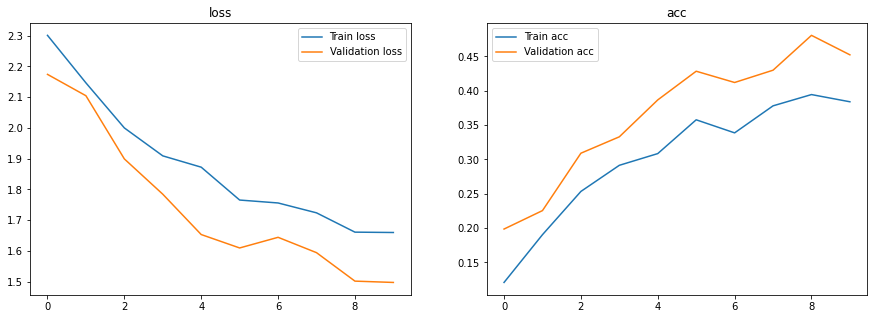

In [217]:
show_final_history(history)

#model.save_weights('./base.model')
cnn.load_weights(" ./Checkpoints/checkpoint_CNN6.4")

model_score = cnn.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
cnn.save("./Weights/weight_CNN6.4.h5")
print("Weights Saved") 

**<font color="green">Ici c'est un bon compromis, le score est correct tout en ayant la courbe orange au-dessus de la courbe bleue.</font>**


In [218]:
# Save in .json metrics file

evaluate_save_model (cnn,
                     history,
                     execution_time, 
                     learning_rate, 
                     batch_size, 
                     momentum,
                     epochs, 
                     optimizer,
                     Kernel_initializer,
                    activation,
                    dropout_rate,
                    weight_constraint,
                    neurons)

21/21 [==============================] - 0s 21ms/step - loss: 1.5018 - accuracy: 0.4806
Evaluation results: [loss, accuracy] [1.5018283128738403, 0.48059701919555664]


## <font color="#337da4">Inception-v3</font>

#### For 10 Classes

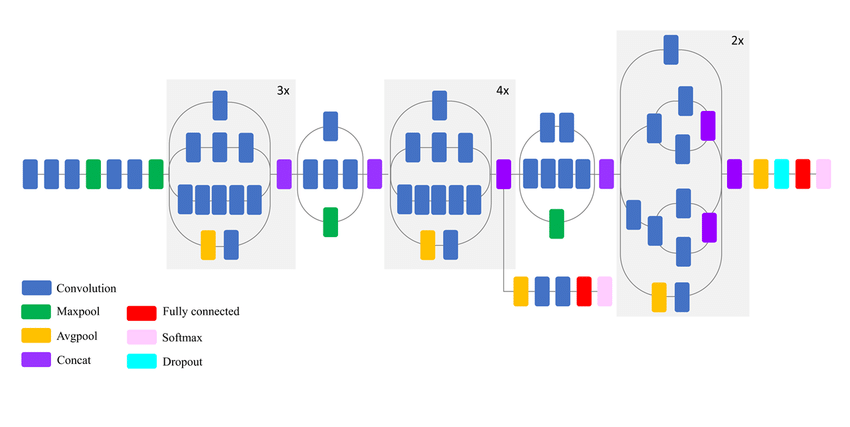

In [508]:
from keras.models import Sequential
from keras.layers import Dense,Flatten,Dropout,Concatenate,GlobalAveragePooling2D,Lambda,ZeroPadding2D
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
from keras.utils.vis_utils import plot_model
import keras.utils.vis_utils
from importlib import reload
reload(keras.utils.vis_utils)
from tensorflow.keras.constraints import max_norm

# 5 hyper-parameters

Kernel_initializer = None
activation = "softmax"
dropout_rate = .5
weight_constraint = None
neurons =10


imgsize = 150 

# Load InceptionV3 pre-trained on ImageNet and without fully-connected layers
base_model = keras.applications.inception_v3.InceptionV3(
    include_top=False,
    # precise image dimensions 
    input_shape= (imgsize,imgsize,3),
    weights="imagenet")


#features extraction 
# the layers are not re-trained 
for layer in base_model.layers:
    layer.trainable = False
    
for layer in base_model.layers:
    print(layer,layer.trainable)

# Creating an empty neural network 
model = Sequential()
model.add(base_model)
model.add(GlobalAveragePooling2D())
model.add(Dropout(dropout_rate))
# After COnv2d activation = 
model.add(Dense(neurons, activation=activation)) # ICI sans Kernel_initializer > fausse la prediction ?
model.summary()



#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

<keras.engine.input_layer.InputLayer object at 0x7f3752ab2be0> False
<keras.layers.convolutional.Conv2D object at 0x7f3805fa2e20> False
<keras.layers.normalization.batch_normalization.BatchNormalization object at 0x7f375464bdc0> False
<keras.layers.core.Activation object at 0x7f3752ec07c0> False
<keras.layers.convolutional.Conv2D object at 0x7f3816b957f0> False
<keras.layers.normalization.batch_normalization.BatchNormalization object at 0x7f3754661280> False
<keras.layers.core.Activation object at 0x7f3754661f40> False
<keras.layers.convolutional.Conv2D object at 0x7f375463dfd0> False
<keras.layers.normalization.batch_normalization.BatchNormalization object at 0x7f3827f0f6a0> False
<keras.layers.core.Activation object at 0x7f3827f1e3d0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f3827f1eee0> False
<keras.layers.convolutional.Conv2D object at 0x7f3827f0f760> False
<keras.layers.normalization.batch_normalization.BatchNormalization object at 0x7f3827f10520> False
<keras.layers.

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
inception_v3 (Functional)    (None, 3, 3, 2048)        21802784  
_________________________________________________________________
global_average_pooling2d_7 ( (None, 2048)              0         
_________________________________________________________________
dropout_7 (Dropout)          (None, 2048)              0         
_________________________________________________________________
dense_7 (Dense)              (None, 10)                20490     
Total params: 21,823,274
Trainable params: 20,490
Non-trainable params: 21,802,784
_________________________________________________________________


In [509]:
model.name

'sequential_7'

In [511]:
from keras.optimizers import adam_v2
from tensorflow.keras.optimizers import SGD
from keras.callbacks import ModelCheckpoint
import time

#----------Compile---------------#
# 3 Hyper-parameters
learning_rate=1e-4
Momentum = None
optimizer= adam_v2.Adam(learning_rate=learning_rate)

#----------Compile---------------#
model.compile(
    loss='categorical_crossentropy',
    optimizer=optimizer,
    metrics=['accuracy']
)

#-----------Training------------#
checkpoint_callback = ModelCheckpoint("./Checkpoints/checkpoint_INCEPTIONV3.2", 
                                      monitor='val_accuracy', 
                                      verbose=2, 
                                      save_best_only=True, 
                                      save_weights_only=True, 
                                      mode='max' )


batch_size=32 
epochs=20

start_time= time.time()

history = model.fit(augs_gen.flow(X_train,y_train,batch_size=batch_size),
    epochs=epochs,
    validation_data  = (X_test,y_test),
    validation_steps = len(X_test)//batch_size,
    steps_per_epoch  = len(X_train)//batch_size, 
    callbacks = checkpoint_callback)

execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time)

Epoch 1/20
48/48 [==============================] - 16s 267ms/step - loss: 4.5665 - accuracy: 0.1698 - val_loss: 1.8328 - val_accuracy: 0.4627

Epoch 00001: val_accuracy improved from -inf to 0.46269, saving model to ./Checkpoints/checkpoint_INCEPTIONV3.2
Epoch 2/20
48/48 [==============================] - 13s 262ms/step - loss: 3.0284 - accuracy: 0.3338 - val_loss: 0.8867 - val_accuracy: 0.7239

Epoch 00002: val_accuracy improved from 0.46269 to 0.72388, saving model to ./Checkpoints/checkpoint_INCEPTIONV3.2
Epoch 3/20
48/48 [==============================] - 13s 279ms/step - loss: 2.0826 - accuracy: 0.5075 - val_loss: 0.5890 - val_accuracy: 0.8284

Epoch 00003: val_accuracy improved from 0.72388 to 0.82836, saving model to ./Checkpoints/checkpoint_INCEPTIONV3.2
Epoch 4/20
48/48 [==============================] - 14s 283ms/step - loss: 1.6326 - accuracy: 0.6068 - val_loss: 0.4586 - val_accuracy: 0.8507

Epoch 00004: val_accuracy improved from 0.82836 to 0.85075, saving model to ./Chec

In [510]:
class_names

['afghan_hound',
 'bernese_mountain',
 'great_pyrenees',
 'irish_wolfhound',
 'leonberg',
 'maltese',
 'pomeranian',
 'samoyed',
 'scottish_deerhound',
 'shih_tzu']

In [11]:
def show_final_history(history):
    fig, ax = plt.subplots(1, 2, figsize=(15,5))
    ax[0].set_title('loss')
    ax[0].plot(history.epoch, history.history["loss"], label="Train loss")
    ax[0].plot(history.epoch, history.history["val_loss"], label="Validation loss")
    ax[1].set_title('acc')
    ax[1].plot(history.epoch, history.history["accuracy"], label="Train acc")
    ax[1].plot(history.epoch, history.history["val_accuracy"], label="Validation acc")
    ax[0].legend()
    ax[1].legend()

21/21 [==============================] - 3s 145ms/step - loss: 0.2839 - accuracy: 0.9194
Model Test Loss: 0.28385302424430847
Model Test Accuracy: 0.9194029569625854
Weights Saved


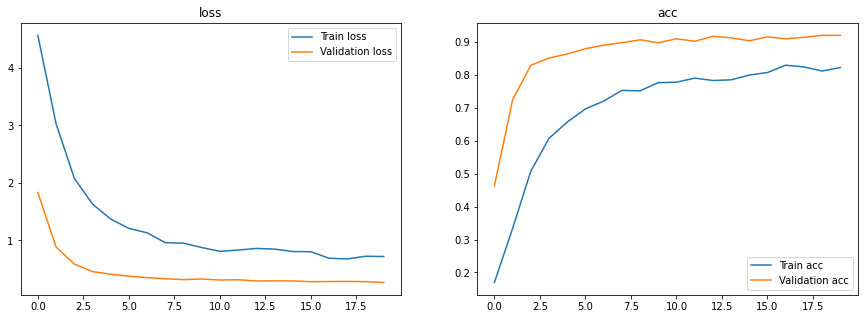

In [537]:
show_final_history(history)

#model.save_weights('./base.model')
model.load_weights("./Checkpoints/checkpoint_INCEPTIONV3.2")

model_score = model.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
model.save("./Weights/weight_INCEPTIONV3.2.h5")
print("Weights Saved")

21/21 [==============================] - 3s 152ms/step - loss: 0.2839 - accuracy: 0.9194
Model Test Loss: 0.28385302424430847
Model Test Accuracy: 0.9194029569625854
Weights Saved


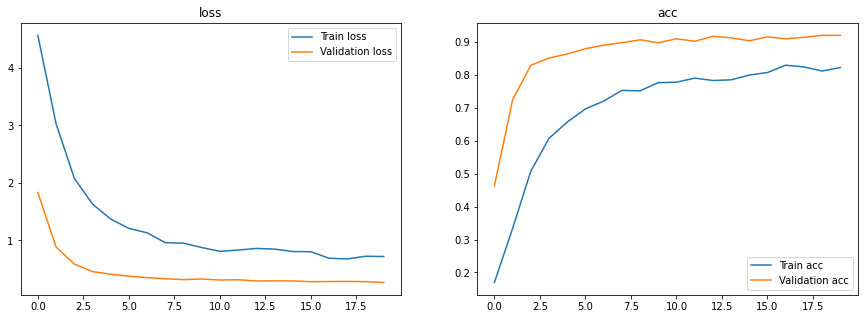

In [512]:
show_final_history(history)

#model.save_weights('./base.model')
model.load_weights("./Checkpoints/checkpoint_INCEPTIONV3.2")

model_score = model.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
model.save("./Weights/weight_INCEPTIONV3.2.h5")
print("Weights Saved")

In [533]:
model.name

'sequential_7'

In [534]:
# Save in .json metrics file
momentum = None

evaluate_save_model (model,
                     history,
                     execution_time, 
                     learning_rate, 
                     batch_size, 
                     momentum,
                     epochs, 
                     optimizer,
                     Kernel_initializer,
                    activation,
                    dropout_rate,
                    weight_constraint,
                    neurons)

21/21 [==============================] - 3s 145ms/step - loss: 0.2839 - accuracy: 0.9194
Evaluation results: [loss, accuracy] [0.28385302424430847, 0.9194029569625854]


#### For 120 Classes

In [100]:
from keras.models import Sequential
from keras.layers import Dense,Flatten,Dropout,Concatenate,GlobalAveragePooling2D,Lambda,ZeroPadding2D
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
from keras.utils.vis_utils import plot_model
import keras.utils.vis_utils
from importlib import reload
reload(keras.utils.vis_utils)
from tensorflow.keras.constraints import max_norm

# 5 hyper-parameters

Kernel_initializer = None
activation = "softmax"
dropout_rate = .5
weight_constraint = None
neurons =120


imgsize = 150 

# Load InceptionV3 pre-trained on ImageNet and without fully-connected layers
base_model = keras.applications.inception_v3.InceptionV3(
    include_top=False,
    # precise image dimensions 
    input_shape= (imgsize,imgsize,3),
    weights="imagenet")


#features extraction 
# the layers are not re-trained 
for layer in base_model.layers:
    layer.trainable = False
    
for layer in base_model.layers:
    print(layer,layer.trainable)

# Creating an empty neural network 
model = Sequential()
model.add(base_model)
model.add(GlobalAveragePooling2D())
model.add(Dropout(dropout_rate))

model.add(Dense(neurons, activation=activation)) # ICI sans Kernel_initializer > fausse la prediction ?
model.summary()



#SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True, expand_nested=True)

<keras.engine.input_layer.InputLayer object at 0x7fbbb06cfbb0> False
<keras.layers.convolutional.Conv2D object at 0x7fb903597640> False
<keras.layers.normalization.batch_normalization.BatchNormalization object at 0x7fbbb014f820> False
<keras.layers.core.Activation object at 0x7fbbb01db8b0> False
<keras.layers.convolutional.Conv2D object at 0x7fbbb06f6a30> False
<keras.layers.normalization.batch_normalization.BatchNormalization object at 0x7fbbb07028b0> False
<keras.layers.core.Activation object at 0x7fbbb07021f0> False
<keras.layers.convolutional.Conv2D object at 0x7fbbb06fbf10> False
<keras.layers.normalization.batch_normalization.BatchNormalization object at 0x7fbbb070c910> False
<keras.layers.core.Activation object at 0x7fbbb070c250> False
<keras.layers.pooling.MaxPooling2D object at 0x7fbbb070b610> False
<keras.layers.convolutional.Conv2D object at 0x7fbbb0557430> False
<keras.layers.normalization.batch_normalization.BatchNormalization object at 0x7fbbb0559bb0> False
<keras.layers.

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
inception_v3 (Functional)    (None, 3, 3, 2048)        21802784  
_________________________________________________________________
global_average_pooling2d_2 ( (None, 2048)              0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 2048)              0         
_________________________________________________________________
dense_2 (Dense)              (None, 120)               245880    
Total params: 22,048,664
Trainable params: 245,880
Non-trainable params: 21,802,784
_________________________________________________________________


In [101]:
model.name

'sequential_2'

In [102]:
from keras.optimizers import adam_v2
from tensorflow.keras.optimizers import SGD
from keras.callbacks import ModelCheckpoint
import time
import tensorflow as tf

#----------Compile---------------#
# 3 Hyper-parameters
learning_rate=1e-4
Momentum = None
optimizer= adam_v2.Adam(learning_rate=learning_rate)

#----------Compile---------------#
model.compile(
    loss='categorical_crossentropy',
    optimizer=optimizer,
    metrics=['accuracy']
)

#-----------Training------------#
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath="./Checkpoints/checkpoint_INCEPTIONV3.3",
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

# 2 Hyper-parameters
batch_size=32
epochs=15

start_time= time.time()

history = model.fit(augs_gen.flow(X_train,y_train,batch_size=batch_size),
    epochs=epochs,
    validation_data  = (X_test,y_test),
    #validation_steps = len(X_test)//batch_size,
    #steps_per_epoch  = len(X_train)//batch_size, 
    callbacks = checkpoint_callback)

execution_time = (time.time() - start_time)/60.0
print("Training execution time (mins)", execution_time) #nb the accuracy is growing faster with vgg16 preprocess_input instead of inception_v3 preprocess_inpt

Epoch 1/15
451/451 [==============================] - 128s 279ms/step - loss: 5.9379 - accuracy: 0.1253 - val_loss: 1.6241 - val_accuracy: 0.5569
Epoch 2/15
451/451 [==============================] - 126s 279ms/step - loss: 3.0176 - accuracy: 0.3898 - val_loss: 1.1838 - val_accuracy: 0.6688
Epoch 3/15
451/451 [==============================] - 126s 280ms/step - loss: 2.4625 - accuracy: 0.4815 - val_loss: 1.0976 - val_accuracy: 0.7031
Epoch 4/15
451/451 [==============================] - 127s 283ms/step - loss: 2.2305 - accuracy: 0.5297 - val_loss: 1.0761 - val_accuracy: 0.7180
Epoch 5/15
451/451 [==============================] - 125s 278ms/step - loss: 2.0571 - accuracy: 0.5538 - val_loss: 1.0527 - val_accuracy: 0.7271
Epoch 6/15
451/451 [==============================] - 125s 278ms/step - loss: 1.9547 - accuracy: 0.5836 - val_loss: 1.0557 - val_accuracy: 0.7302
Epoch 7/15
451/451 [==============================] - 125s 278ms/step - loss: 1.8763 - accuracy: 0.5959 - val_loss: 1.0565 -

In [97]:
import tensorflow as tf


# To verify keys 


checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath="./Checkpoints/checkpoint_INCEPTIONV3.3",
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

hist = model.fit_generator(augs_gen.flow(X_train,y_train,batch_size=32),
    epochs=1,
    validation_data  = (X_test,y_test),
    #validation_steps = len(X_test)//batch_size,
    #steps_per_epoch  = len(X_train)//batch_size, 
    callbacks = checkpoint_callback)

for key in hist.history:
    print(key)

451/451 [==============================] - 126s 279ms/step - loss: 3.0079 - accuracy: 0.3918 - val_loss: 1.6155 - val_accuracy: 0.5786
loss
accuracy
val_loss
val_accuracy


193/193 [==============================] - 30s 153ms/step - loss: 1.0308 - accuracy: 0.7511
Model Test Loss: 1.0308345556259155
Model Test Accuracy: 0.7510527968406677
Weights Saved


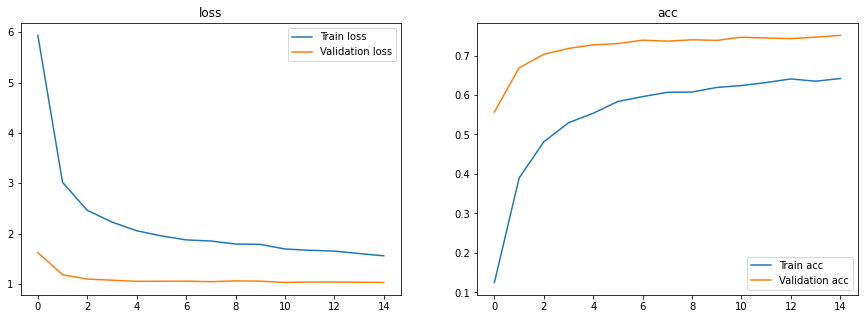

In [103]:
show_final_history(history)

#model.save_weights('./base.model')
model.load_weights("./Checkpoints/checkpoint_INCEPTIONV3.3")

model_score = model.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
model.save("./Weights/weight_INCEPTIONV3.3.h5")
print("Weights Saved")

# <font color="#1d479b">Compare all models</font>

In [546]:
#compare model metrics
view_metrics = pd.read_json("./SaveModels/model_metrics.json")
view_metrics = view_metrics.T

# Format columns
view_metrics["accuracy"] = view_metrics["accuracy"]*100
view_metrics["accuracy"] = view_metrics["accuracy"].map('{:,.2f}%'.format)

view_metrics["trainable_parameters"] = view_metrics["trainable_parameters"].map('{:,.0f}'.format)
view_metrics["execution_time"] = view_metrics["execution_time"].map('{:,.2f} mins'.format)

view_metrics["loss"] = view_metrics["loss"].map('{:,.2f}'.format)

view_metrics["model_size"] = view_metrics["model_size"]/1000000
view_metrics["model_size"] = view_metrics["model_size"].map('{:,.0f} MB'.format)

print('Number of models: ',view_metrics.shape[0])

Number of models:  22


In [547]:
view_metrics

,trainable_parameters,execution_time,loss,accuracy,model_size,learning_rate,batch_size,momentum,epochs,optimizer,kernel_initializer,activation,dropout_rate,weight_constraint,neurons
sequential_1,"14,720,331",10.21 mins,2.04,41.18%,59 MB,0.01,39,0.99,10,SGD,glorot_uniform,softmax,0.5,3,11
sequential_2,"21,823,274",4.63 mins,2.32,8.06%,88 MB,0.0001,32,None,20,Adam,None,softmax,0.5,None,10
sequential_4,"14,719,818",10.99 mins,1.40,59.85%,59 MB,0.01,39,None,10,Adam,glorot_uniform,softmax,0.5,3,10
sequential_5,"14,719,818",10.95 mins,2.21,20.00%,59 MB,0.0001,39,None,10,Adam,glorot_uniform,softmax,0.5,3,10
sequential_6,"14,719,818",10.77 mins,1.40,60.90%,59 MB,0.01,39,None,10,Adam,glorot_uniform,softmax,0.5,3,10
sequential_16,"5,328,522",1.78 mins,1.49,45.07%,80 MB,0.001,39,None,10,Adam,None,relu,None,3,64
sequential_17,"3,457,738",1.78 mins,1.43,48.96%,80 MB,0.001,39,None,10,Adam,None,relu,None,3,512
sequential_18,"2,392,874",1.78 mins,1.44,49.25%,80 MB,0.0001,39,None,10,Adam,None,relu,None,3,128
sequential_20,"20,029,514",13.63 mins,1.53,54.33%,80 MB,0.01,39,None,10,Adam,glorot_uniform,softmax,0.5,3,10
sequential_21,"5,328,522",1.77 mins,1.53,41.34%,80 MB,0.001,39,None,10,Adam,None,relu,None,3,64


In [548]:
view_metrics.to_csv("view_metrics.csv",index=True)


In [549]:
view_metrics =  pd.read_csv("view_metrics.csv", index_col =False)
print(view_metrics.shape)
view_metrics

(22, 16)


,Unnamed: 0,trainable_parameters,execution_time,loss,accuracy,model_size,learning_rate,batch_size,momentum,epochs,optimizer,kernel_initializer,activation,dropout_rate,weight_constraint,neurons
0,sequential_1,"14,720,331",10.21 mins,2.04,41.18%,59 MB,0.0100,39,0.99,10,SGD,glorot_uniform,softmax,0.5,3.0,11
1,sequential_2,"21,823,274",4.63 mins,2.32,8.06%,88 MB,0.0001,32,NaN,20,Adam,NaN,softmax,0.5,NaN,10
2,sequential_4,"14,719,818",10.99 mins,1.40,59.85%,59 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
3,sequential_5,"14,719,818",10.95 mins,2.21,20.00%,59 MB,0.0001,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
4,sequential_6,"14,719,818",10.77 mins,1.40,60.90%,59 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
5,sequential_16,"5,328,522",1.78 mins,1.49,45.07%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,NaN,3.0,64
6,sequential_17,"3,457,738",1.78 mins,1.43,48.96%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,NaN,3.0,512
7,sequential_18,"2,392,874",1.78 mins,1.44,49.25%,80 MB,0.0001,39,NaN,10,Adam,NaN,relu,NaN,3.0,128
8,sequential_20,"20,029,514",13.63 mins,1.53,54.33%,80 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
9,sequential_21,"5,328,522",1.77 mins,1.53,41.34%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,NaN,3.0,64


In [550]:
view_metrics = view_metrics.drop([1, 5,6,7, 9, 19,20])
view_metrics

,Unnamed: 0,trainable_parameters,execution_time,loss,accuracy,model_size,learning_rate,batch_size,momentum,epochs,optimizer,kernel_initializer,activation,dropout_rate,weight_constraint,neurons
0,sequential_1,"14,720,331",10.21 mins,2.04,41.18%,59 MB,0.0100,39,0.99,10,SGD,glorot_uniform,softmax,0.5,3.0,11
2,sequential_4,"14,719,818",10.99 mins,1.40,59.85%,59 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
3,sequential_5,"14,719,818",10.95 mins,2.21,20.00%,59 MB,0.0001,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
4,sequential_6,"14,719,818",10.77 mins,1.40,60.90%,59 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
8,sequential_20,"20,029,514",13.63 mins,1.53,54.33%,80 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
10,sequential_22,"3,457,738",2.31 mins,1.46,47.91%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,NaN,3.0,512
11,sequential_23,"5,328,522",1.79 mins,1.60,42.99%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,NaN,3.0,64
12,sequential_24,"2,392,874",1.44 mins,1.51,47.31%,80 MB,0.0001,39,NaN,10,Adam,NaN,relu,NaN,3.0,128
13,sequential_25,"1,706,858",1.67 mins,1.28,55.52%,80 MB,0.0001,39,NaN,10,Adam,NaN,relu,NaN,3.0,256
14,sequential_26,"2,392,490",1.39 mins,1.31,53.73%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,0.2,3.0,128


In [551]:
view_metrics = view_metrics.rename(columns={"Unnamed: 0": "models"})

In [553]:
view_metrics

,models,trainable_parameters,execution_time,loss,accuracy,model_size,learning_rate,batch_size,momentum,epochs,optimizer,kernel_initializer,activation,dropout_rate,weight_constraint,neurons
0,sequential_1,"14,720,331",10.21 mins,2.04,41.18%,59 MB,0.0100,39,0.99,10,SGD,glorot_uniform,softmax,0.5,3.0,11
2,sequential_4,"14,719,818",10.99 mins,1.40,59.85%,59 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
3,sequential_5,"14,719,818",10.95 mins,2.21,20.00%,59 MB,0.0001,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
4,sequential_6,"14,719,818",10.77 mins,1.40,60.90%,59 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
8,sequential_20,"20,029,514",13.63 mins,1.53,54.33%,80 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
10,sequential_22,"3,457,738",2.31 mins,1.46,47.91%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,NaN,3.0,512
11,sequential_23,"5,328,522",1.79 mins,1.60,42.99%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,NaN,3.0,64
12,sequential_24,"2,392,874",1.44 mins,1.51,47.31%,80 MB,0.0001,39,NaN,10,Adam,NaN,relu,NaN,3.0,128
13,sequential_25,"1,706,858",1.67 mins,1.28,55.52%,80 MB,0.0001,39,NaN,10,Adam,NaN,relu,NaN,3.0,256
14,sequential_26,"2,392,490",1.39 mins,1.31,53.73%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,0.2,3.0,128


In [554]:
view_metrics = view_metrics.replace({"sequential_1": "VGG16",
                                    "sequential_4": "VGG16",
                                    "sequential_5": "VGG16",
                                     "sequential_6": "VGG16",
                                    "sequential_20": "VGG19",
                                    "sequential_22": "CNN6",
                                    "sequential_23": "CNN4",
                                    "sequential_24": "CNN5",
                                     "sequential_25": "CNN6",
                                    "sequential_26": "CNN5",
                                    "sequential_27": "CNN6",
                                    "sequential_28": "CNN6",
                                    "sequential_29": "Inception-v3",
                                    "sequential_31": "Inception-v3",
                                    "sequential_7": "Inception-v3",})
view_metrics

,models,trainable_parameters,execution_time,loss,accuracy,model_size,learning_rate,batch_size,momentum,epochs,optimizer,kernel_initializer,activation,dropout_rate,weight_constraint,neurons
0,VGG16,"14,720,331",10.21 mins,2.04,41.18%,59 MB,0.0100,39,0.99,10,SGD,glorot_uniform,softmax,0.5,3.0,11
2,VGG16,"14,719,818",10.99 mins,1.40,59.85%,59 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
3,VGG16,"14,719,818",10.95 mins,2.21,20.00%,59 MB,0.0001,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
4,VGG16,"14,719,818",10.77 mins,1.40,60.90%,59 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
8,VGG19,"20,029,514",13.63 mins,1.53,54.33%,80 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
10,CNN6,"3,457,738",2.31 mins,1.46,47.91%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,NaN,3.0,512
11,CNN4,"5,328,522",1.79 mins,1.60,42.99%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,NaN,3.0,64
12,CNN5,"2,392,874",1.44 mins,1.51,47.31%,80 MB,0.0001,39,NaN,10,Adam,NaN,relu,NaN,3.0,128
13,CNN6,"1,706,858",1.67 mins,1.28,55.52%,80 MB,0.0001,39,NaN,10,Adam,NaN,relu,NaN,3.0,256
14,CNN5,"2,392,490",1.39 mins,1.31,53.73%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,0.2,3.0,128


In [555]:
view_metrics.to_csv("view_metrics_clean.csv",index=False)
view_metrics_clean =  pd.read_csv("view_metrics_clean.csv", index_col =False)
view_metrics_clean

,models,trainable_parameters,execution_time,loss,accuracy,model_size,learning_rate,batch_size,momentum,epochs,optimizer,kernel_initializer,activation,dropout_rate,weight_constraint,neurons
0,VGG16,"14,720,331",10.21 mins,2.04,41.18%,59 MB,0.0100,39,0.99,10,SGD,glorot_uniform,softmax,0.5,3.0,11
1,VGG16,"14,719,818",10.99 mins,1.40,59.85%,59 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
2,VGG16,"14,719,818",10.95 mins,2.21,20.00%,59 MB,0.0001,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
3,VGG16,"14,719,818",10.77 mins,1.40,60.90%,59 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
4,VGG19,"20,029,514",13.63 mins,1.53,54.33%,80 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
5,CNN6,"3,457,738",2.31 mins,1.46,47.91%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,NaN,3.0,512
6,CNN4,"5,328,522",1.79 mins,1.60,42.99%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,NaN,3.0,64
7,CNN5,"2,392,874",1.44 mins,1.51,47.31%,80 MB,0.0001,39,NaN,10,Adam,NaN,relu,NaN,3.0,128
8,CNN6,"1,706,858",1.67 mins,1.28,55.52%,80 MB,0.0001,39,NaN,10,Adam,NaN,relu,NaN,3.0,256
9,CNN5,"2,392,490",1.39 mins,1.31,53.73%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,0.2,3.0,128


In [556]:
view_metrics_clean.sort_values(by=['accuracy','execution_time'], ascending = False)

,models,trainable_parameters,execution_time,loss,accuracy,model_size,learning_rate,batch_size,momentum,epochs,optimizer,kernel_initializer,activation,dropout_rate,weight_constraint,neurons
14,Inception-v3,"21,823,274",4.56 mins,0.28,91.94%,88 MB,0.0001,32,NaN,20,Adam,NaN,softmax,0.5,NaN,10
13,Inception-v3,"21,823,274",4.55 mins,0.27,91.19%,88 MB,0.0001,39,NaN,20,Adam,NaN,softmax,0.5,NaN,10
12,Inception-v3,"21,823,274",2.35 mins,0.29,89.25%,88 MB,0.0001,39,NaN,10,Adam,NaN,softmax,0.5,NaN,10
3,VGG16,"14,719,818",10.77 mins,1.40,60.90%,59 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
1,VGG16,"14,719,818",10.99 mins,1.40,59.85%,59 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
8,CNN6,"1,706,858",1.67 mins,1.28,55.52%,80 MB,0.0001,39,NaN,10,Adam,NaN,relu,NaN,3.0,256
4,VGG19,"20,029,514",13.63 mins,1.53,54.33%,80 MB,0.0100,39,NaN,10,Adam,glorot_uniform,softmax,0.5,3.0,10
9,CNN5,"2,392,490",1.39 mins,1.31,53.73%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,0.2,3.0,128
11,CNN6,"1,705,898",1.45 mins,1.50,48.06%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,0.1,3.0,256
5,CNN6,"3,457,738",2.31 mins,1.46,47.91%,80 MB,0.0010,39,NaN,10,Adam,NaN,relu,NaN,3.0,512


**momentum:** This algorithm is used to accelerate the gradient descent algorithm by taking into consideration the 'exponentially **weighted average**' of the gradients. Using averages makes the algorithm converge towards the minima in a faster pace.


**one epoch** = one forward pass and one backward pass of all the training examples.


**batch size** = the number of training examples in one forward/backward pass. The higher the batch size, the more memory space you'll need.

**kernel_initializer:** The term kernel_initializer is a fancy term for which statistical distribution or function to use for initialising the weights.

**dropout**: A Simple Way to Prevent Neural Networks from Overfitting

**weight_constraint**: weight regularization, a weight constraint is a trigger that checks the size or magnitude of the weights and scales them so that they are all below a pre-defined threshold. (...) weight constraint regularization as an alternative to weight penalties to reduce overfitting in deep neural networks.

## <font color="#337da4">Best Model 1 </font>

### Score

21/21 [==============================] - 3s 145ms/step - loss: 0.2839 - accuracy: 0.9194
Model Test Loss: 0.28385302424430847
Model Test Accuracy: 0.9194029569625854


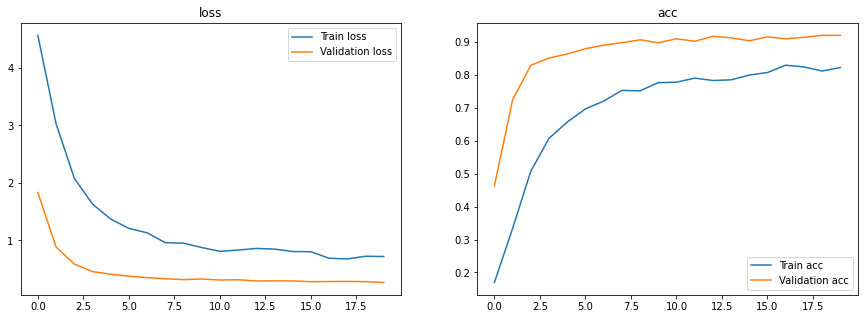

In [513]:
show_final_history(history)

#model.save_weights('./base.model')
model.load_weights("./Checkpoints/checkpoint_INCEPTIONV3.2")

model_score = model.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
model.save("./Weights/weight_INCEPTIONV3.2.h5")
print("Weights Saved")

In [544]:
model.name

'sequential_7'

### Confusion Matrix

In [135]:
y_test

array([[0., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.]], dtype=float32)

In [136]:
y_test.shape

(670, 10)

In [437]:
y_test_max.shape

(670,)

sequential_7


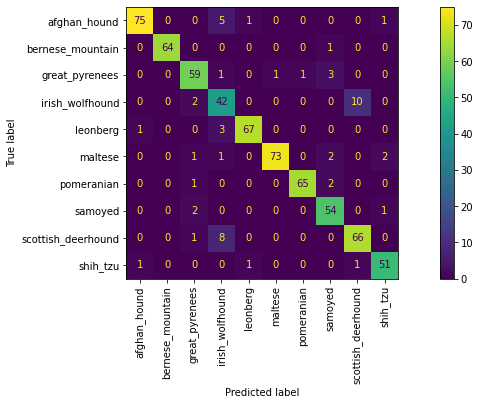

In [514]:
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
np.random.seed(0)

# Load best model with best weights
#prediction_model = tf.keras.models.load_model('./SaveModels/sequential_3.hdf5')
#checkpoint_path = './Weights_Inception/weight_INCEPTIONV3.2.h5'
#prediction_model.load_weights(checkpoint_path)

labels = ['afghan_hound', 'bernese_mountain', 'great_pyrenees' ,'irish_wolfhound',
 'leonberg' ,'maltese' ,'pomeranian', 'samoyed' ,'scottish_deerhound',
 'shih_tzu']

print(model.name)

# y_predict
y_pred = model.predict(X_test)
y_pred=np.argmax(y_pred, axis=1)
# y_true
y_test_max=np.argmax(y_test, axis=1)

cm = confusion_matrix(y_test_max, y_pred)
cmd = ConfusionMatrixDisplay(cm, display_labels=labels)


cmd.plot(xticks_rotation='vertical')

### Display Predictions

sequential_7


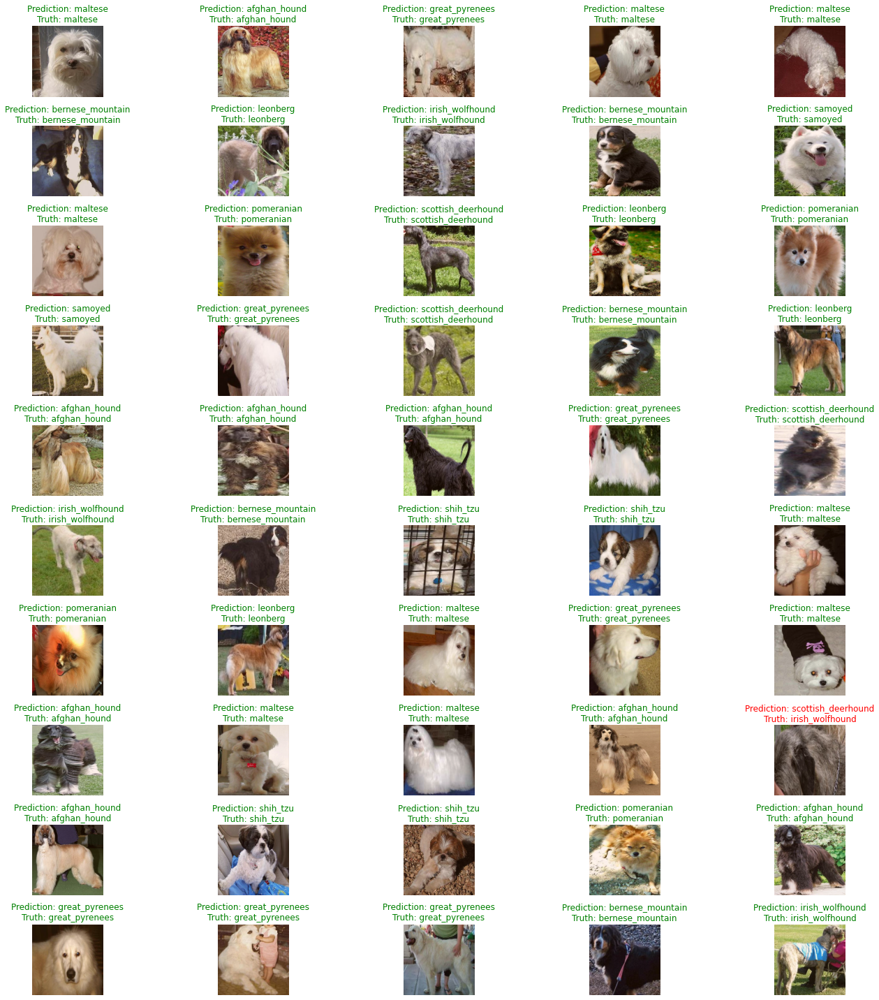

# of true predictions" 49
# of false predictions" 1


In [517]:

from matplotlib.pyplot import figure
import tensorflow as tf
from keras.preprocessing.image import load_img, img_to_array,array_to_img

fig =figure(figsize=(20,20))

# Load best model with best weights
#prediction_model = tf.keras.models.load_model('./SaveModels/sequential_3.hdf5')

#model.load_weights("./Checkpoints/checkpoint_INCEPTIONV3.2")

print(model.name)

# Make predictions

test_predictions = model.predict(X_test)

#-----------------------------------#
#array_to_img

test_x =[]
for i in range(len(X_test)) : 
    test_x.append(array_to_img(X_test[i]))
#-----------------------------------#    

#image du test
test_x_display = []
for i in range(len(test_x)):
    image = test_x[i]
    test_x_display.append(image)







true_predict = 0
false_predict = 0
    
# 50 premieres images
for i, file in enumerate(test_x_display[0:50]):
    
    axs = fig.add_subplot(10, 5, i+1)
    axs.set_aspect('equal')
    
    #-----------------------------------#
    predicted_breed = class_names[np.argmax(test_predictions[i])]
    true_breed = class_names[y_test_max[i]]
    
    #-----------------------------------#
    
    #true_breed = test_y[i][10:]

    #color
    if true_breed == predicted_breed :
        axs.set_title('Prediction: ' + predicted_breed + '\n'+ 'Truth: '+ true_breed , color = 'green')
        true_predict += 1
    else :
    
        axs.set_title('Prediction: '  + predicted_breed + '\n'+ 'Truth: '+ true_breed , color = 'red')
        false_predict += 1
    
    plt.imshow(test_x_display[i])
    plt.axis('off')
plt.tight_layout()
plt.show()

print('# of true predictions"', true_predict)
print('# of false predictions"', false_predict)

### Internet Images

In [538]:
print(model.name)

sequential_7


sequential_7
shih_tzu


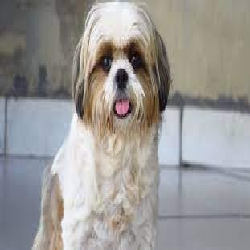

In [540]:
print(model.name)

# cropped Images

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[0], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_7
great_pyrenees


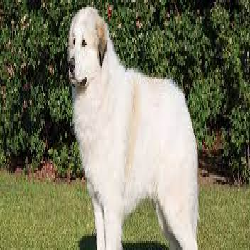

In [531]:
# Load best model with best weights
#prediction_model = tf.keras.models.load_model('./SaveModels/sequential_4.hdf5')
#prediction_model =  tf.keras.models.load_model('./Weights/weight_INCEPTIONV3.2.h5')

print(model.name)

# Non-cropped Images

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[1], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_7
afghan_hound


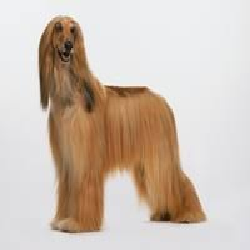

In [532]:
print(model.name)

# Non-cropped Images

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[2], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_7
samoyed


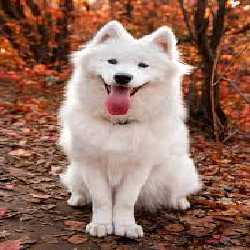

In [523]:
print(model.name)

# Non-cropped Images

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[3], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255


yhat = model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_7
maltese


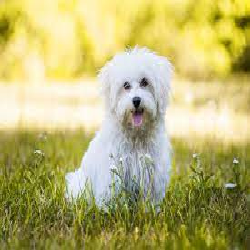

In [524]:
print(model.name)

# Non-cropped Images

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[4], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255


yhat = model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_7
leonberg


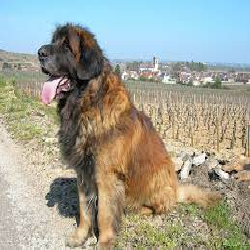

In [525]:
print(model.name)

# Non-cropped Images

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[5], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_7
pomeranian


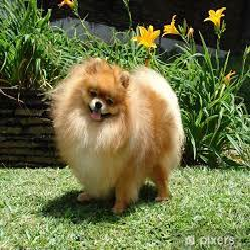

In [526]:
print(model.name)

# Non-cropped Images

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[6], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255


yhat = model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_7
scottish_deerhound


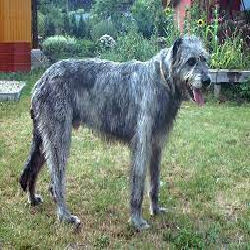

In [527]:
print(model.name)

# Non-cropped Images

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[7], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255


yhat = model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_7
bernese_mountain


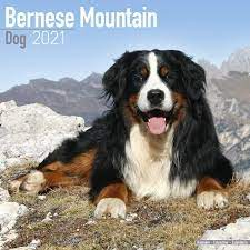

In [528]:
print(model.name)

# Non-cropped Images

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[8], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255


yhat = model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_7
scottish_deerhound


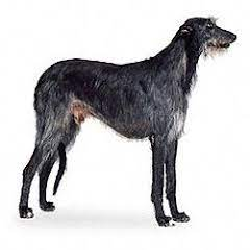

In [529]:
print(model.name)

# Non-cropped Images

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[9], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255


yhat = model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

**<font color="green">Pour Inception-v3: 9 bonnes prédictions sur des images non labelisées prises sur internet.</font>**

## <font color="#337da4">Best Model 2</font>

### Score

21/21 [==============================] - 18s 841ms/step - loss: 1.4049 - accuracy: 0.6090
Model Test Loss: 1.4049147367477417
Model Test Accuracy: 0.6089552044868469


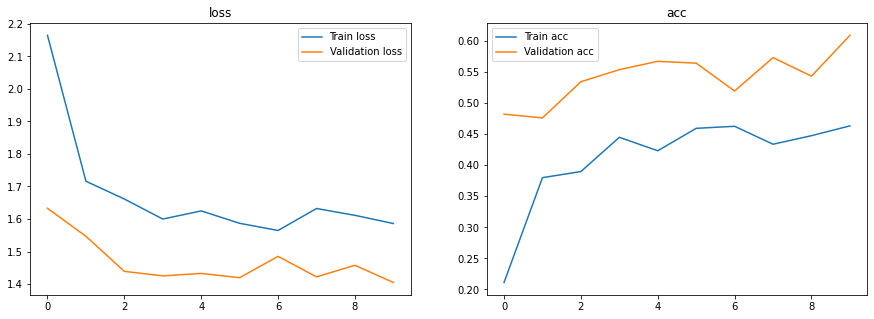

In [484]:
show_final_history(history)

#model.save_weights('./base.model')
model.load_weights('./Checkpoints_VGG/checkpoint_VGG16_ADAM.2') 

model_score = model.evaluate(X_test,y_test)
print("Model Test Loss:",model_score[0])
print("Model Test Accuracy:",model_score[1])
    
model.save("./Weights_VGG/weight_VGG16_ADAM.2.h5")
print("Weights Saved") 

### Confusion Matrix

sequential_6


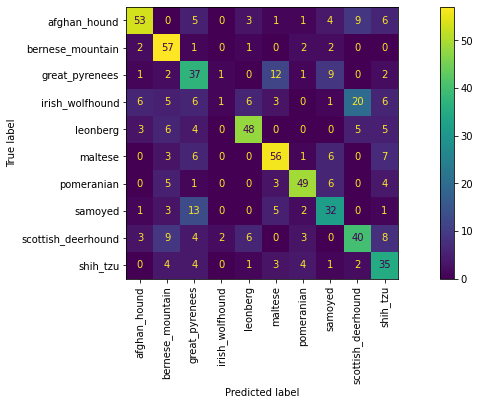

In [483]:
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
np.random.seed(0)

# Load best model with best weights
prediction_model =  tf.keras.models.load_model('./Weights_VGG/weight_VGG16_ADAM.2.h5')


labels = ['afghan_hound', 'bernese_mountain', 'great_pyrenees' ,'irish_wolfhound',
 'leonberg' ,'maltese' ,'pomeranian', 'samoyed' ,'scottish_deerhound',
 'shih_tzu']

print(prediction_model.name)

#predict
y_pred = prediction_model.predict(X_test)
y_pred=np.argmax(y_pred, axis=1)

y_test_max=np.argmax(y_test, axis=1)

cm = confusion_matrix(y_test_max, y_pred)

cmd = ConfusionMatrixDisplay(cm, display_labels=labels)


cmd.plot(xticks_rotation='vertical')

### Internet Images

sequential_6
maltese


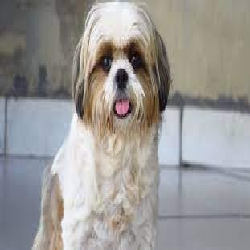

In [473]:
prediction_model =  tf.keras.models.load_model('./Weights_VGG/weight_VGG16_ADAM.2.h5')

print(prediction_model.name)

# Internet Image

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[0], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)

#remove the blue color
img_processed = preprocess_input(img_processed) 

#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = prediction_model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_6
great_pyrenees


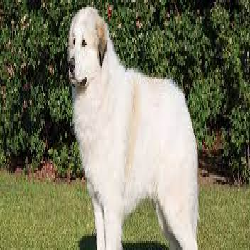

In [474]:
prediction_model =  tf.keras.models.load_model('./Weights_VGG/weight_VGG16_ADAM.2.h5')

print(prediction_model.name)

# Internet Image

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[1], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)

#remove the blue color
img_processed = preprocess_input(img_processed) 

#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = prediction_model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_6
afghan_hound


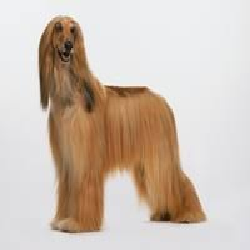

In [475]:
prediction_model =  tf.keras.models.load_model('./Weights_VGG/weight_VGG16_ADAM.2.h5')

print(prediction_model.name)

# Internet Image

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[2], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = prediction_model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_6
pomeranian


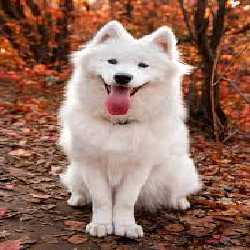

In [476]:
prediction_model =  tf.keras.models.load_model('./Weights_VGG/weight_VGG16_ADAM.2.h5')

print(prediction_model.name)

# Internet Image

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[3], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = prediction_model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_6
maltese


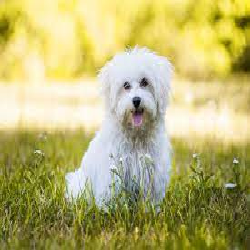

In [477]:
prediction_model =  tf.keras.models.load_model('./Weights_VGG/weight_VGG16_ADAM.2.h5')

print(prediction_model.name)

# Internet Image

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[4], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = prediction_model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_6
scottish_deerhound


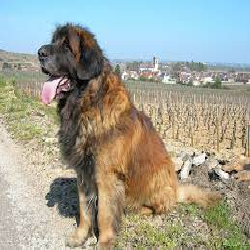

In [478]:
prediction_model =  tf.keras.models.load_model('./Weights_VGG/weight_VGG16_ADAM.2.h5')

print(prediction_model.name)

# Internet Image

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[5], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = prediction_model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_6
leonberg


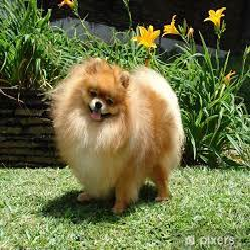

In [479]:
prediction_model =  tf.keras.models.load_model('./Weights_VGG/weight_VGG16_ADAM.2.h5')

print(prediction_model.name)

# Internet Image

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[6], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = prediction_model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_6
scottish_deerhound


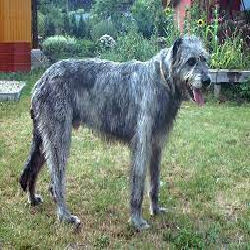

In [480]:
prediction_model =  tf.keras.models.load_model('./Weights_VGG/weight_VGG16_ADAM.2.h5')

print(prediction_model.name)

# Internet Image

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[7], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = prediction_model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_6
bernese_mountain


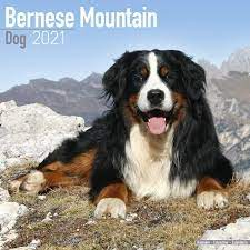

In [481]:
prediction_model =  tf.keras.models.load_model('./Weights_VGG/weight_VGG16_ADAM.2.h5')

print(prediction_model.name)

# Internet Image

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[8], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = prediction_model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

sequential_6
scottish_deerhound


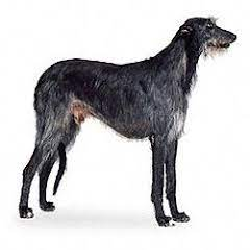

In [482]:
prediction_model =  tf.keras.models.load_model('./Weights_VGG/weight_VGG16_ADAM.2.h5')

print(prediction_model.name)

# Internet Image

path = "./Image_test/"
list_photos = [file for file in listdir(path)]
image = load_img(path+list_photos[9], target_size=(250, 250))

#resize
resize=image.resize((150, 150))
img_processed = img_to_array(resize) #(150, 150, 3)
img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
#remove the blue color
img_processed = preprocess_input(img_processed) 
#Equalization in size 250 for more light
img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
# Normalization
img_processed= img_processed/255

yhat = prediction_model.predict(img_processed)
label = class_names[np.argmax(yhat)]
print(label)
image

**<font color="green">Pour le VGG16: 5 bonnes prédictions sur 10 pour les images non labellisées trouvées sur internet.</font>**

## <font color="#337da4">Inception_v3 on 120 Classes</font>

### Confusion Matrix

In [110]:
labels = label_encoder.classes_.tolist()
labels

['Afghan_hound',
 'African_hunting_dog',
 'Airedale',
 'American_Staffordshire_terrier',
 'Appenzeller',
 'Australian_terrier',
 'Bedlington_terrier',
 'Bernese_mountain_dog',
 'Blenheim_spaniel',
 'Border_collie',
 'Border_terrier',
 'Boston_bull',
 'Bouvier_des_Flandres',
 'Brabancon_griffon',
 'Brittany_spaniel',
 'Cardigan',
 'Chesapeake_Bay_retriever',
 'Chihuahua',
 'Dandie_Dinmont',
 'Doberman',
 'English_foxhound',
 'English_setter',
 'English_springer',
 'EntleBucher',
 'Eskimo_dog',
 'French_bulldog',
 'German_shepherd',
 'Gordon_setter',
 'Great_Dane',
 'Great_Pyrenees',
 'Greater_Swiss_Mountain_dog',
 'Ibizan_hound',
 'Irish_setter',
 'Irish_terrier',
 'Irish_water_spaniel',
 'Irish_wolfhound',
 'Italian_greyhound',
 'Japanese_spaniel',
 'Kerry_blue_terrier',
 'Labrador_retriever',
 'Lakeland_terrier',
 'Leonberg',
 'Lhasa',
 'Maltese_dog',
 'Mexican_hairless',
 'Newfoundland',
 'Norfolk_terrier',
 'Norwegian_elkhound',
 'Norwich_terrier',
 'Old_English_sheepdog',
 'Pekines

sequential_2


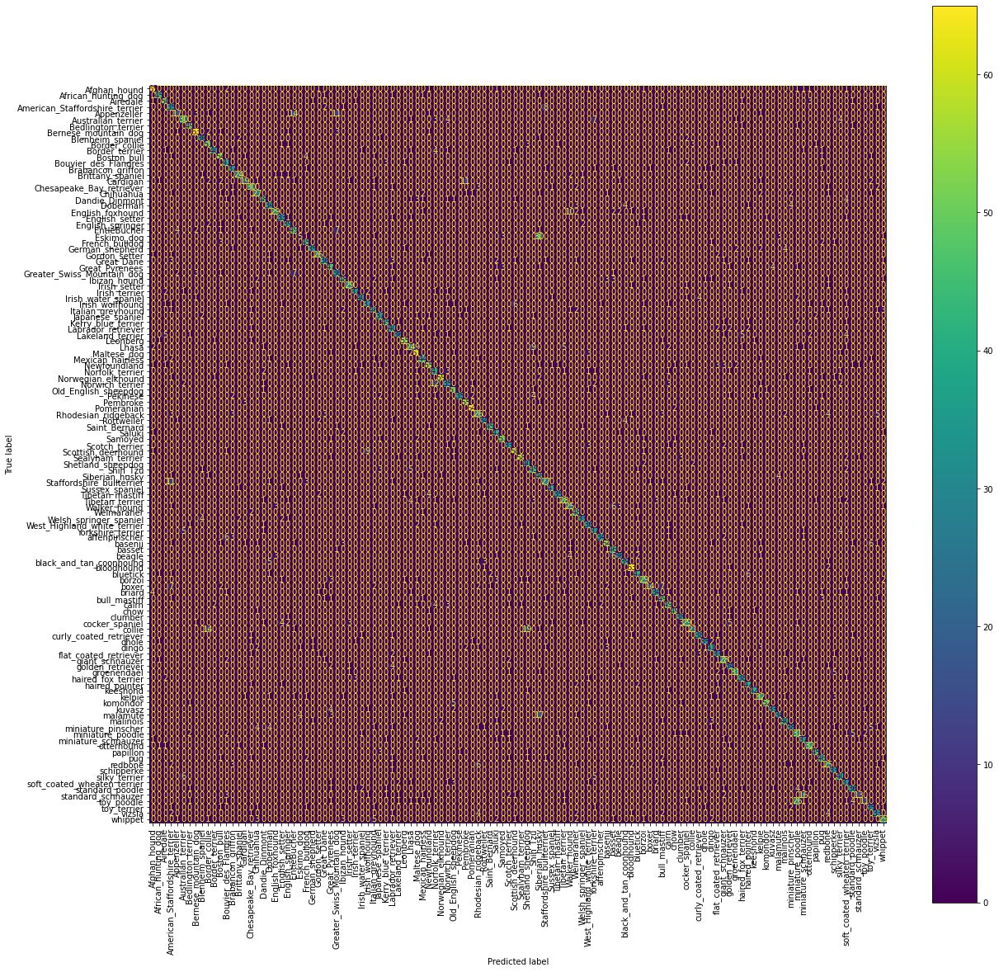

In [114]:
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
np.random.seed(0)

# Load best model with best weights
#prediction_model = tf.keras.models.load_model('./SaveModels/sequential_3.hdf5')
#checkpoint_path = './Weights_Inception/weight_INCEPTIONV3.2.h5'
#prediction_model.load_weights(checkpoint_path)



print(model.name)

# y_predict
y_pred = model.predict(X_test)
y_pred=np.argmax(y_pred, axis=1)
# y_true
y_test_max=np.argmax(y_test, axis=1)

cm = confusion_matrix(y_test_max, y_pred)
cmd = ConfusionMatrixDisplay(cm, display_labels=labels)

fig, ax = plt.subplots(figsize=(20,20))
cmd.plot(ax=ax,xticks_rotation='vertical')


### Display Predictions

sequential_2


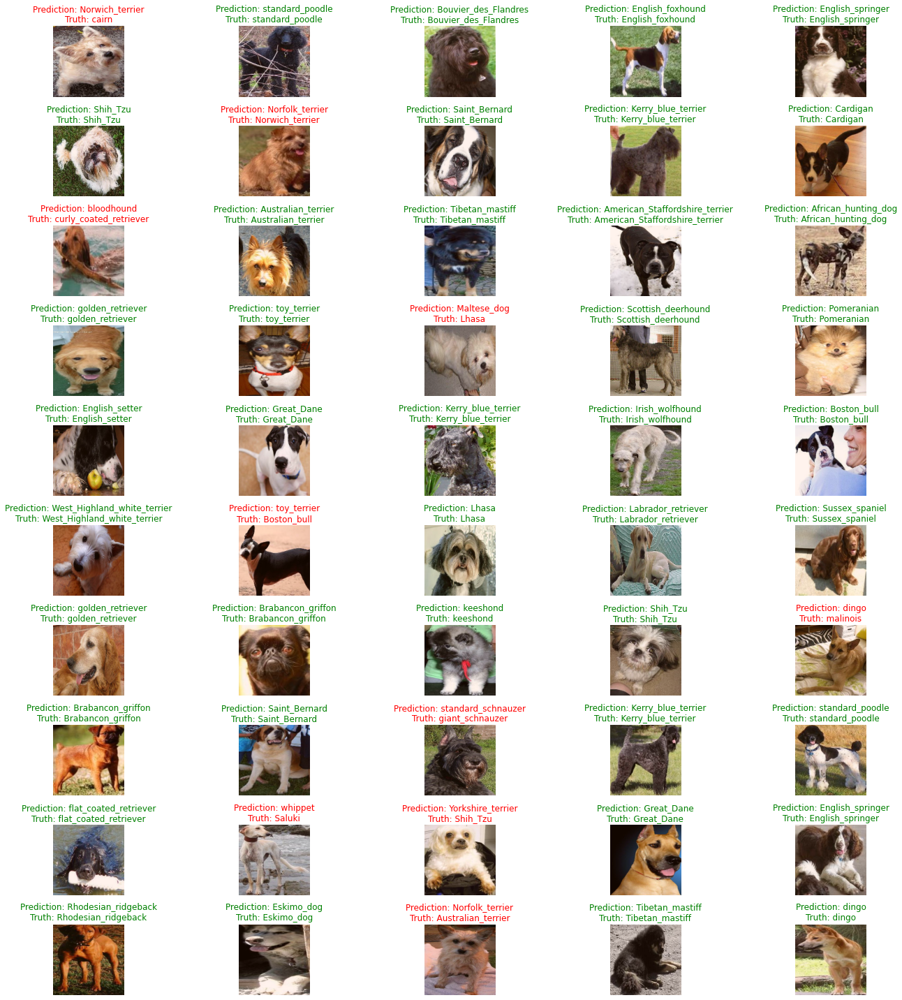

# of true predictions" 40
# of false predictions" 10


In [115]:

from matplotlib.pyplot import figure
import tensorflow as tf
from keras.preprocessing.image import load_img, img_to_array,array_to_img

fig =figure(figsize=(20,20))




# Load best model with best weights
#prediction_model = tf.keras.models.load_model('./SaveModels/sequential_3.hdf5')

#model.load_weights("./Checkpoints/checkpoint_INCEPTIONV3.2")

print(model.name)

# Make predictions

test_predictions = model.predict(X_test)

#-----------------------------------#
#array_to_img

test_x =[]
for i in range(len(X_test)) : 
    test_x.append(array_to_img(X_test[i]))
#-----------------------------------#    

# images list
test_x_display = []
for i in range(len(test_x)):
    image = test_x[i]
    test_x_display.append(image)



y_test_max = np.argmax(y_test, axis=1)



true_predict = 0
false_predict = 0
    
# 50 premieres images
for i, file in enumerate(test_x_display[0:50]):
    
    axs = fig.add_subplot(10, 5, i+1)
    axs.set_aspect('equal')
    
    #-----------------------------------#
    predicted_breed = labels[np.argmax(test_predictions[i])]
    true_breed = labels[y_test_max[i]]
    
    #-----------------------------------#
    
    #true_breed = test_y[i][10:]

    #color
    if true_breed == predicted_breed :
        axs.set_title('Prediction: ' + predicted_breed + '\n'+ 'Truth: '+ true_breed , color = 'green')
        true_predict += 1
    else :
    
        axs.set_title('Prediction: '  + predicted_breed + '\n'+ 'Truth: '+ true_breed , color = 'red')
        false_predict += 1
    
    plt.imshow(test_x_display[i])
    plt.axis('off')
plt.tight_layout()
plt.show()

print('# of true predictions"', true_predict)
print('# of false predictions"', false_predict)

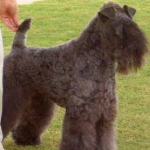

In [118]:
test_x_display[8]

### Internet Images

In [125]:
path = "./Image_test/"
list_photos = [file for file in listdir(path)]
list_photos[0].split(".")[0]

'Afghan_hound'

sequential_2
Afghan_hound
keeshond
Leonberg
English_springer
Samoyed
miniature_poodle
Irish_wolfhound
Shih_Tzu
Scottish_deerhound
Great_Pyrenees


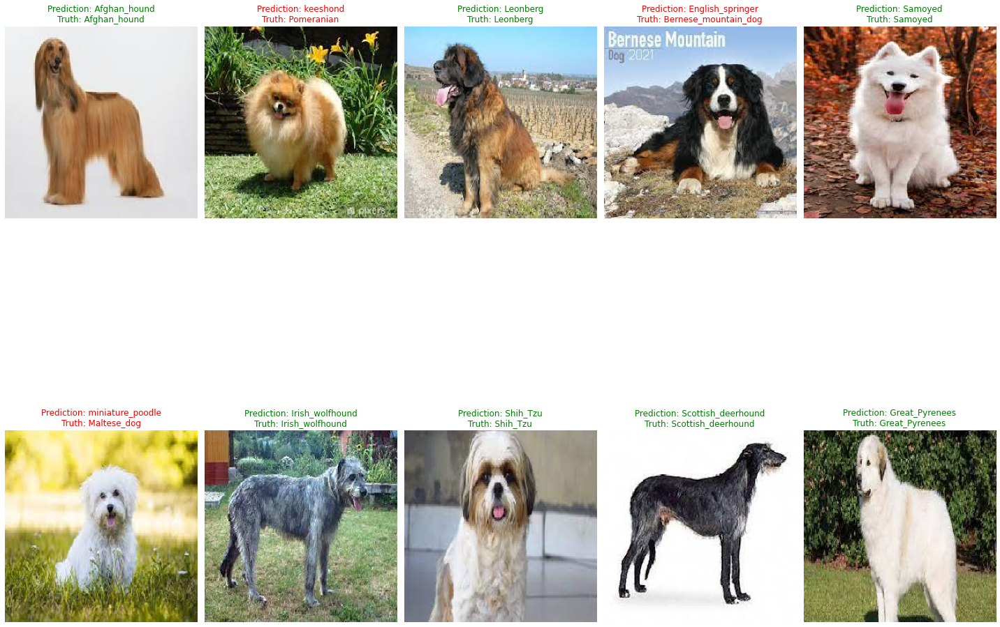

In [126]:
from os import listdir

fig =figure(figsize=(20,20))

prediction_model =  tf.keras.models.load_model('./Weights/weight_INCEPTIONV3.3.h5')

print(prediction_model.name)
path = "./Image_test/"
list_photos = [file for file in listdir(path)]




for i, file in enumerate(list_photos[0:10]):
    
    axs = fig.add_subplot(2, 5, i+1)
    axs.set_aspect('equal')

    #---------------------------------------------------------------------#
    image = load_img(path+list_photos[i], target_size=(250, 250))
    
    #resize
    resize=image.resize((150, 150))
    img_processed = img_to_array(resize) #(150, 150, 3)
    img_processed = img_processed.reshape((1, img_processed.shape[0], img_processed.shape[1], img_processed.shape[2])) #(1, 150, 150, 3)
    
    #remove the blue color
    img_processed = preprocess_input(img_processed) 
    #Equalization in size 250 for more light
    img_processed = np.uint8(cv2.normalize(img_processed, None, 0, 250, cv2.NORM_MINMAX))
    # Normalization
    img_processed= img_processed/255
    
    yhat = prediction_model.predict(img_processed)
    
    predicted_breed = labels[np.argmax(yhat)]
    print(predicted_breed)
    true_breed = list_photos[i].split(".")[0]
    #---------------------------------------------------------------------#
    #color
    if true_breed == predicted_breed :
        axs.set_title('Prediction: ' + predicted_breed + '\n'+ 'Truth: '+ true_breed , color = 'green')
        true_predict += 1
    else :
    
        axs.set_title('Prediction: '  + predicted_breed + '\n'+ 'Truth: '+ true_breed , color = 'red')
        false_predict += 1
    
    plt.imshow(image)
    plt.axis('off')
plt.tight_layout()
plt.show()

# <font color="#1d479b">Annexe</font>

In [169]:
# All test images in dataset
test = sio.loadmat('test_list.mat')

file_list = test["file_list"]
file_list = pd.Series(file_list[:,0],name ='files')
annotation_list = test["annotation_list"]
annotation_list = pd.Series(annotation_list[:,0],name ='annotations')
labels = test["labels"]
labels = pd.Series(labels[:,0],name ='labels')

#--------------dataframe-----------------------------------#
df_test = pd.concat([file_list,labels], axis=1)
#Column of lists> convert list to string as a new column
df_test['liststring'] = [','.join(map(str, l)) for l in df_test['files']]
#regex : exctract caracters before /
df_test['annotation'] = df_test["liststring"].str.extract("([^/]*)")
#regex : exctract caracters after /
df_test['files_names'] = df_test["liststring"].str.extract("/([^\s]+)")
df_test = df_test.drop(['files', 'liststring'], axis=1)
print(df_test.shape)
df_test.head()

(8580, 3)


,labels,annotation,files_names
0,1,n02085620-Chihuahua,n02085620_2650.jpg
1,1,n02085620-Chihuahua,n02085620_4919.jpg
2,1,n02085620-Chihuahua,n02085620_1765.jpg
3,1,n02085620-Chihuahua,n02085620_3006.jpg
4,1,n02085620-Chihuahua,n02085620_1492.jpg


In [170]:
#Idem for  All training images in dataset
train = sio.loadmat('train_list.mat') 


file_list = train["file_list"]
file_list = pd.Series(file_list[:,0],name ='files')
annotation_list = train["annotation_list"]
annotation_list = pd.Series(annotation_list[:,0],name ='annotations')
labels = train["labels"]
labels = pd.Series(labels[:,0],name ='labels')

#--------------dataframe-----------------------------------#
df_traint = pd.concat([file_list,labels], axis=1)
#Column of lists> convert list to string as a new column
df_traint['liststring'] = [','.join(map(str, l)) for l in df_traint['files']]
#regex : exctract caracters before /
df_traint['annotation'] = df_traint["liststring"].str.extract("([^/]*)")
#regex : exctract caracters after /
df_traint['files_names'] = df_traint["liststring"].str.extract("/([^\s]+)")
df_traint = df_traint.drop(['files', 'liststring'], axis=1)
print(df_traint.shape)
df_traint.head()

(12000, 3)


,labels,annotation,files_names
0,1,n02085620-Chihuahua,n02085620_5927.jpg
1,1,n02085620-Chihuahua,n02085620_4441.jpg
2,1,n02085620-Chihuahua,n02085620_1502.jpg
3,1,n02085620-Chihuahua,n02085620_1916.jpg
4,1,n02085620-Chihuahua,n02085620_13151.jpg


# <font color="#1d479b">Sources</font>


    
Pre-trained VGG16 :

https://www.youtube.com/watch?v=hBXSbeIvmbg&t=68s    
https://www.kaggle.com/twhitehurst3/stanford-dogs-keras-vgg16

Models comparison : 

https://www.youtube.com/watch?v=QdDtgUqewhY&t=517s

Results and Display Functions :

https://www.youtube.com/watch?v=fxEv6RjpeIw&t=353s

https://www.youtube.com/watch?v=Ku6wkRQIYuc&t=619s

Equalization:

https://askcodez.com/erreur-a-laide-de-cv2-equalizehist.html

Get Class from predict method in Keras:

https://androidkt.com/get-class-labels-from-predict-method-in-keras/

https://datascience.stackexchange.com/questions/45400/how-to-find-what-values-are-assigned-to-labels-that-where-encoded-using-labelenc

To crop images with PACAL Voc: 

https://stackoverflow.com/questions/61480425/automatic-image-cropping-from-bounding-boxes-annotation-python

Batch normalization:

https://machinelearningmastery.com/how-to-accelerate-learning-of-deep-neural-networks-with-batch-normalization/

Initializers for the Dense layer: 

https://stackoverflow.com/questions/43284047/what-is-the-default-kernel-initializer-in-tf-layers-conv2d-and-tf-layers-dense

GridSearcCV for DeepLearning:

https://machinelearningmastery.com/grid-search-hyperparameters-deep-learning-models-python-keras/

Weight Constraints on Layers:

https://machinelearningmastery.com/how-to-reduce-overfitting-in-deep-neural-networks-with-weight-constraints-in-keras/